In [1]:
from STIS_pipeline_functions import *
sns.set_context("talk")

/Users/natalieallen/opt/anaconda3/lib/python3.8/site-packages/autograd/numpy/numpy_wrapper.py:20: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  int_types = {_np.int, _np.int8, _np.int16, _np.int32, _np.int64, _np.integer}


In [2]:
# read in data and calibration files - the test directory I have has 
# two different instruments so I just quickly sort those
data_files_430 = sorted(glob.glob("wasp-69/HST/G430L/*/*flt.fits"))
data_files_750 = sorted(glob.glob("wasp-69/HST/G750L/*/*flt.fits"))

In [3]:
# get the data from the files - since I use default settings, it reads out: data, header, jitter, dqs, errors
# currently I remove the last few files from the 750 data because they're flat frames rather than science data
# didn't realize this was a possibility to be included - will update the function to exclude anything that isn't 
# "science" in the get_data function later
data_430 = get_data(data_files_430)
data_750 = get_data(data_files_750)

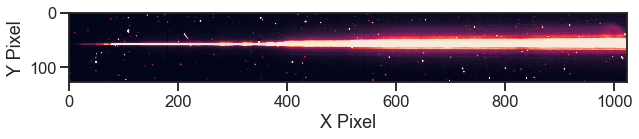

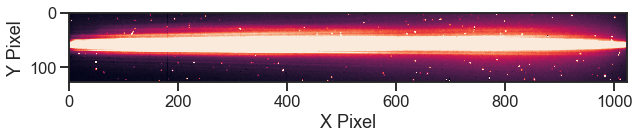

In [4]:
# check on one of the data frames (first part of data) - 430 first and then 750
plt.figure(figsize = (10,10))
im = plt.imshow(data_430[0][0])
im.set_clim(0,150)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,10))
im = plt.imshow(data_750[0][0])
im.set_clim(0,150)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

In [5]:
# initialize a list for and then create traces for each of the data frames
trace_list_430 = []
for i in data_430[0]:
    # trace wants xi, xf, and an initial y guess - these are numbers I just chose from some testing
    # it can be seen above this just corresponds to the strongest flux
    # this function is fast so you can test for yourself if these values don't work!
    trace = trace_spectrum(i, 100,1000,60)
    trace_list_430.append(trace)

trace_list_750 = []
for i in data_750[0]:
    # trace wants xi, xf, and an initial y guess - these are numbers I just chose from some testing
    # it can be seen above this just corresponds to the strongest flux
    # this function is fast so you can test for yourself if these values don't work!
    trace = trace_spectrum(i, 100,1000,60)
    trace_list_750.append(trace)

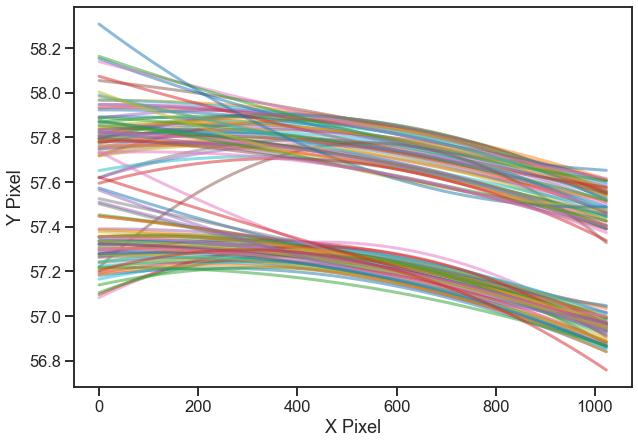

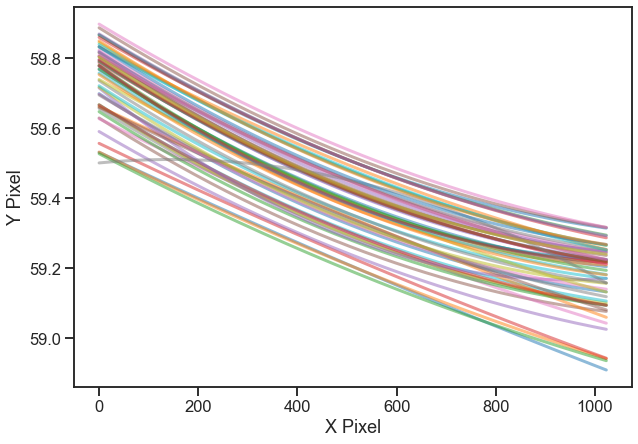

In [6]:
# fit a polynomial to the traces - I just use a second-order chebyshev
# and i fit it over the whole length of the data frame instead of just what was use for the fit
trace_fit_430 = []
plt.figure(figsize = (10,7))
for j in trace_list_430:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    # plotting just to check everything looks okay
    plt.plot(np.arange(len(data_430[0][0][0])),chebyshev.chebval(np.arange(len(data_430[0][0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(data_430[0][0][0])),chebyshev.chebval(np.arange(len(data_430[0][0][0])),coeffs1)]
    trace_fit_430.append(trace)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

# fit a polynomial to the traces - I just use a second-order chebyshev
# and i fit it over the whole length of the data frame instead of just what was use for the fit
trace_fit_750 = []
plt.figure(figsize = (10,7))
for j in trace_list_750:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    # plotting just to check everything looks okay
    plt.plot(np.arange(len(data_750[0][0][0])),chebyshev.chebval(np.arange(len(data_750[0][0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(data_750[0][0][0])),chebyshev.chebval(np.arange(len(data_750[0][0][0])),coeffs1)]
    trace_fit_750.append(trace)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

# there's maybe some outliers here, but this is just an initial trace to feed into the cleaning function
# so we don't worry about it - should subside once the cosmic rays are cleaned

In [7]:
data_430[5]

[0, 12, 0, 15, 0, 15, 0, 15, 0, 12, 0, 15, 0, 15, 0, 15]

In [8]:
# now to clean the data - default is all steps on (dq, difference_correct, hc_correct, spline_correct)
# i'm breaking up the orbits manually here, not sure what the best way to do this automatically is yet
cleaned_1_430 = clean_data(data_430[0][:4], dqs = data_430[3][:4], traces = trace_fit_430[:4])
cleaned_2_430= clean_data(data_430[0][4:8], dqs = data_430[3][4:8], traces = trace_fit_430[3:7])
cleaned_3_430 = clean_data(data_430[0][8:12], dqs = data_430[3][8:12], traces = trace_fit_430[8:12])

cleaned_4_430 = clean_data(data_430[0][12:16], dqs = data_430[3][12:16], traces = trace_fit_430[12:16])
cleaned_5_430 = clean_data(data_430[0][16:20], dqs = data_430[3][16:20], traces = trace_fit_430[16:20])
cleaned_6_430 = clean_data(data_430[0][20:24], dqs = data_430[3][20:24], traces = trace_fit_430[20:24])
cleaned_7_430 = clean_data(data_430[0][24:27], dqs = data_430[3][24:27], traces = trace_fit_430[24:27])

cleaned_8_430 = clean_data(data_430[0][27:31], dqs = data_430[3][27:31], traces = trace_fit_430[27:31])
cleaned_9_430 = clean_data(data_430[0][31:35], dqs = data_430[3][31:35], traces = trace_fit_430[31:35])
cleaned_10_430 = clean_data(data_430[0][35:39], dqs = data_430[3][35:39], traces = trace_fit_430[35:39])
cleaned_11_430 = clean_data(data_430[0][39:42], dqs = data_430[3][39:42], traces = trace_fit_430[39:42])

cleaned_12_430 = clean_data(data_430[0][42:46], dqs = data_430[3][42:46], traces = trace_fit_430[42:46])
cleaned_13_430 = clean_data(data_430[0][46:50], dqs = data_430[3][46:50], traces = trace_fit_430[46:50])
cleaned_14_430 = clean_data(data_430[0][50:54], dqs = data_430[3][50:54], traces = trace_fit_430[50:54])
cleaned_15_430 = clean_data(data_430[0][54:57], dqs = data_430[3][54:57], traces = trace_fit_430[54:57])

Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting differenc

In [9]:
cleaned_21_430 = clean_data(data_430[0][57:61], dqs = data_430[3][57:61], traces = trace_fit_430[57:61])
cleaned_22_430= clean_data(data_430[0][61:65], dqs = data_430[3][61:65], traces = trace_fit_430[61:65])
cleaned_23_430 = clean_data(data_430[0][65:69], dqs = data_430[3][65:69], traces = trace_fit_430[65:69])

cleaned_24_430 = clean_data(data_430[0][69:73], dqs = data_430[3][69:73], traces = trace_fit_430[69:73])
cleaned_25_430 = clean_data(data_430[0][73:77], dqs = data_430[3][73:77], traces = trace_fit_430[73:77])
cleaned_26_430 = clean_data(data_430[0][77:81], dqs = data_430[3][77:81], traces = trace_fit_430[77:81])
cleaned_27_430 = clean_data(data_430[0][81:84], dqs = data_430[3][81:84], traces = trace_fit_430[81:84])

cleaned_28_430 = clean_data(data_430[0][84:88], dqs = data_430[3][84:88], traces = trace_fit_430[84:88])
cleaned_29_430 = clean_data(data_430[0][88:92], dqs = data_430[3][88:92], traces = trace_fit_430[88:92])
cleaned_210_430 = clean_data(data_430[0][92:96], dqs = data_430[3][92:96], traces = trace_fit_430[92:96])
cleaned_211_430 = clean_data(data_430[0][96:99], dqs = data_430[3][96:99], traces = trace_fit_430[96:99])

cleaned_212_430 = clean_data(data_430[0][99:103], dqs = data_430[3][99:103], traces = trace_fit_430[99:103])
cleaned_213_430 = clean_data(data_430[0][103:107], dqs = data_430[3][103:107], traces = trace_fit_430[103:107])
cleaned_214_430 = clean_data(data_430[0][107:111], dqs = data_430[3][107:111], traces = trace_fit_430[107:111])
cleaned_215_430 = clean_data(data_430[0][111:114], dqs = data_430[3][111:114], traces = trace_fit_430[111:114])


Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting differenc

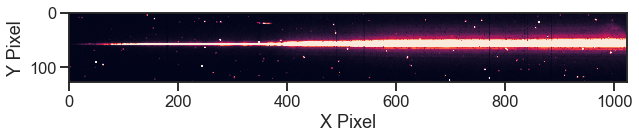

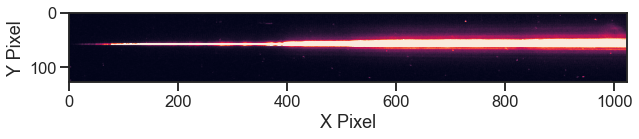

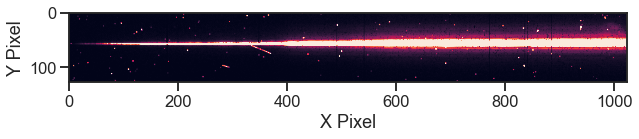

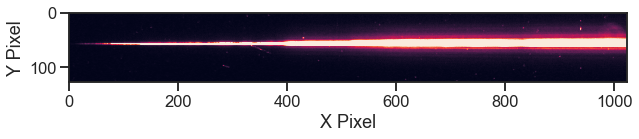

In [10]:
# comparison between the original and the cleaned image
# can easily see the lack of cosmic rays/bad pixels and removal of bad columns
plt.figure(figsize = (10,10))
im = plt.imshow(data_430[0][1])
im.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()
plt.figure(figsize = (10,10))
cim = plt.imshow(cleaned_1_430[1])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,10))
im = plt.imshow(data_430[0][-1])
im.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()
plt.figure(figsize = (10,10))
cim = plt.imshow(cleaned_215_430[-1])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

In [11]:
data_750[5]

[0, 12, 0, 15, 0, 15, 0, 15]

In [12]:
# now to clean the data - default is all steps on (dq, difference_correct, hc_correct, spline_correct)
# i'm breaking up the orbits manually here, not sure what the best way to do this automatically is yet
cleaned_1_750 = clean_data(data_750[0][:4], dqs = data_750[3][:4], traces = trace_fit_750[:4])
cleaned_2_750= clean_data(data_750[0][4:8], dqs = data_750[3][4:8], traces = trace_fit_750[3:7])
cleaned_3_750 = clean_data(data_750[0][8:12], dqs = data_750[3][8:12], traces = trace_fit_750[8:12])

cleaned_4_750 = clean_data(data_750[0][12:16], dqs = data_750[3][12:16], traces = trace_fit_750[12:16])
cleaned_5_750 = clean_data(data_750[0][16:20], dqs = data_750[3][16:20], traces = trace_fit_750[16:20])
cleaned_6_750 = clean_data(data_750[0][20:24], dqs = data_750[3][20:24], traces = trace_fit_750[20:24])
cleaned_7_750 = clean_data(data_750[0][24:27], dqs = data_750[3][24:27], traces = trace_fit_750[24:27])

cleaned_8_750 = clean_data(data_750[0][27:31], dqs = data_750[3][27:31], traces = trace_fit_750[27:31])
cleaned_9_750 = clean_data(data_750[0][31:35], dqs = data_750[3][31:35], traces = trace_fit_750[31:35])
cleaned_10_750 = clean_data(data_750[0][35:39], dqs = data_750[3][35:39], traces = trace_fit_750[35:39])
cleaned_11_750 = clean_data(data_750[0][39:42], dqs = data_750[3][39:42], traces = trace_fit_750[39:42])

cleaned_12_750 = clean_data(data_750[0][42:46], dqs = data_750[3][42:46], traces = trace_fit_750[42:46])
cleaned_13_750 = clean_data(data_750[0][46:50], dqs = data_750[3][46:50], traces = trace_fit_750[46:50])
cleaned_14_750 = clean_data(data_750[0][50:54], dqs = data_750[3][50:54], traces = trace_fit_750[50:54])
cleaned_15_750 = clean_data(data_750[0][54:57], dqs = data_750[3][54:57], traces = trace_fit_750[54:57])

Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting differenc

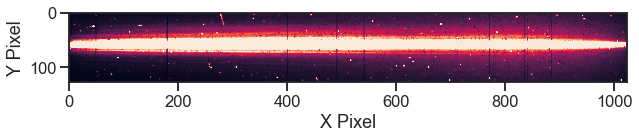

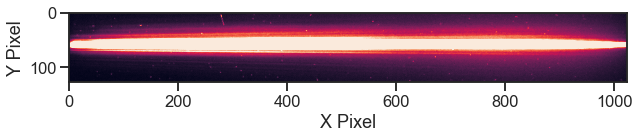

In [13]:
plt.figure(figsize = (10,10))
cim = plt.imshow(data_750[0][1])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()
plt.figure(figsize = (10,10))
cim = plt.imshow(cleaned_1_750[1])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

In [14]:
# just putting all of the cleaned files into one list
transit_750_cleaned = [*cleaned_1_750, *cleaned_2_750, *cleaned_3_750, *cleaned_4_750, *cleaned_5_750, *cleaned_6_750, *cleaned_7_750, *cleaned_8_750, *cleaned_9_750, *cleaned_10_750, *cleaned_11_750, *cleaned_12_750, *cleaned_13_750, *cleaned_14_750, *cleaned_15_750]
transit_430_cleaned = [*cleaned_1_430, *cleaned_2_430, *cleaned_3_430, *cleaned_4_430, *cleaned_5_430, *cleaned_6_430, *cleaned_7_430, *cleaned_8_430, *cleaned_9_430, *cleaned_10_430, *cleaned_11_430, *cleaned_12_430, *cleaned_13_430, *cleaned_14_430, *cleaned_15_430]
transit_430_2_cleaned = [*cleaned_21_430, *cleaned_22_430, *cleaned_23_430, *cleaned_24_430, *cleaned_25_430, *cleaned_26_430, *cleaned_27_430, *cleaned_28_430, *cleaned_29_430, *cleaned_210_430, *cleaned_211_430, *cleaned_212_430, *cleaned_213_430, *cleaned_214_430, *cleaned_215_430]

Frame 0


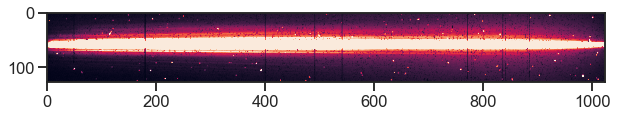

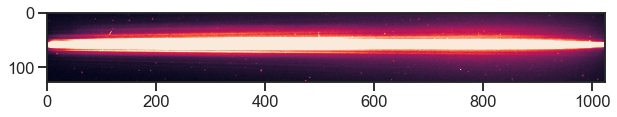

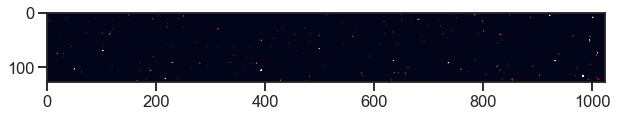

Frame 1


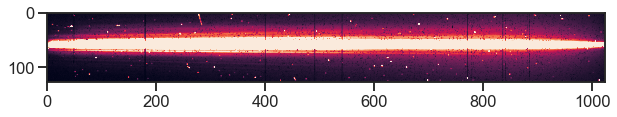

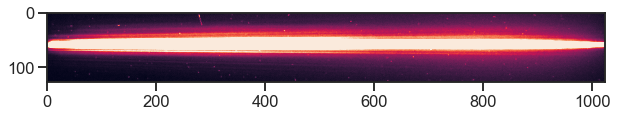

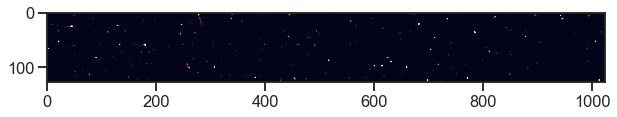

Frame 2


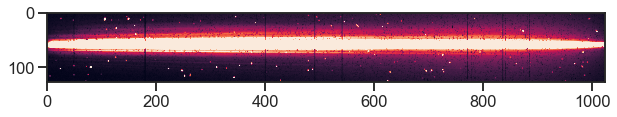

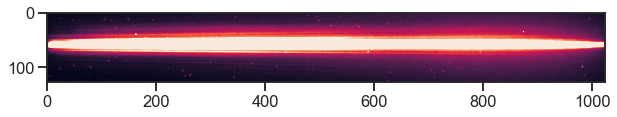

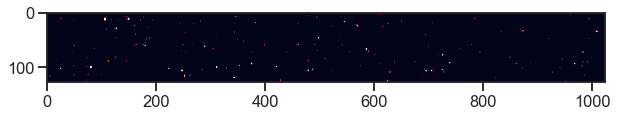

Frame 3


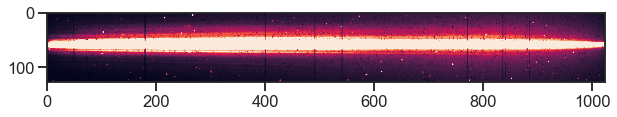

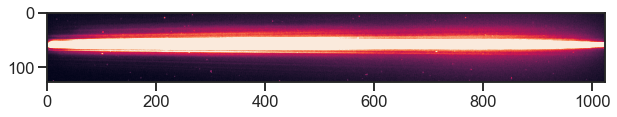

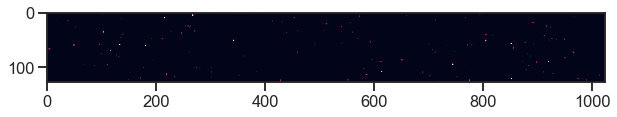

Frame 4


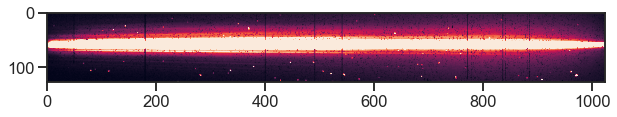

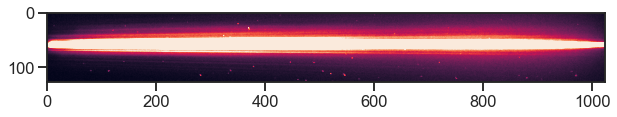

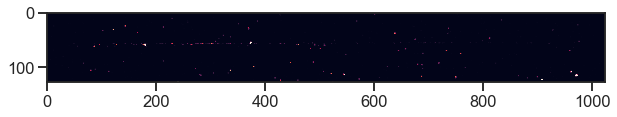

Frame 5


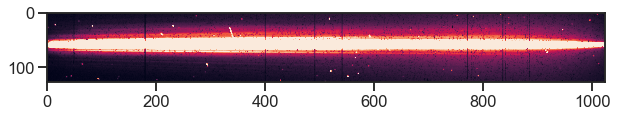

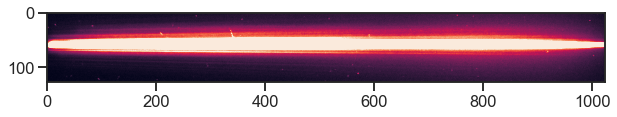

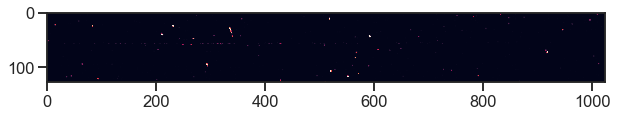

Frame 6


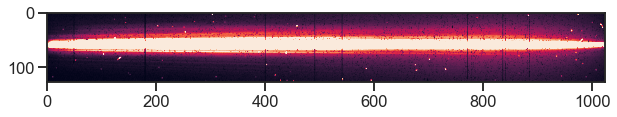

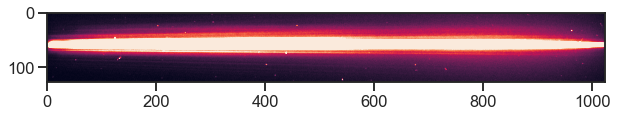

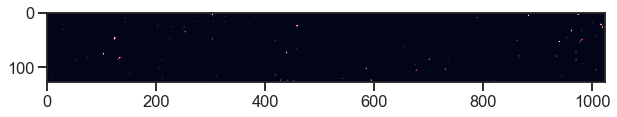

Frame 7


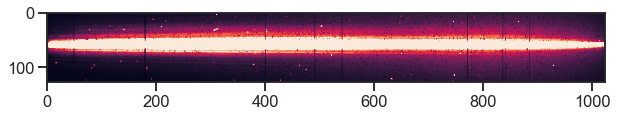

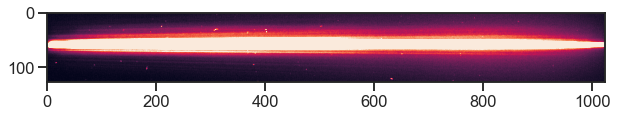

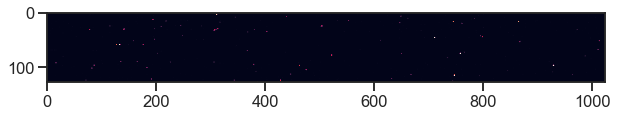

Frame 8


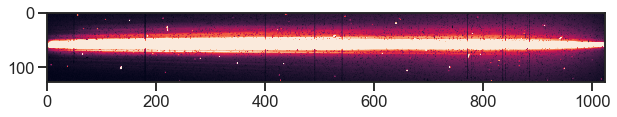

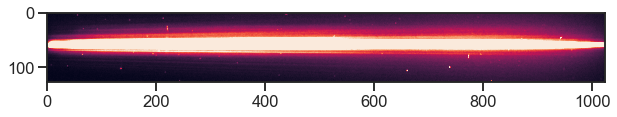

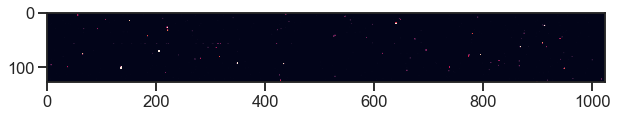

Frame 9


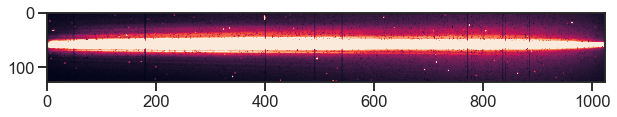

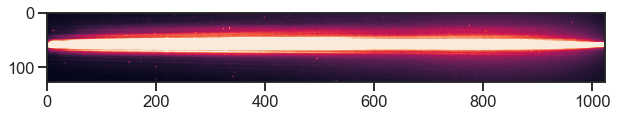

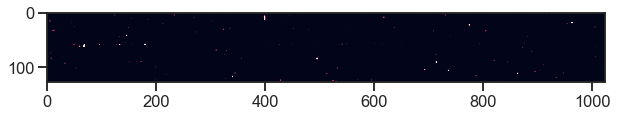

Frame 10


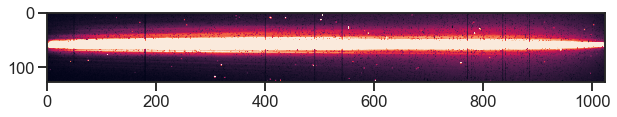

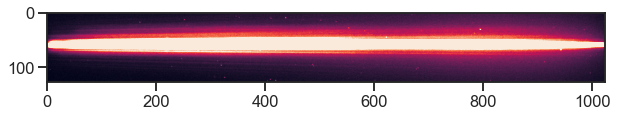

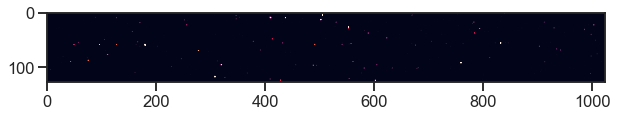

Frame 11


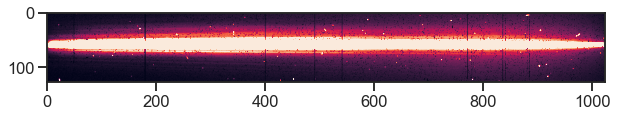

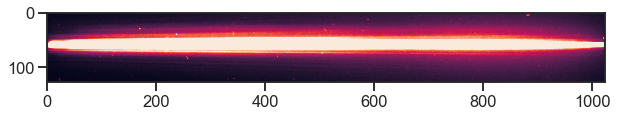

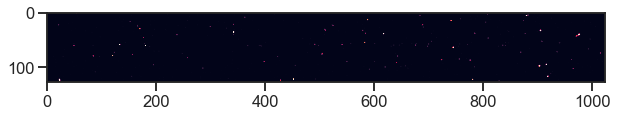

Frame 12


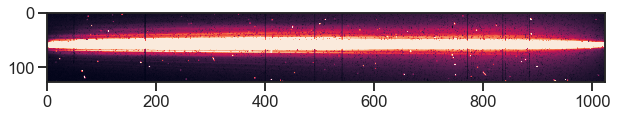

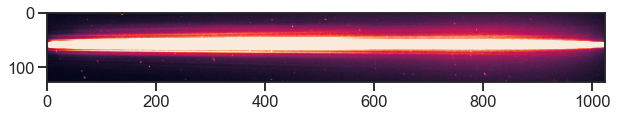

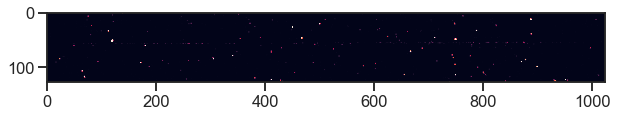

Frame 13


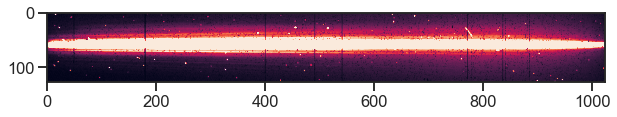

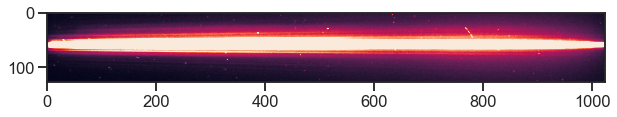

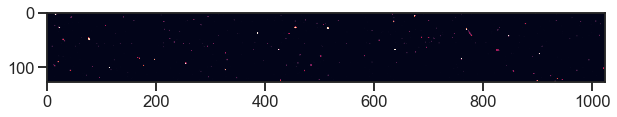

Frame 14


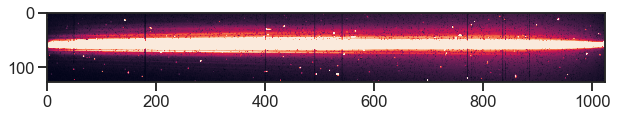

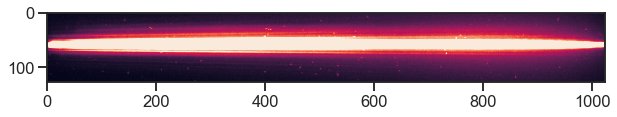

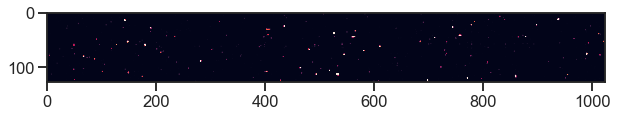

Frame 15


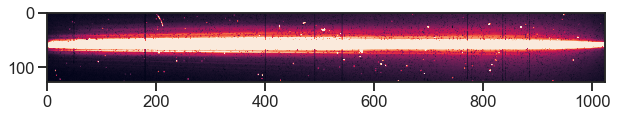

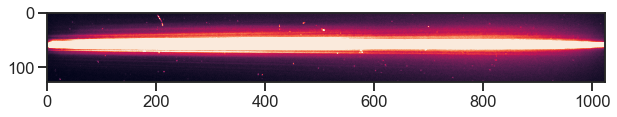

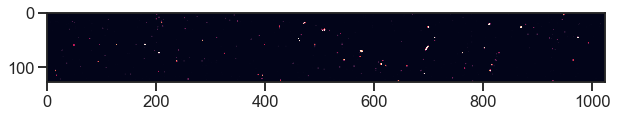

Frame 16


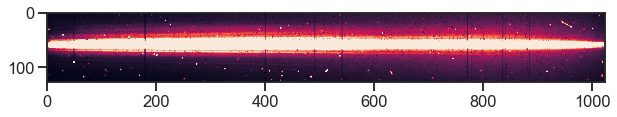

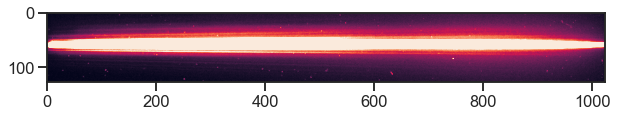

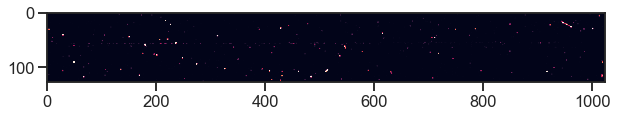

Frame 17


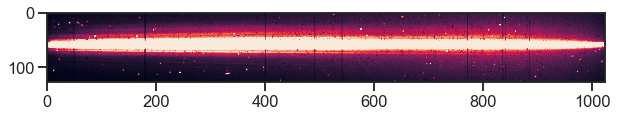

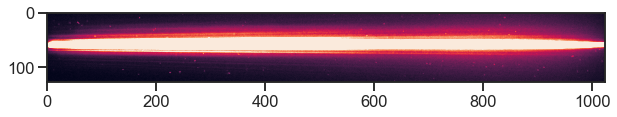

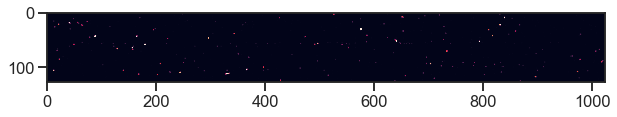

Frame 18


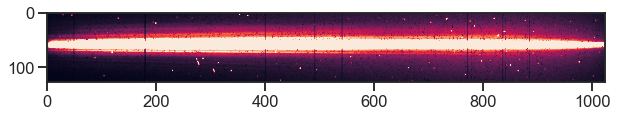

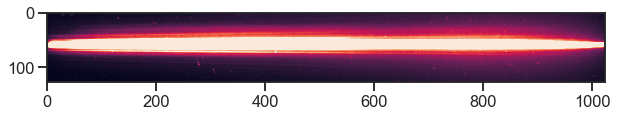

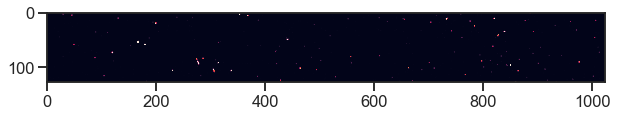

Frame 19


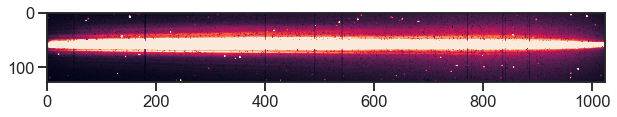

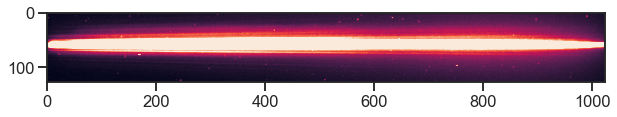

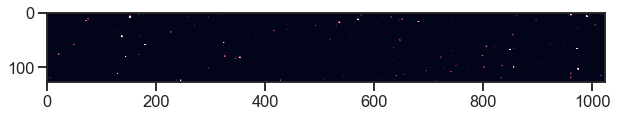

Frame 20


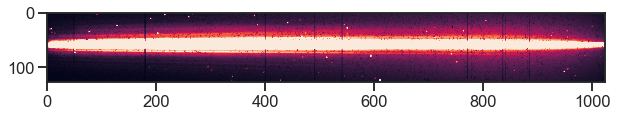

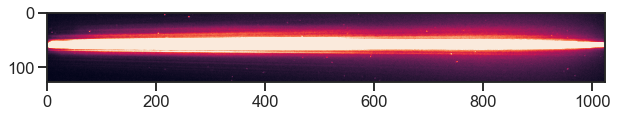

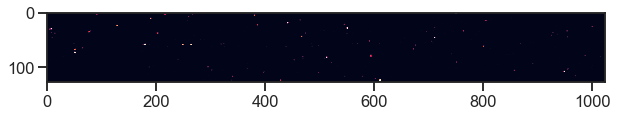

Frame 21


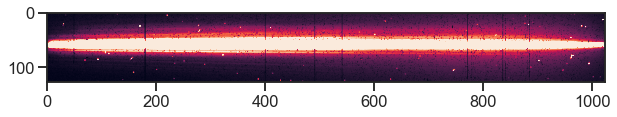

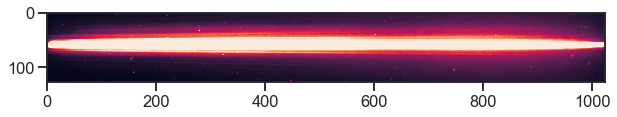

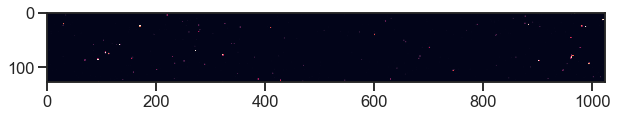

Frame 22


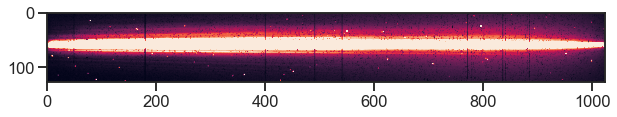

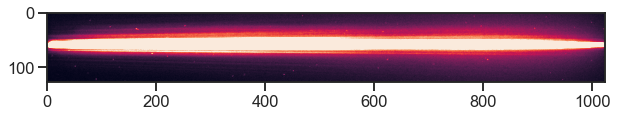

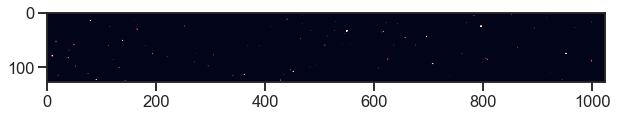

Frame 23


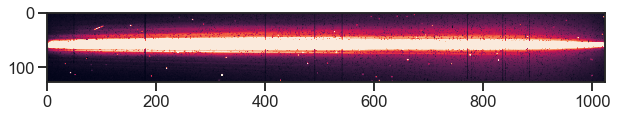

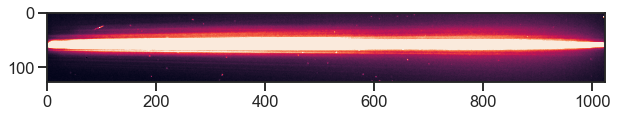

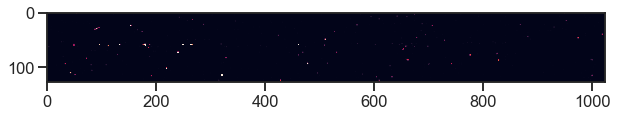

Frame 24


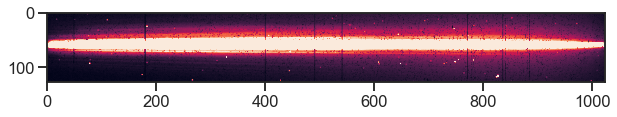

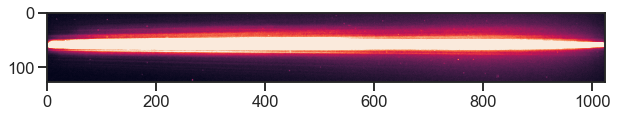

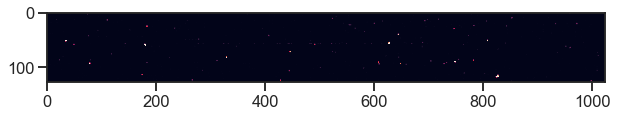

Frame 25


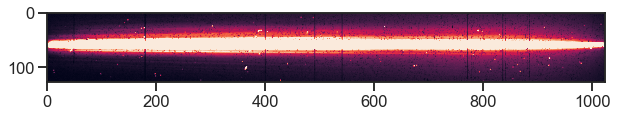

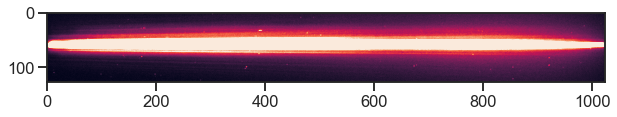

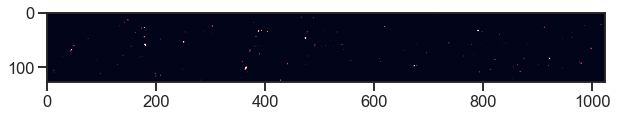

Frame 26


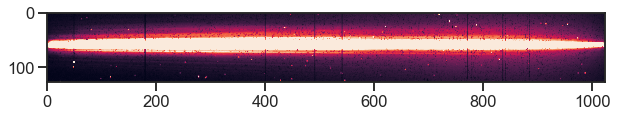

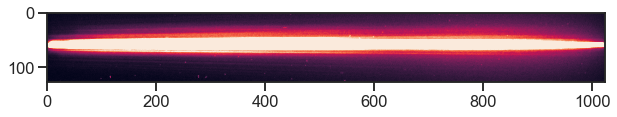

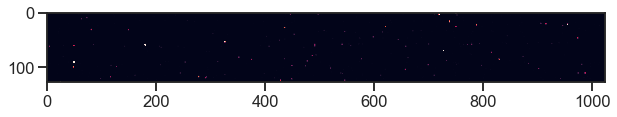

Frame 27


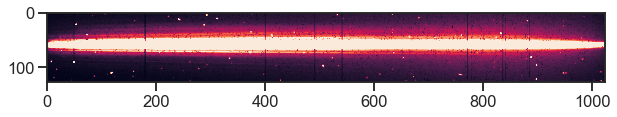

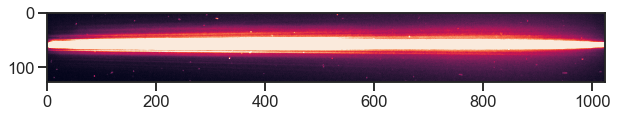

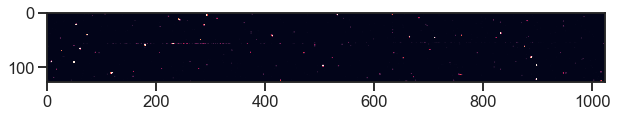

Frame 28


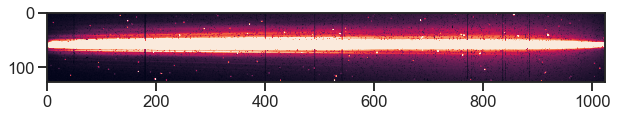

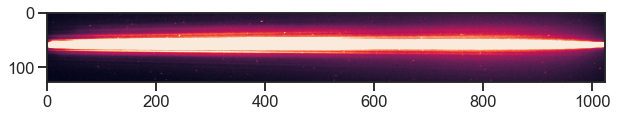

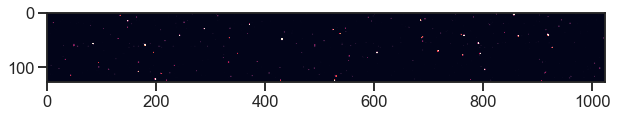

Frame 29


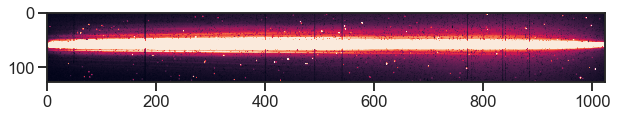

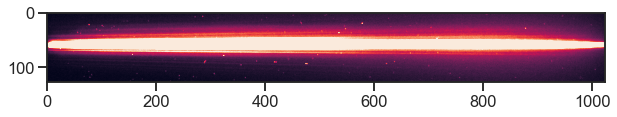

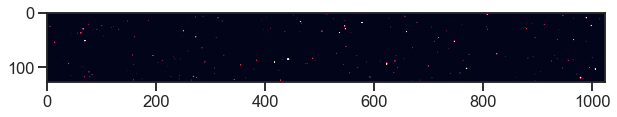

Frame 30


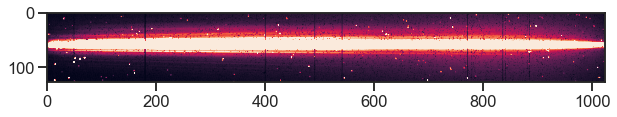

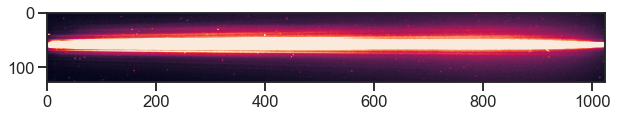

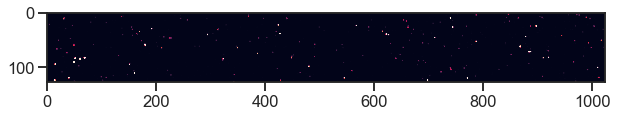

Frame 31


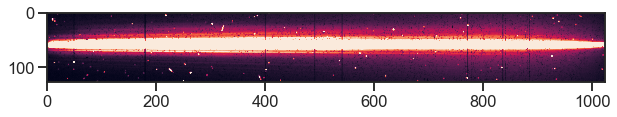

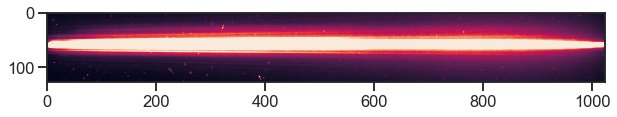

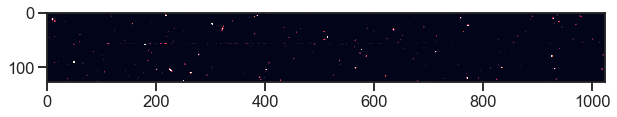

Frame 32


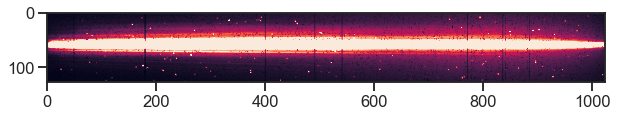

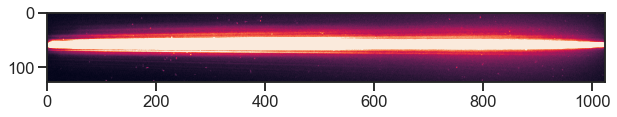

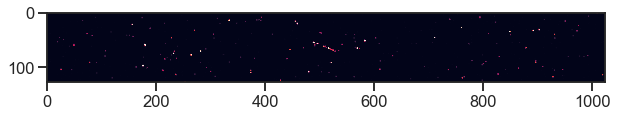

Frame 33


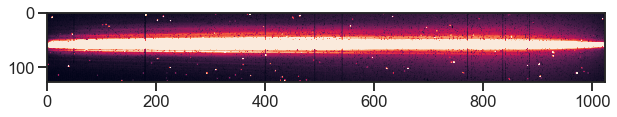

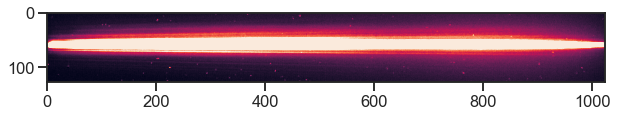

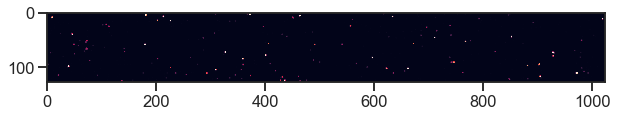

Frame 34


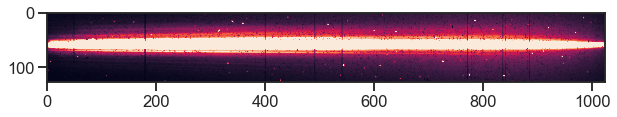

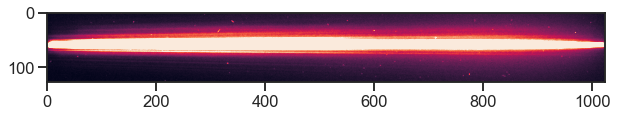

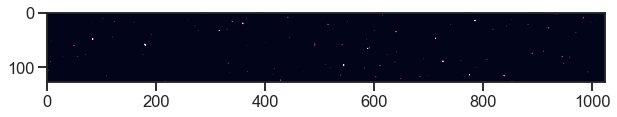

Frame 35


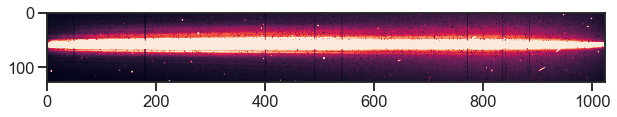

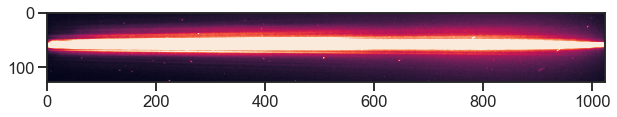

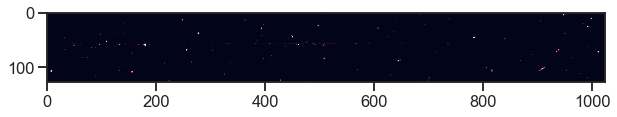

Frame 36


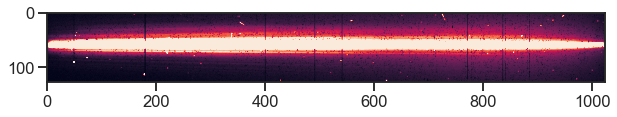

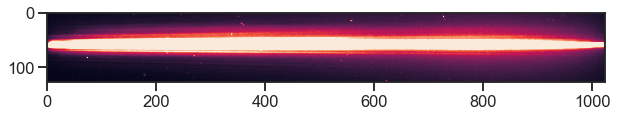

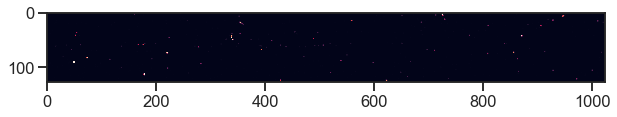

Frame 37


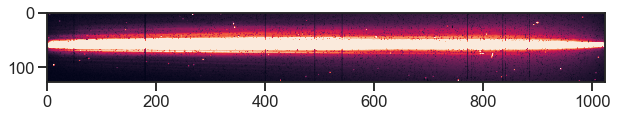

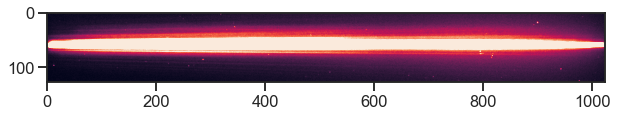

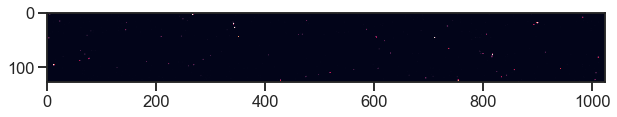

Frame 38


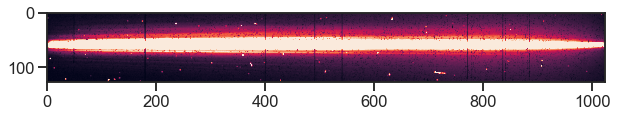

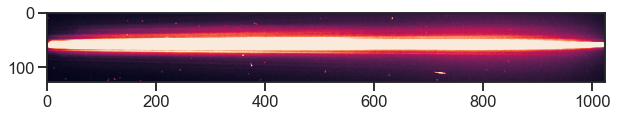

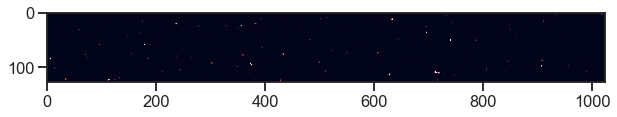

Frame 39


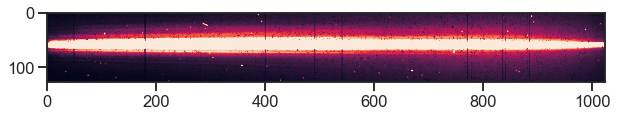

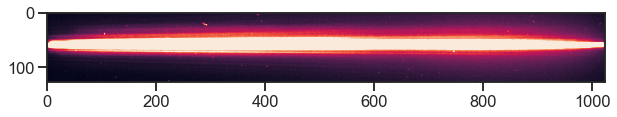

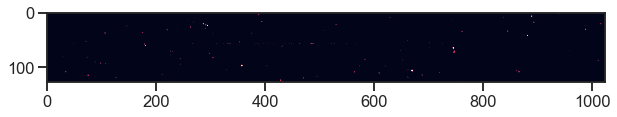

Frame 40


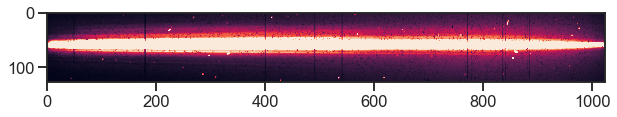

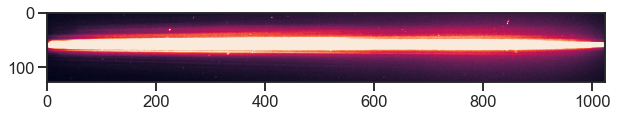

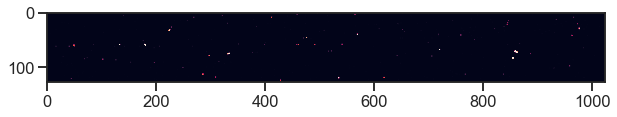

Frame 41


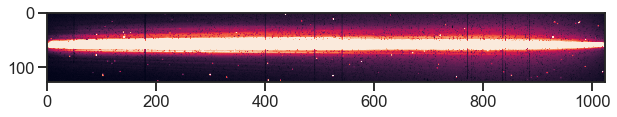

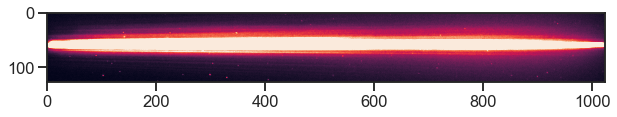

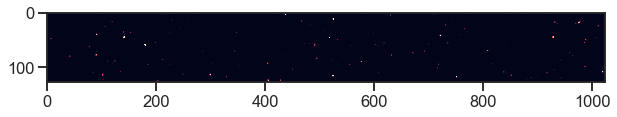

Frame 42


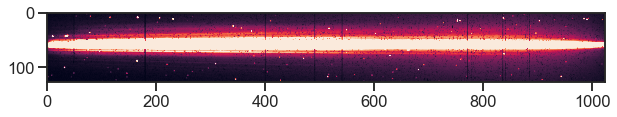

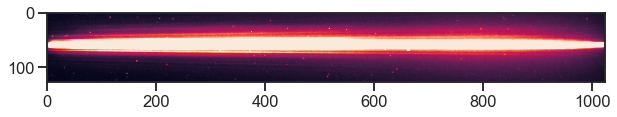

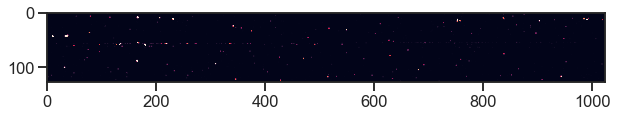

Frame 43


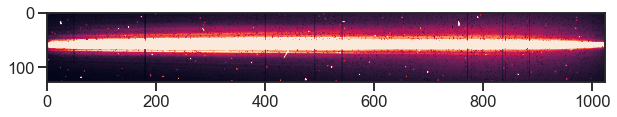

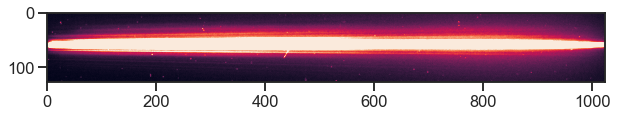

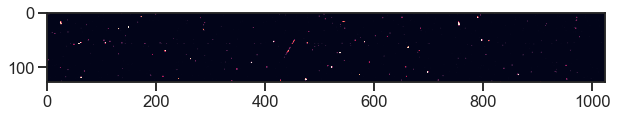

Frame 44


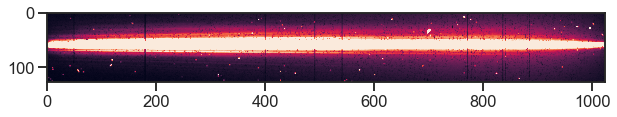

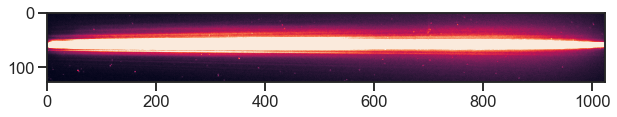

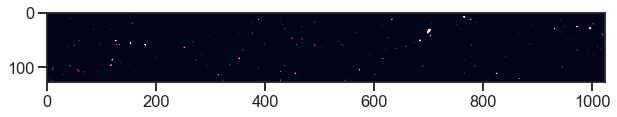

Frame 45


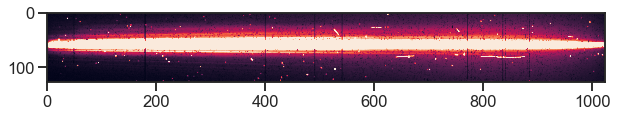

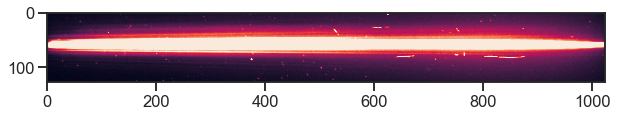

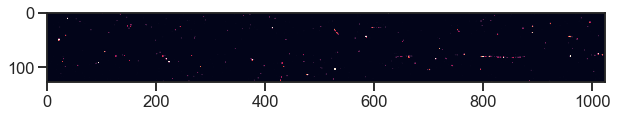

Frame 46


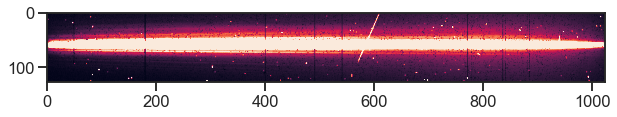

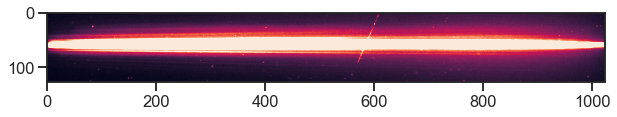

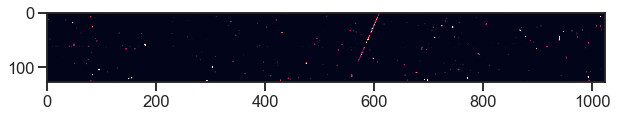

Frame 47


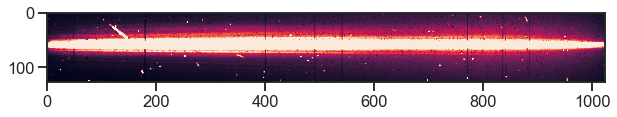

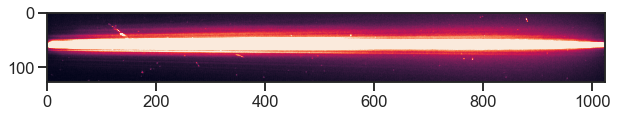

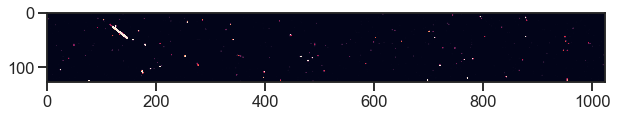

Frame 48


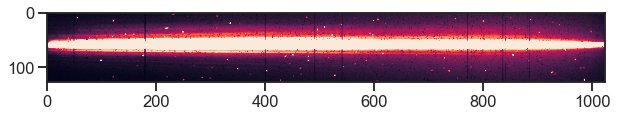

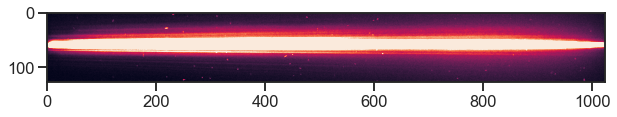

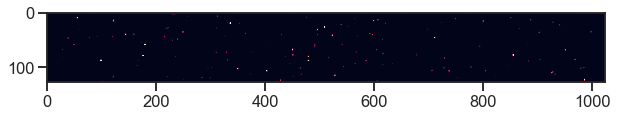

Frame 49


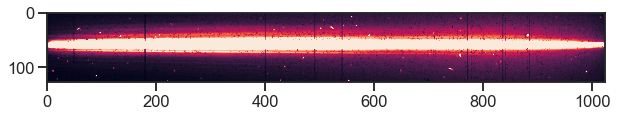

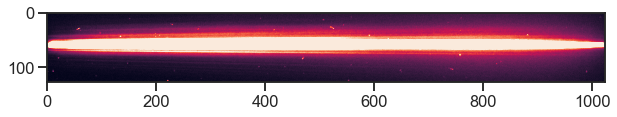

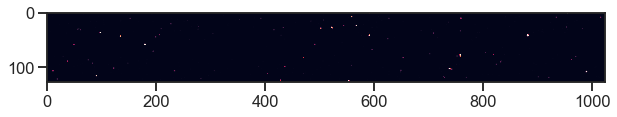

Frame 50


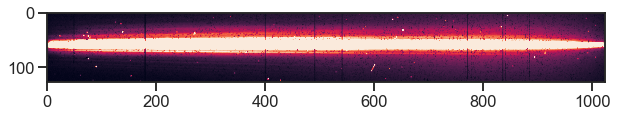

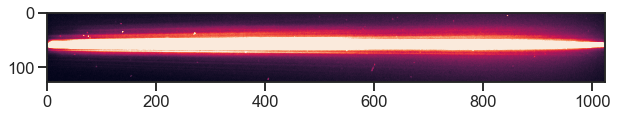

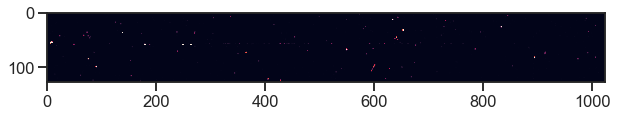

Frame 51


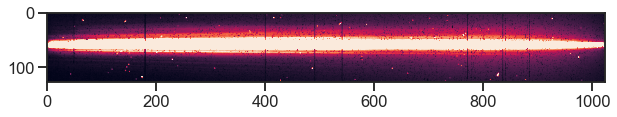

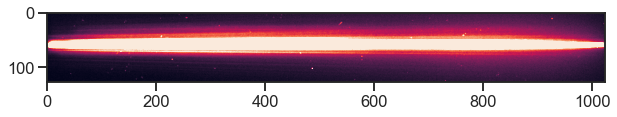

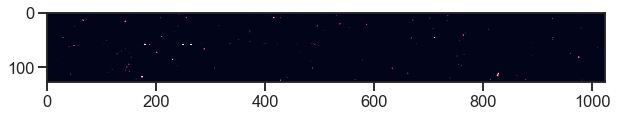

Frame 52


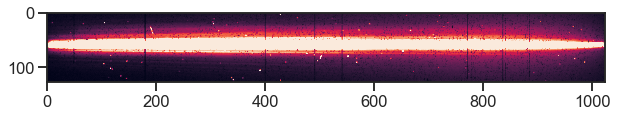

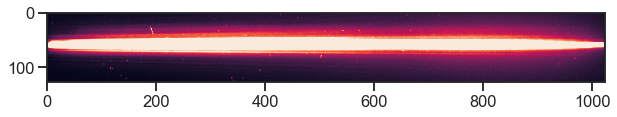

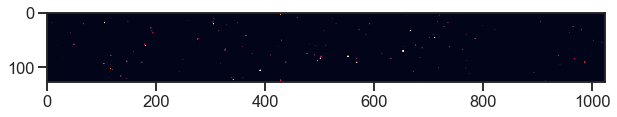

Frame 53


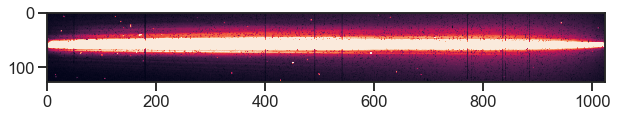

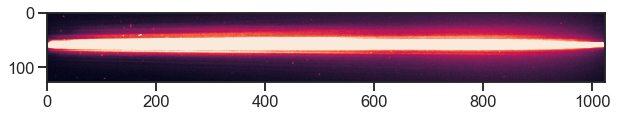

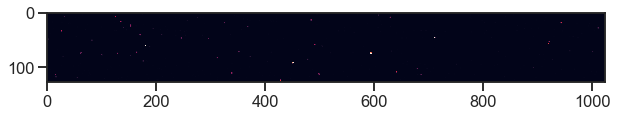

Frame 54


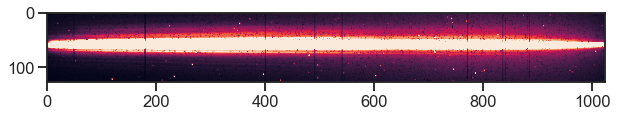

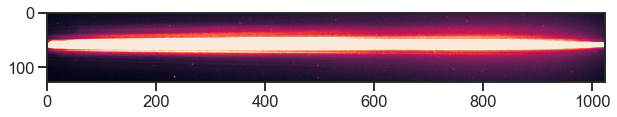

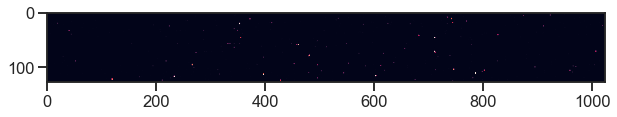

Frame 55


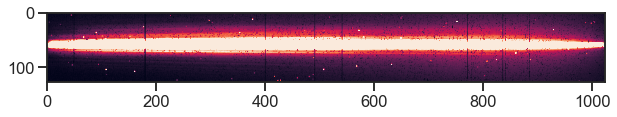

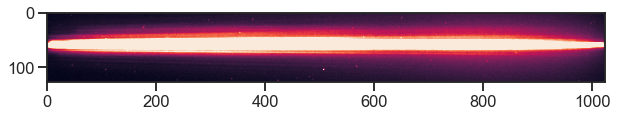

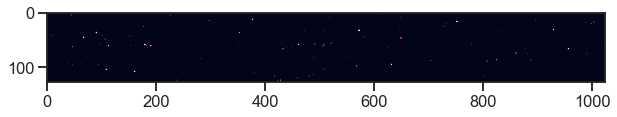

Frame 56


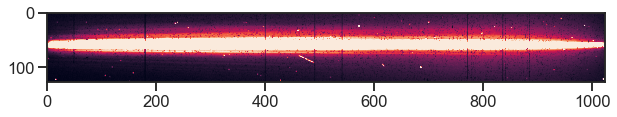

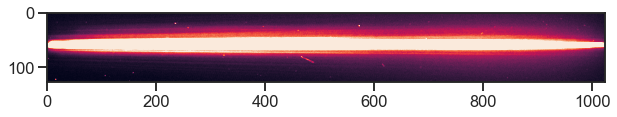

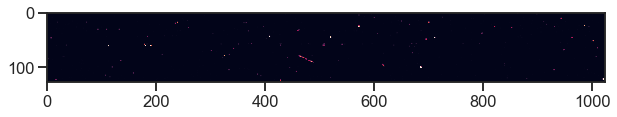

In [15]:
# let's look at the 750 data
for i in range(len(transit_750_cleaned)):
    print("Frame", i)
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_750[0][i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(transit_750_cleaned[i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_750[0][i]-transit_750_cleaned[i])
    im.set_clim(0,200)
    plt.show()
        

Frame 0


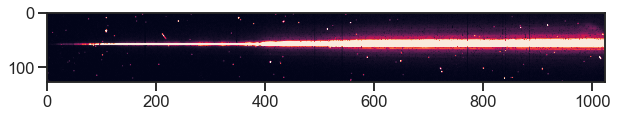

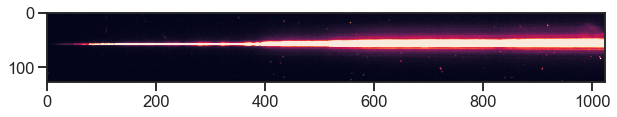

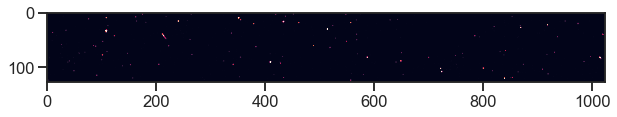

Frame 1


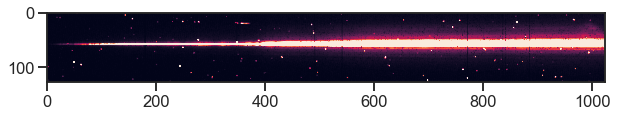

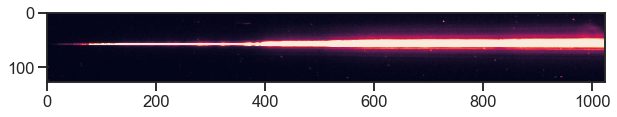

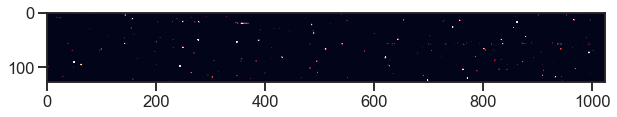

Frame 2


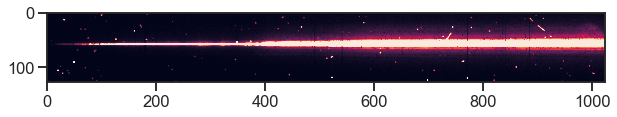

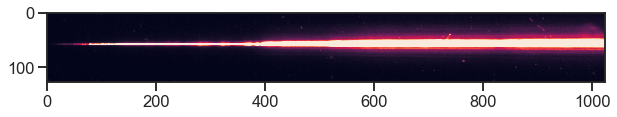

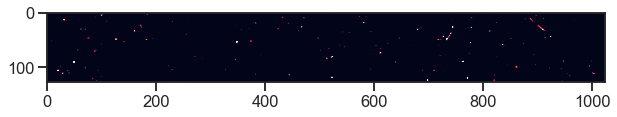

Frame 3


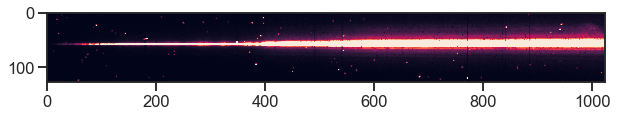

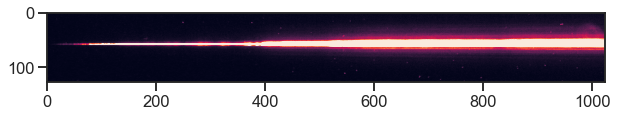

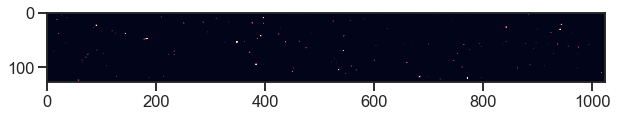

Frame 4


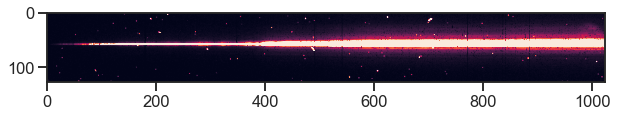

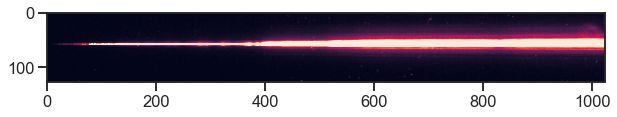

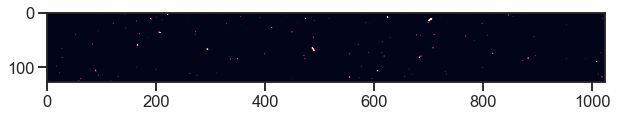

Frame 5


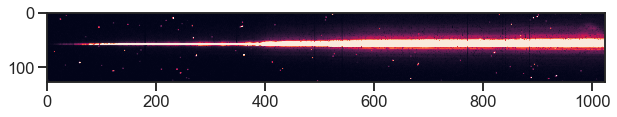

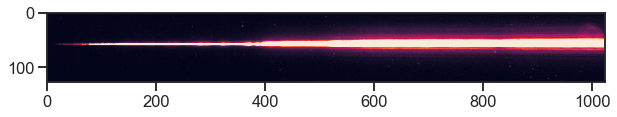

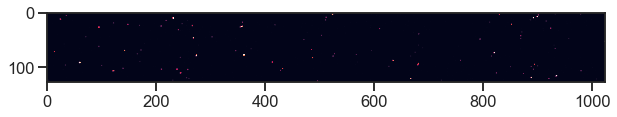

Frame 6


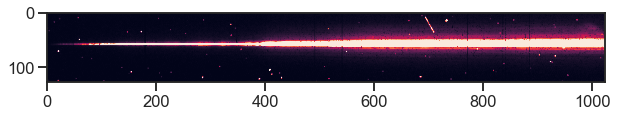

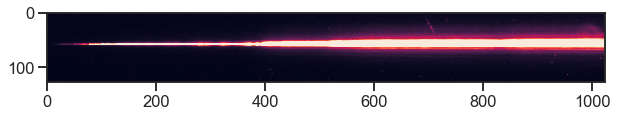

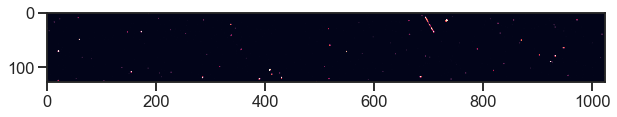

Frame 7


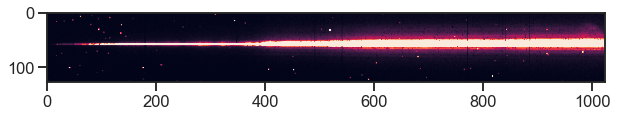

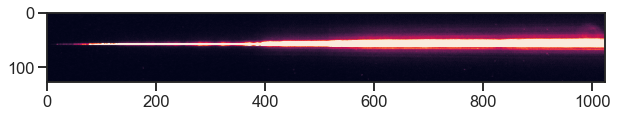

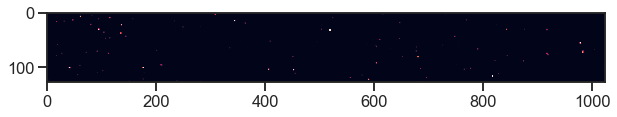

Frame 8


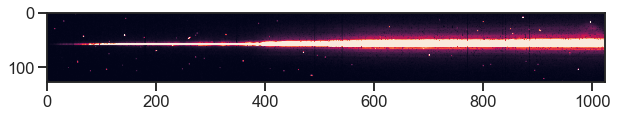

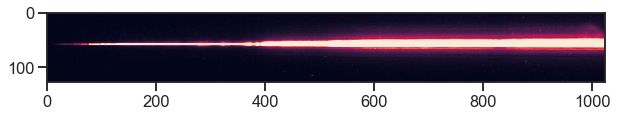

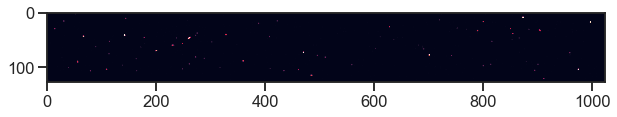

Frame 9


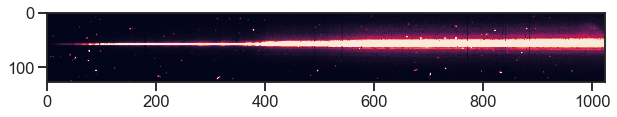

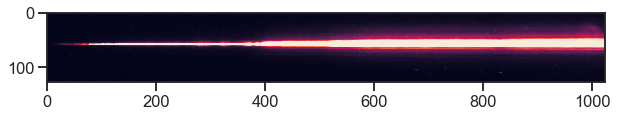

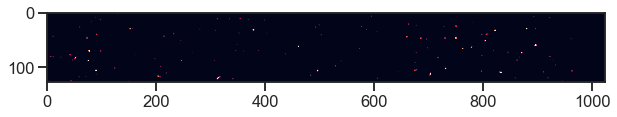

Frame 10


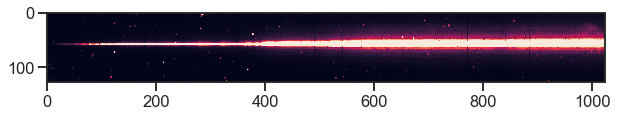

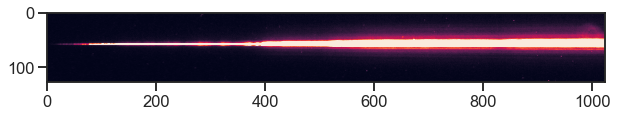

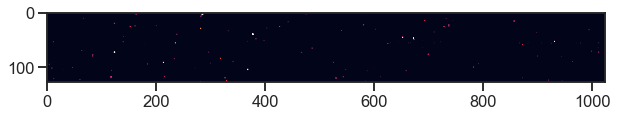

Frame 11


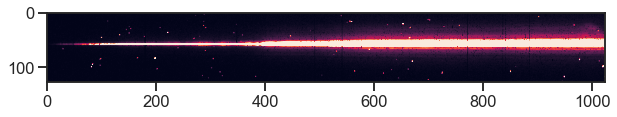

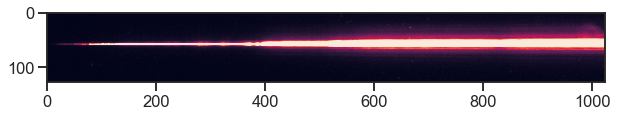

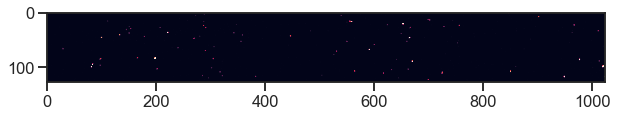

Frame 12


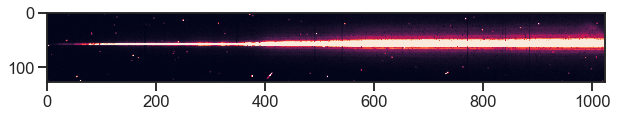

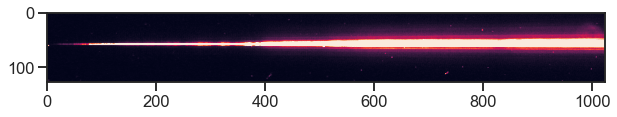

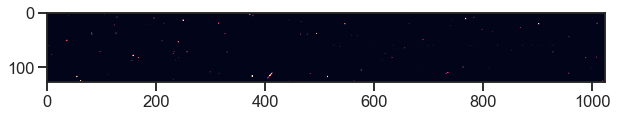

Frame 13


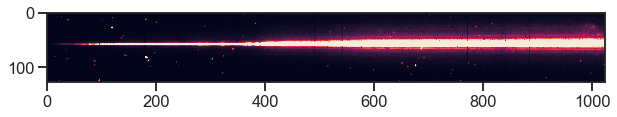

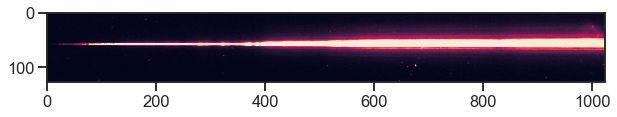

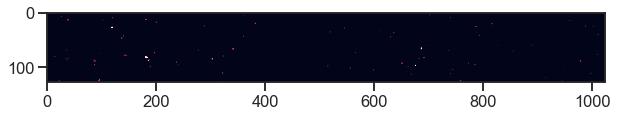

Frame 14


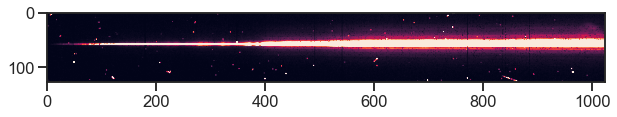

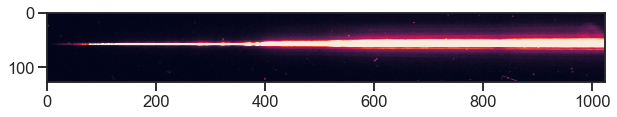

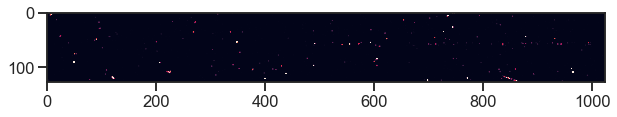

Frame 15


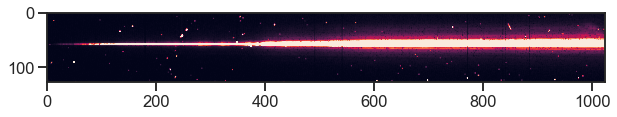

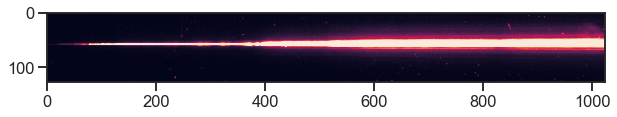

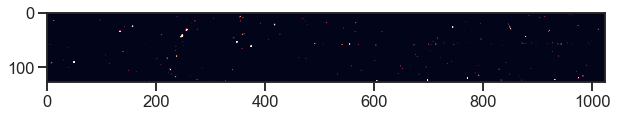

Frame 16


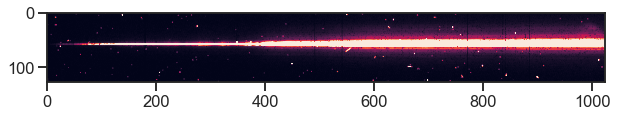

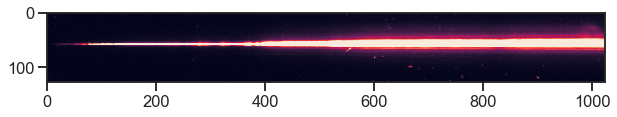

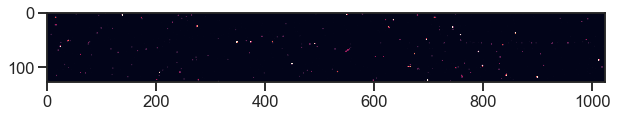

Frame 17


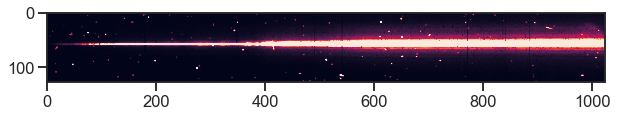

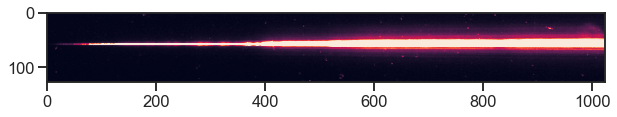

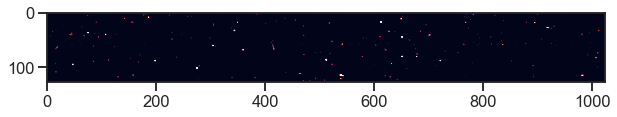

Frame 18


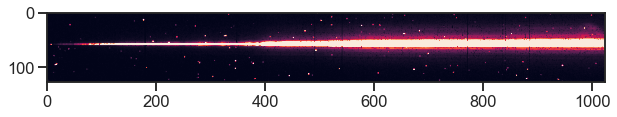

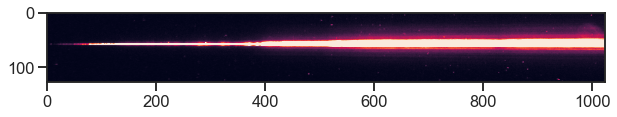

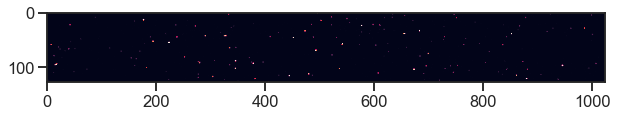

Frame 19


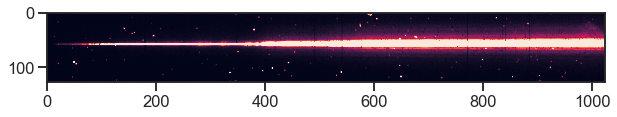

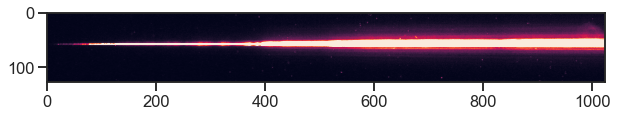

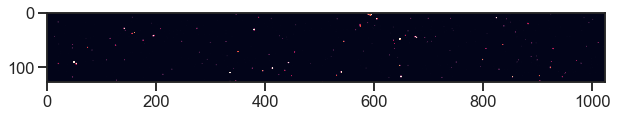

Frame 20


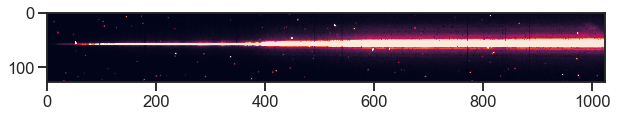

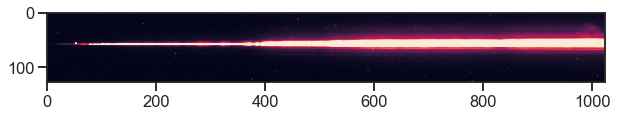

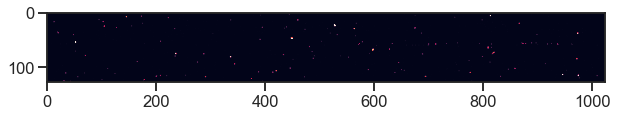

Frame 21


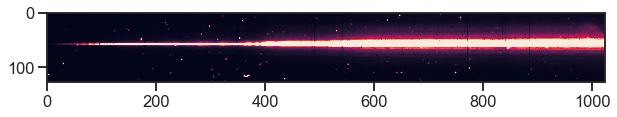

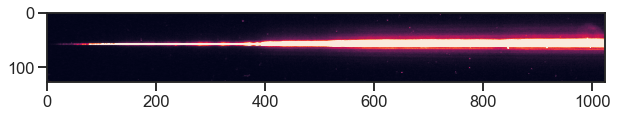

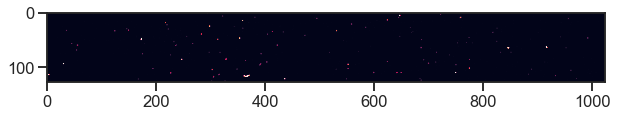

Frame 22


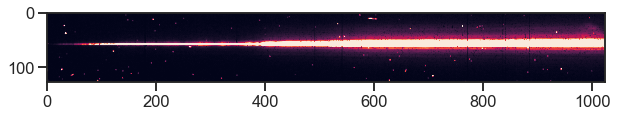

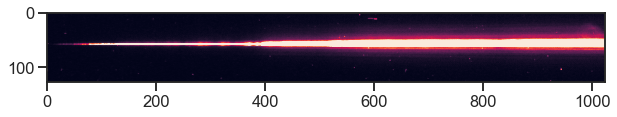

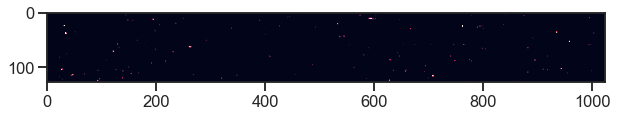

Frame 23


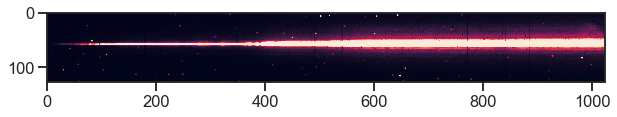

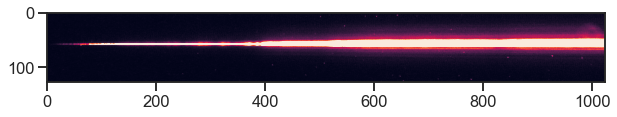

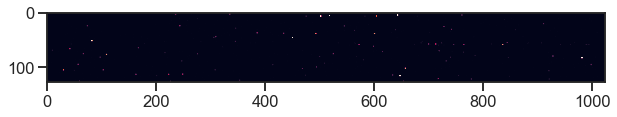

Frame 24


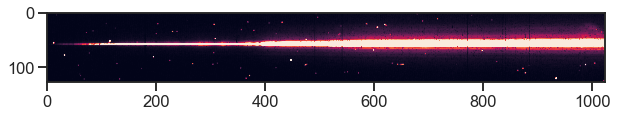

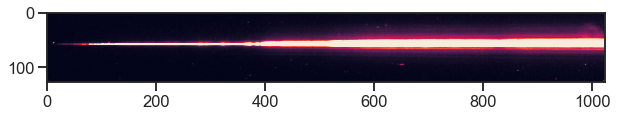

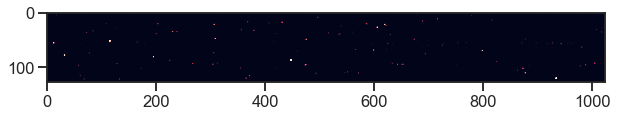

Frame 25


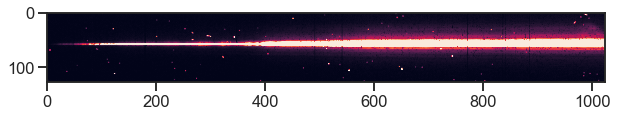

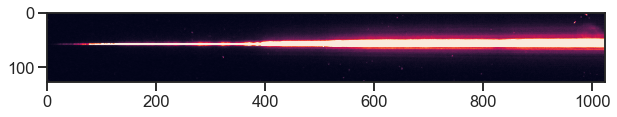

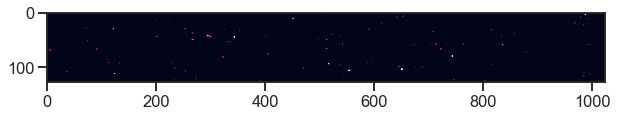

Frame 26


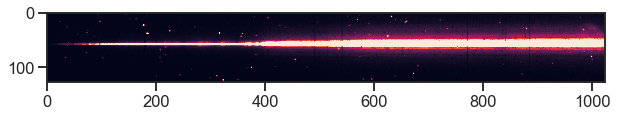

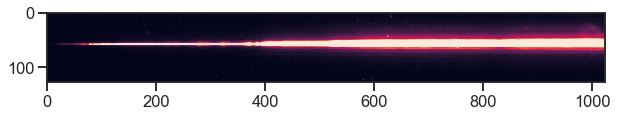

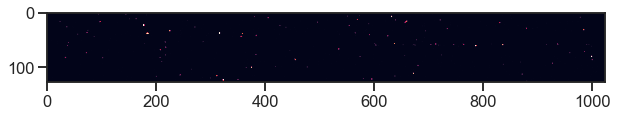

Frame 27


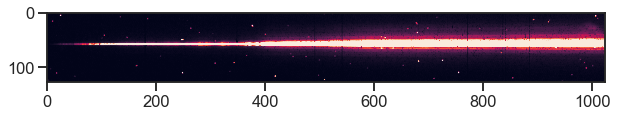

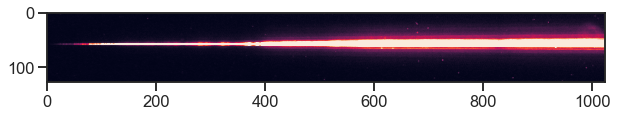

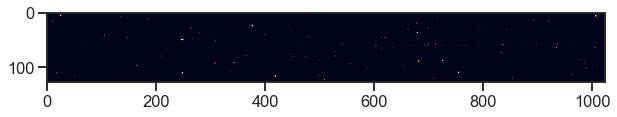

Frame 28


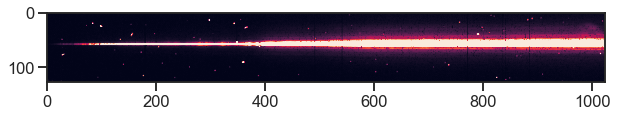

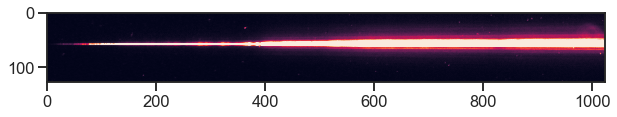

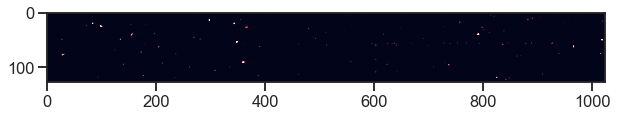

Frame 29


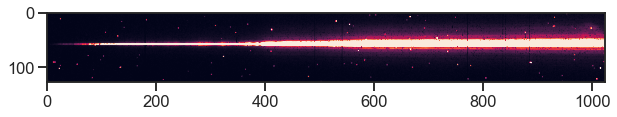

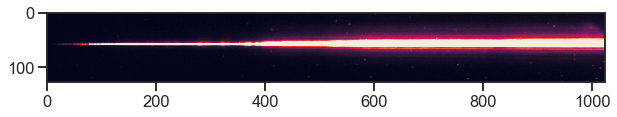

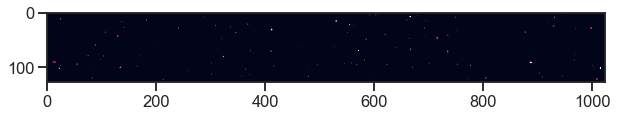

Frame 30


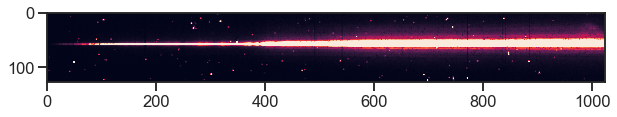

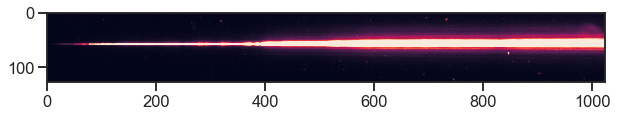

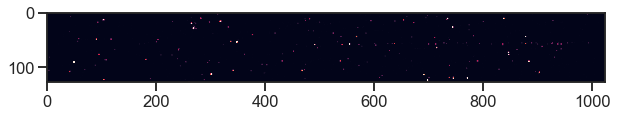

Frame 31


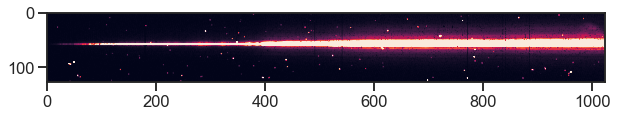

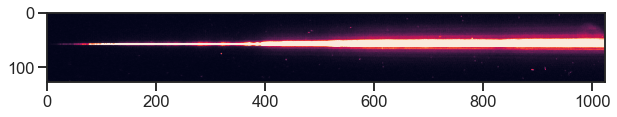

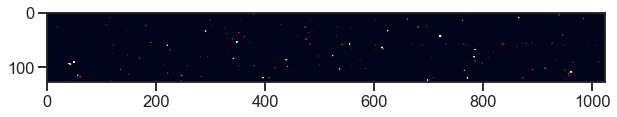

Frame 32


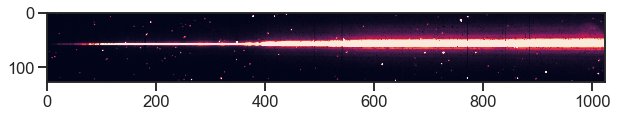

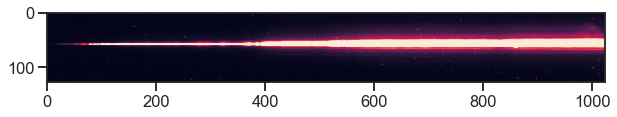

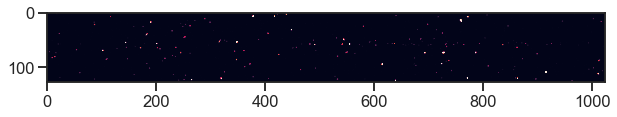

Frame 33


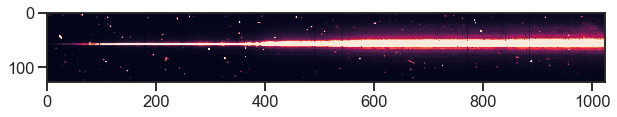

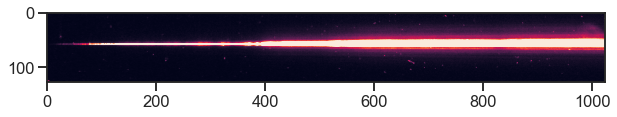

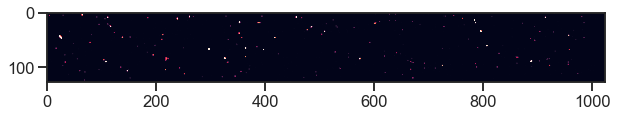

Frame 34


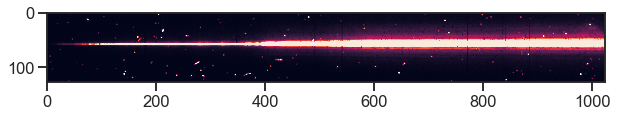

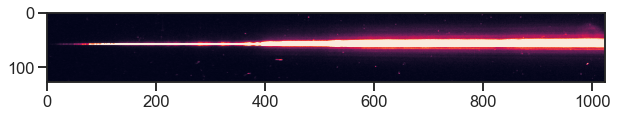

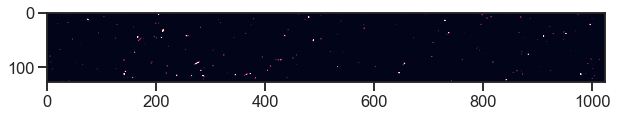

Frame 35


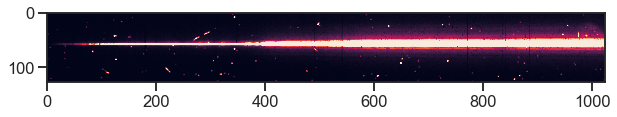

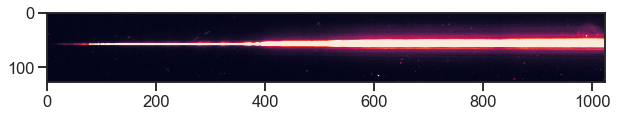

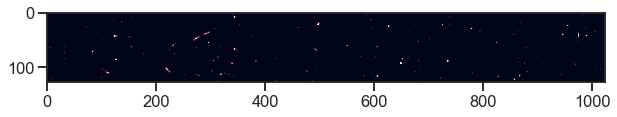

Frame 36


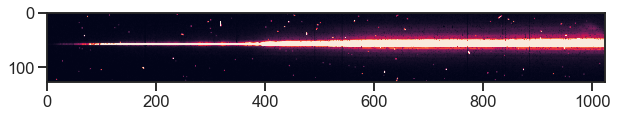

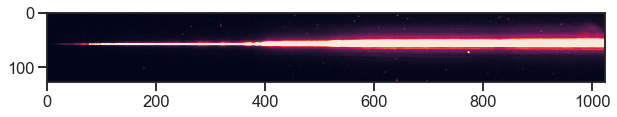

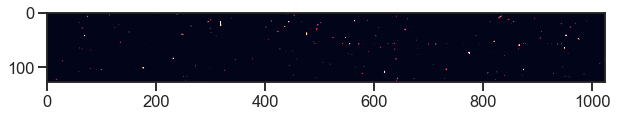

Frame 37


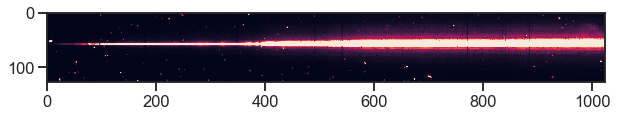

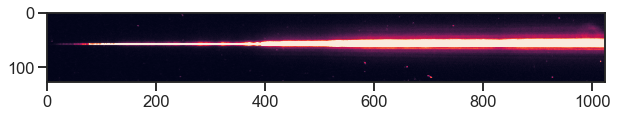

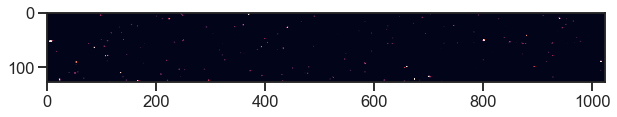

Frame 38


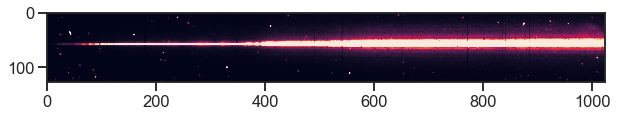

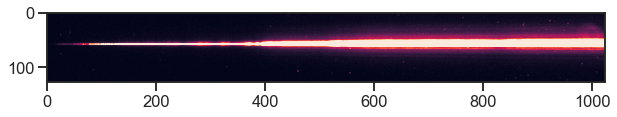

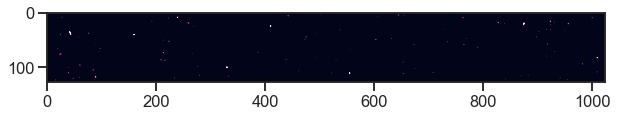

Frame 39


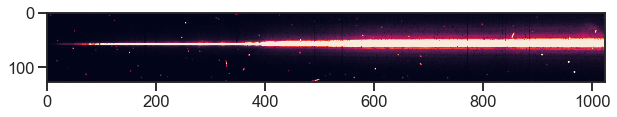

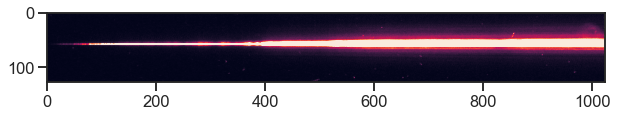

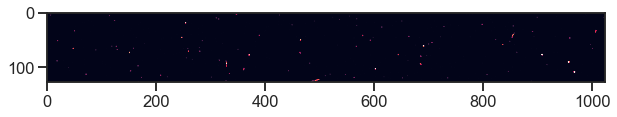

Frame 40


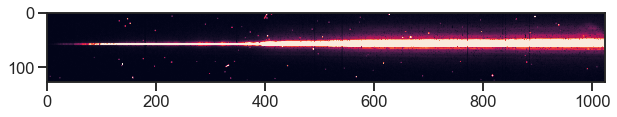

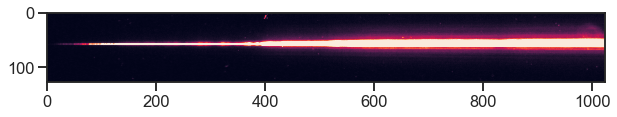

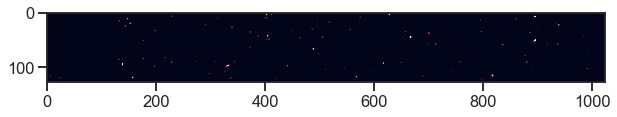

Frame 41


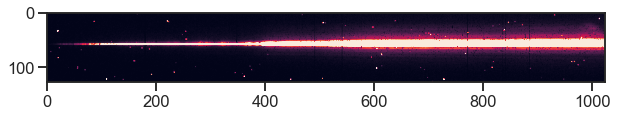

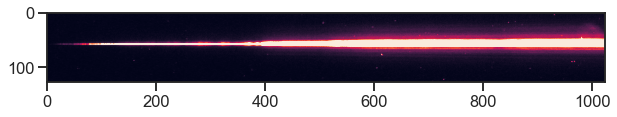

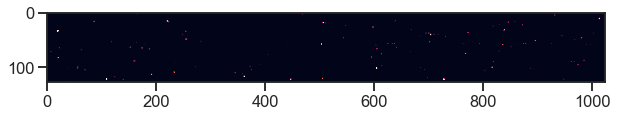

Frame 42


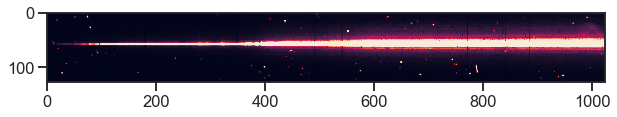

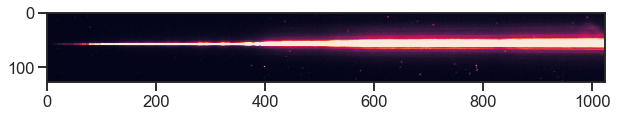

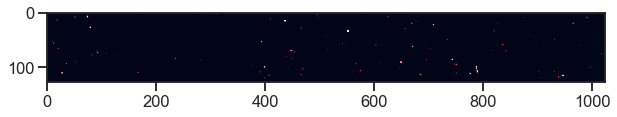

Frame 43


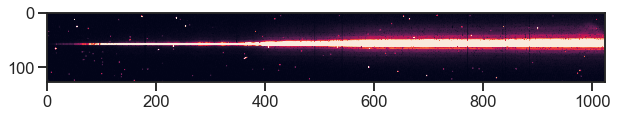

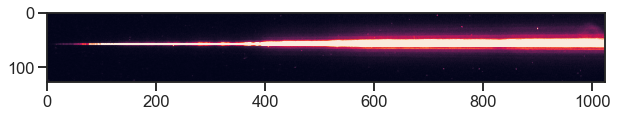

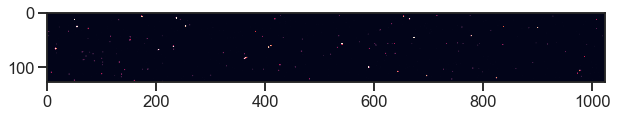

Frame 44


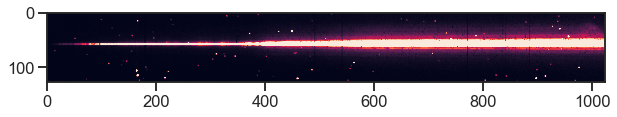

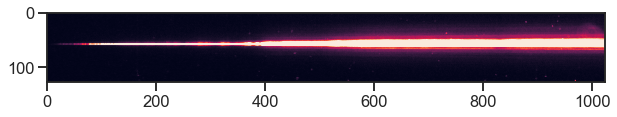

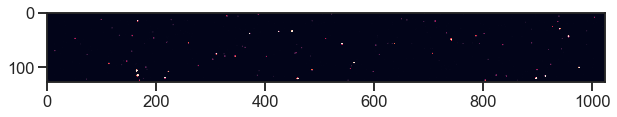

Frame 45


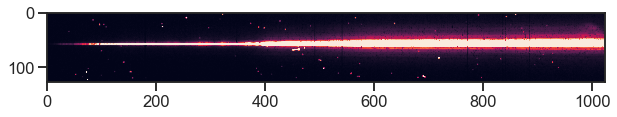

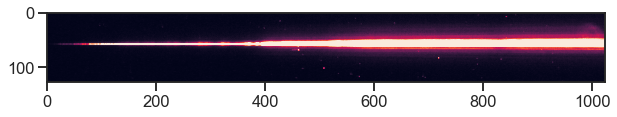

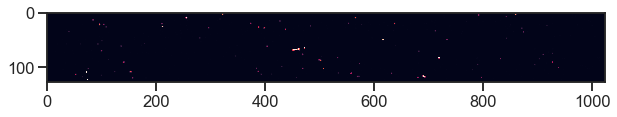

Frame 46


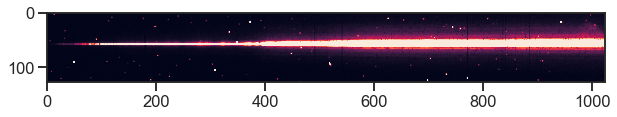

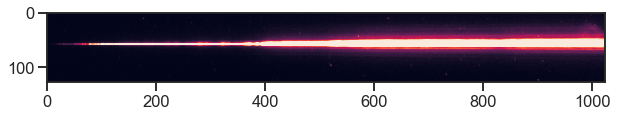

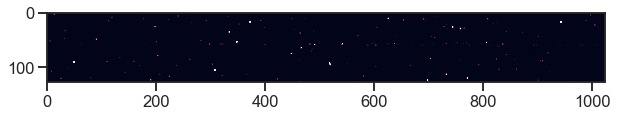

Frame 47


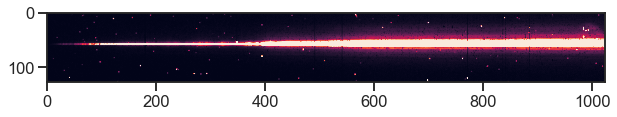

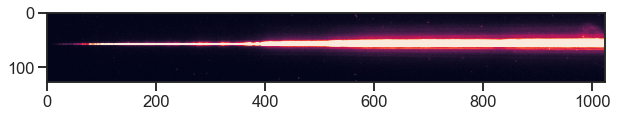

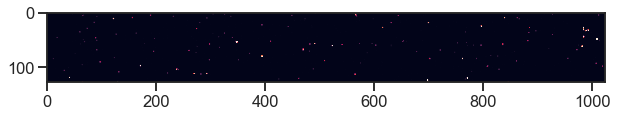

Frame 48


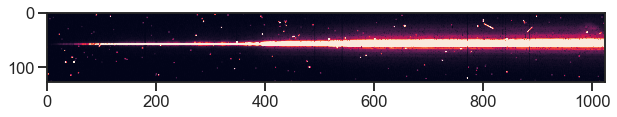

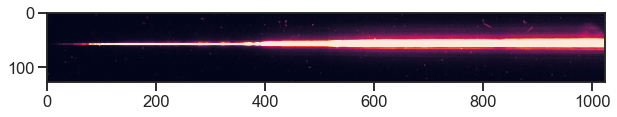

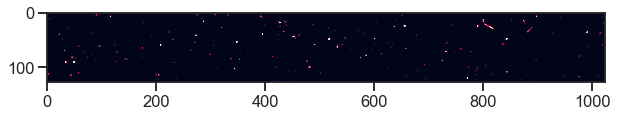

Frame 49


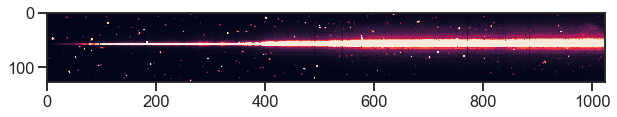

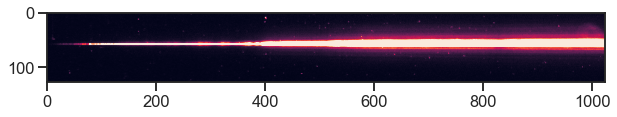

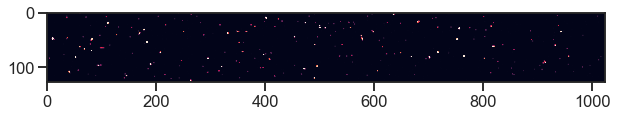

Frame 50


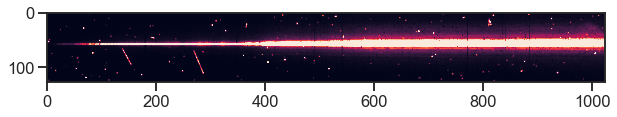

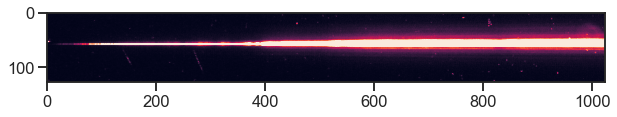

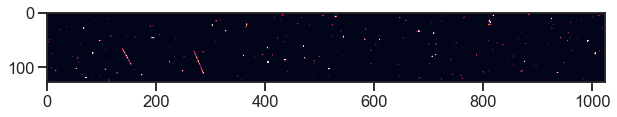

Frame 51


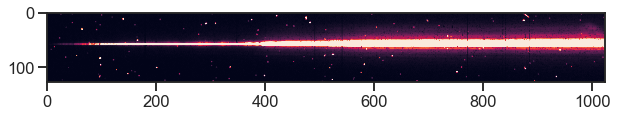

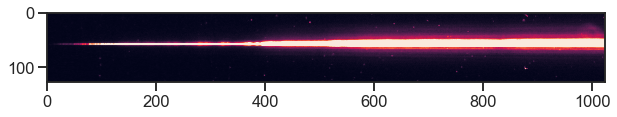

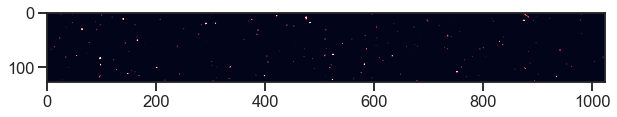

Frame 52


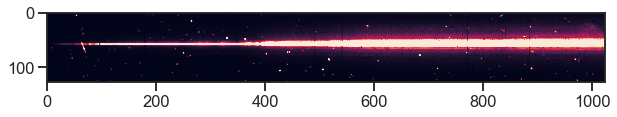

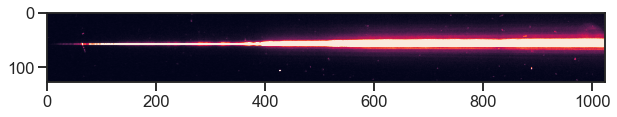

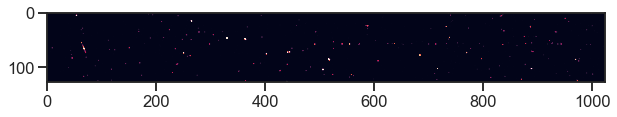

Frame 53


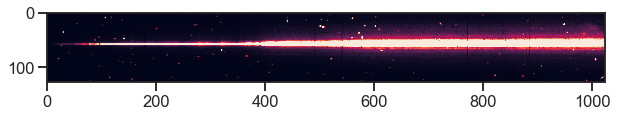

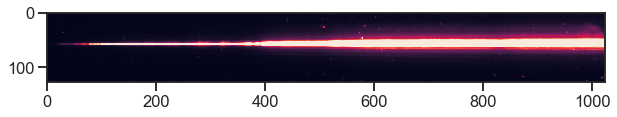

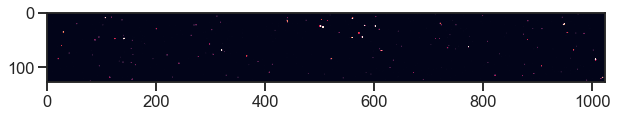

Frame 54


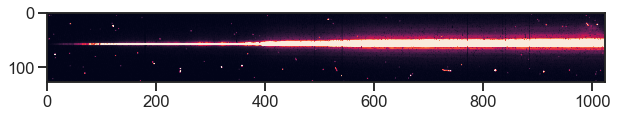

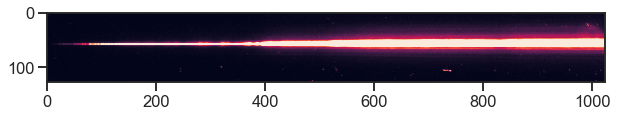

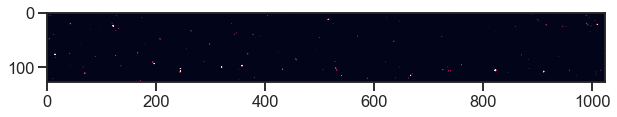

Frame 55


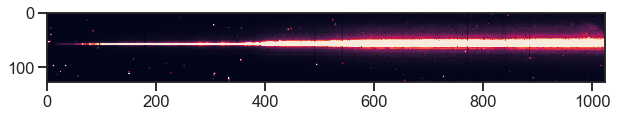

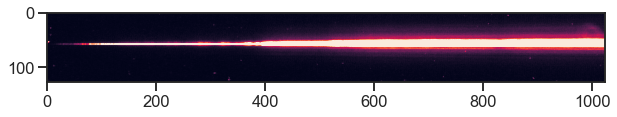

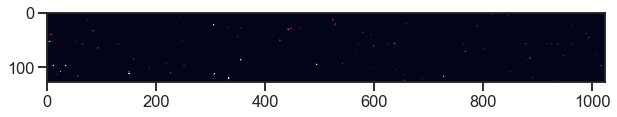

Frame 56


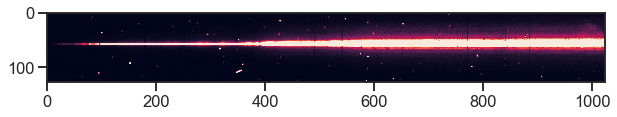

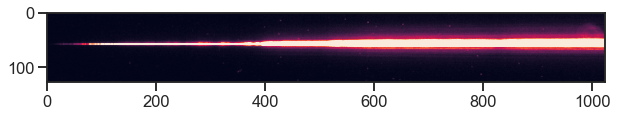

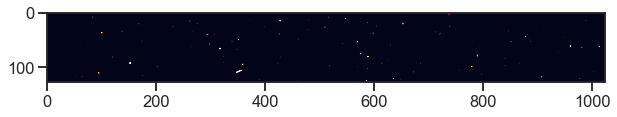

Frame 57


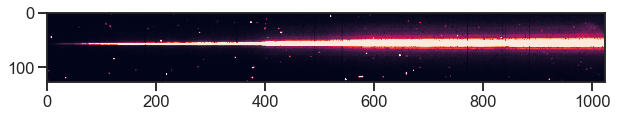

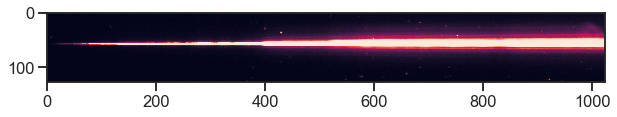

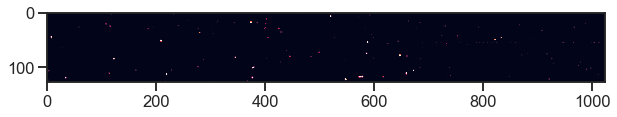

Frame 58


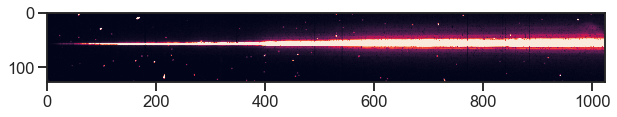

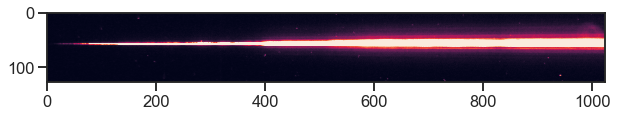

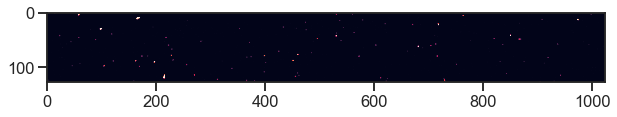

Frame 59


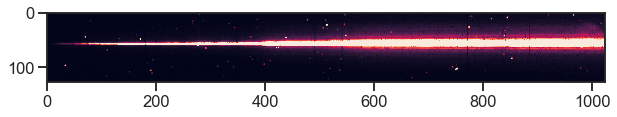

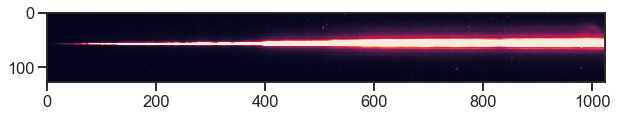

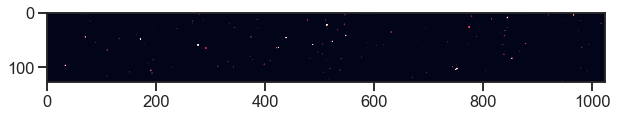

Frame 60


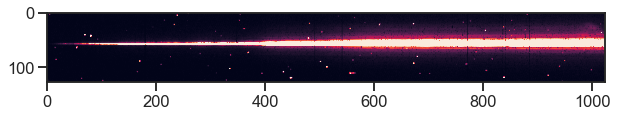

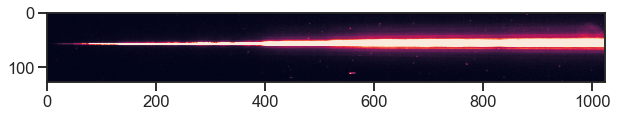

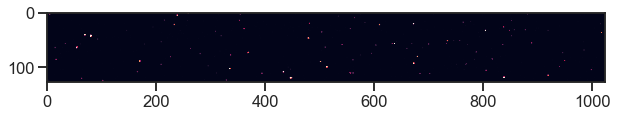

Frame 61


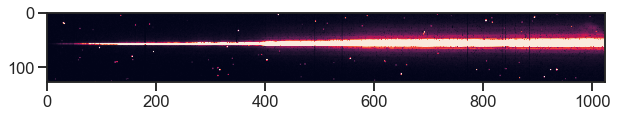

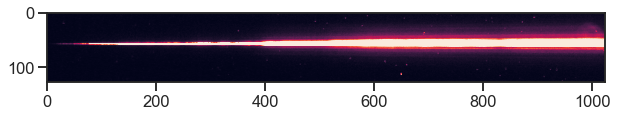

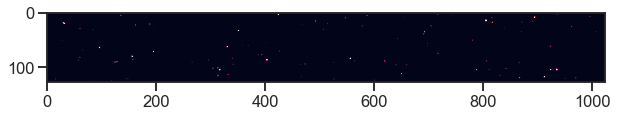

Frame 62


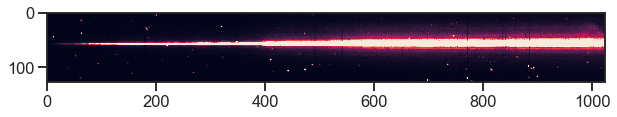

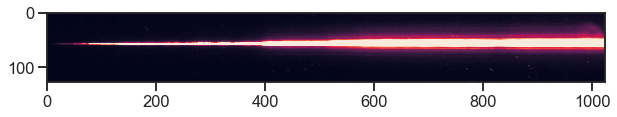

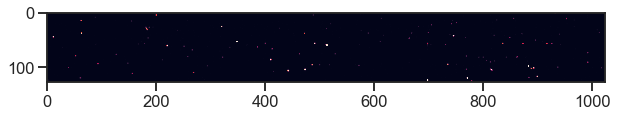

Frame 63


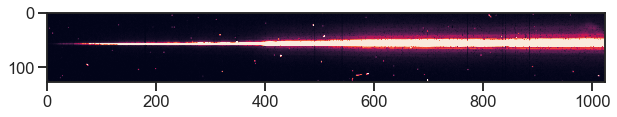

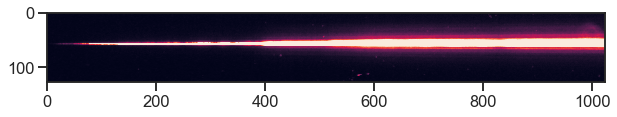

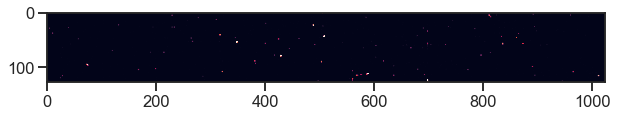

Frame 64


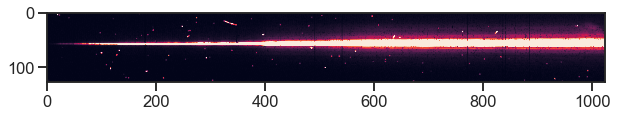

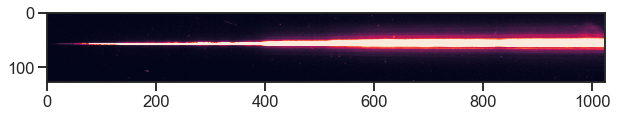

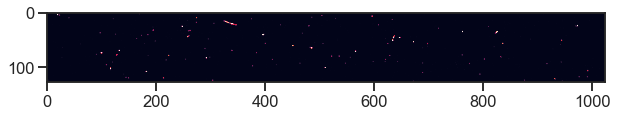

Frame 65


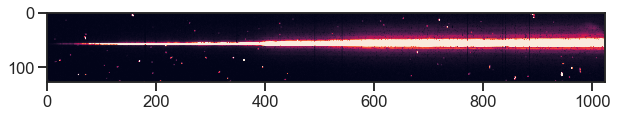

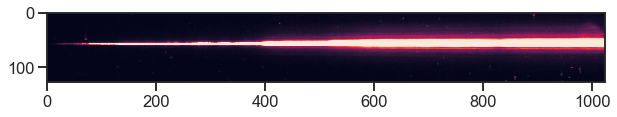

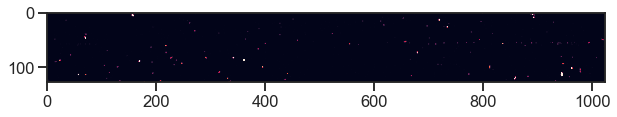

Frame 66


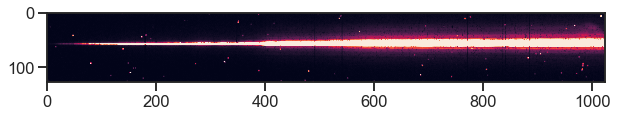

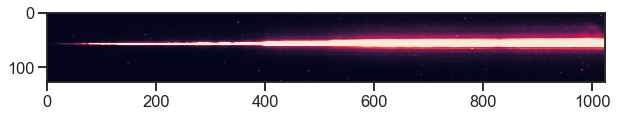

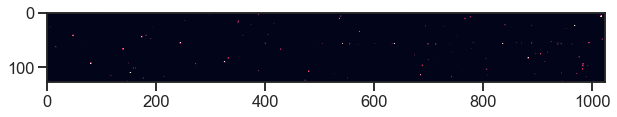

Frame 67


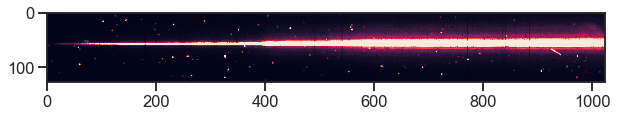

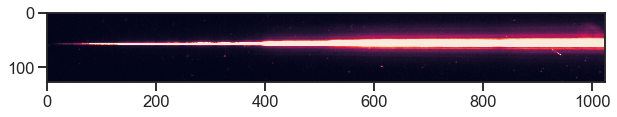

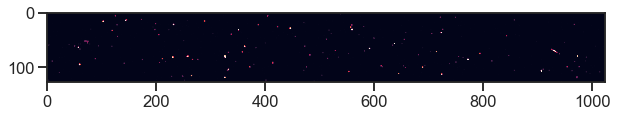

Frame 68


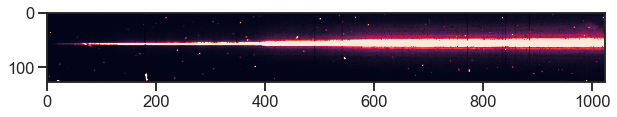

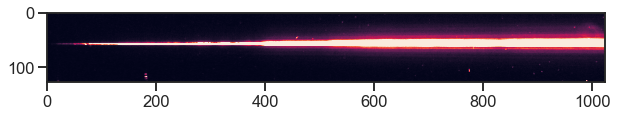

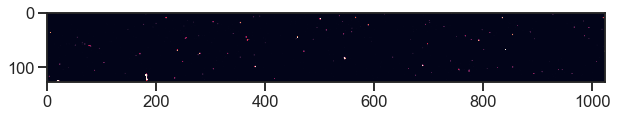

Frame 69


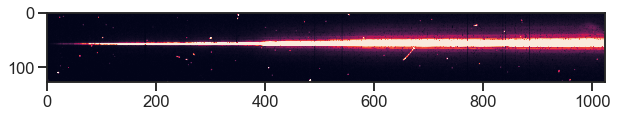

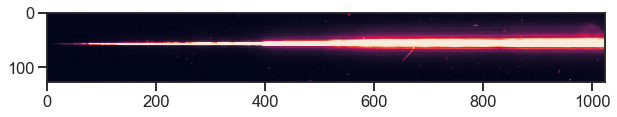

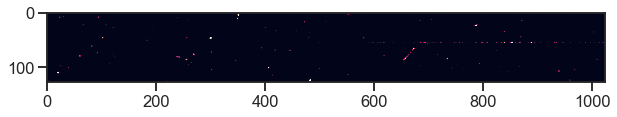

Frame 70


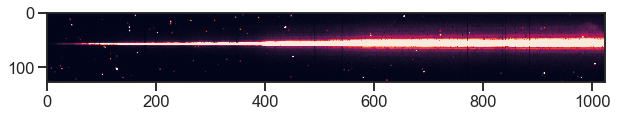

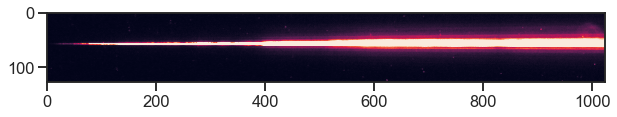

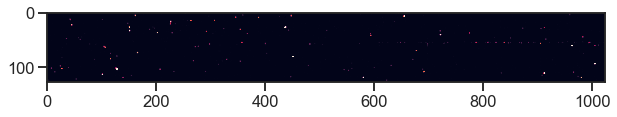

Frame 71


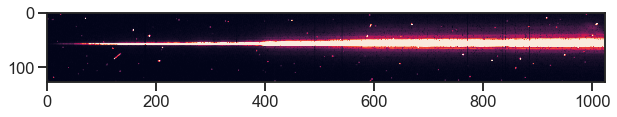

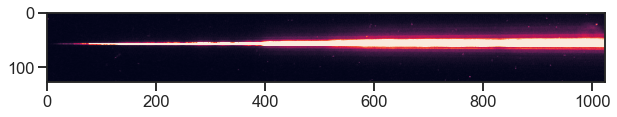

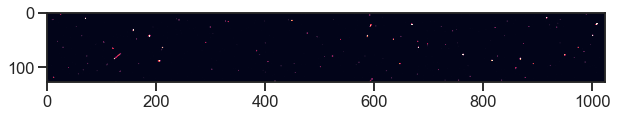

Frame 72


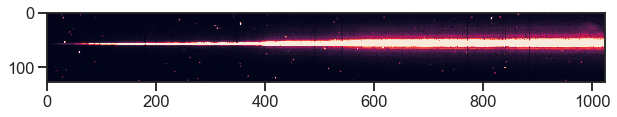

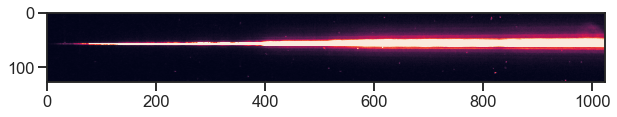

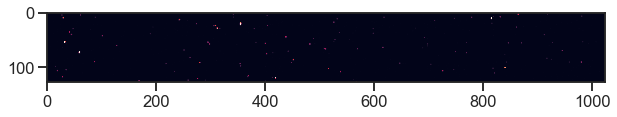

Frame 73


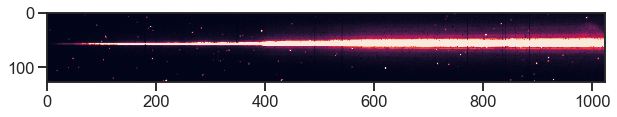

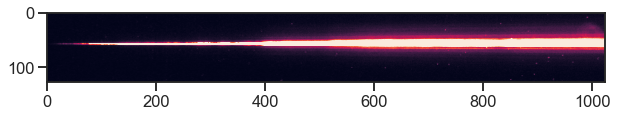

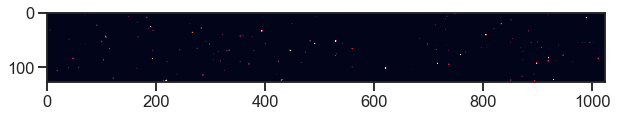

Frame 74


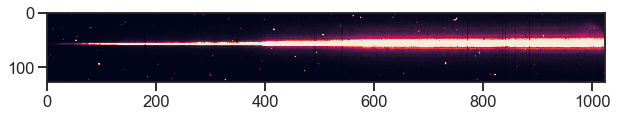

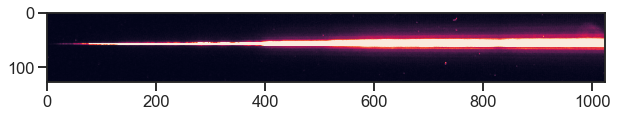

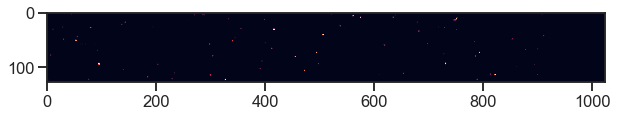

Frame 75


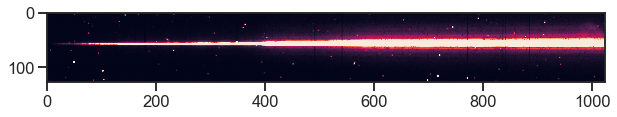

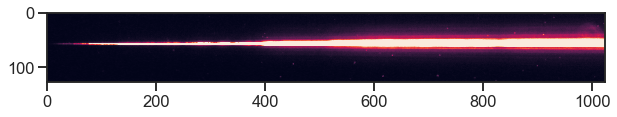

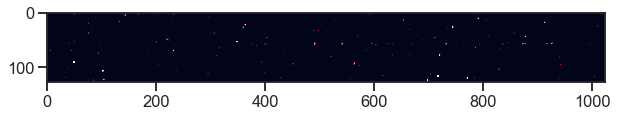

Frame 76


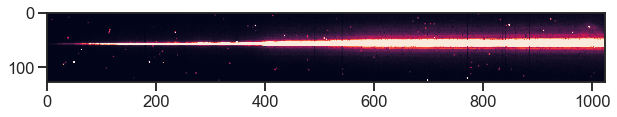

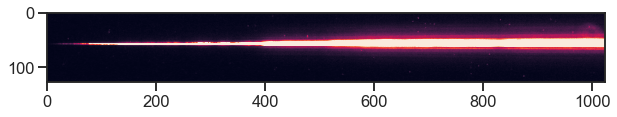

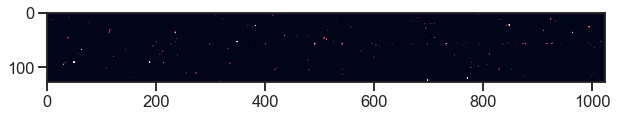

Frame 77


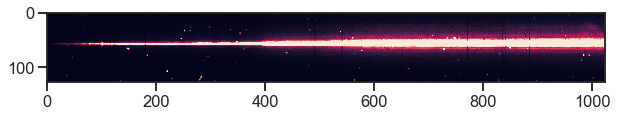

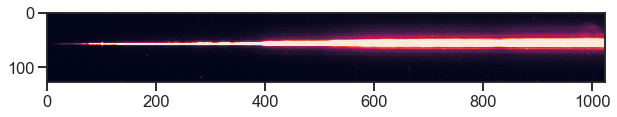

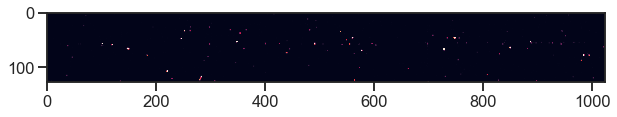

Frame 78


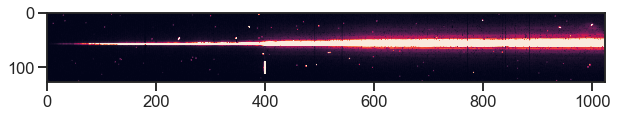

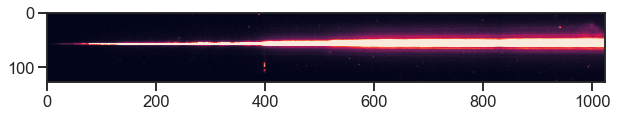

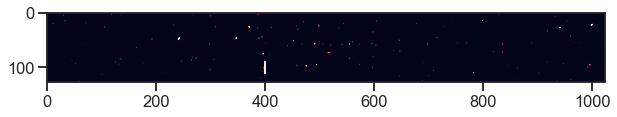

Frame 79


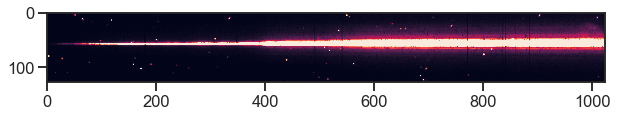

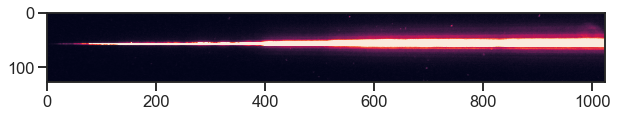

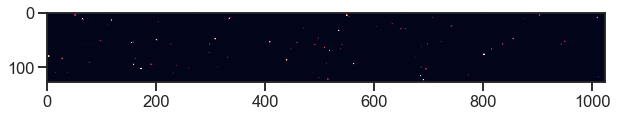

Frame 80


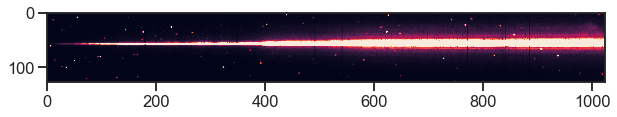

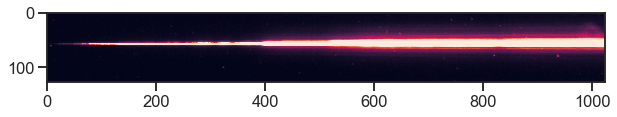

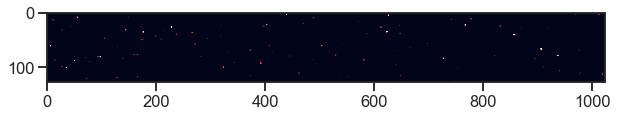

Frame 81


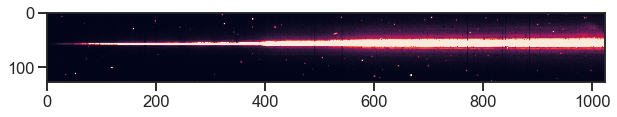

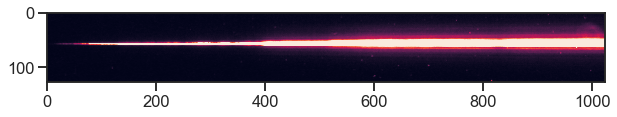

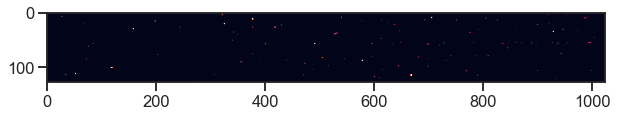

Frame 82


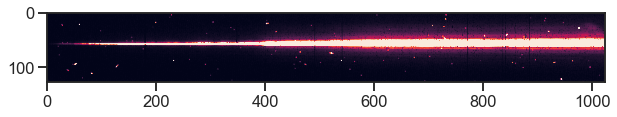

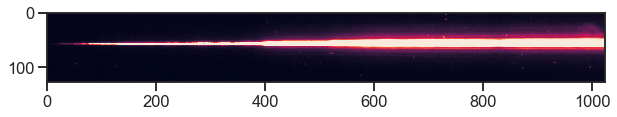

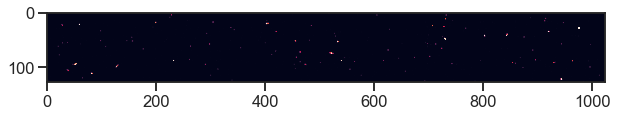

Frame 83


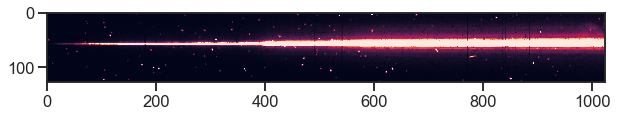

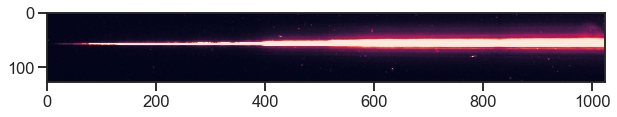

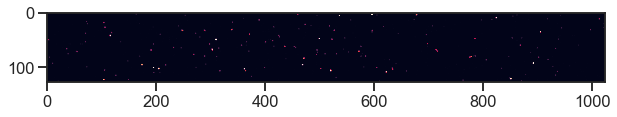

Frame 84


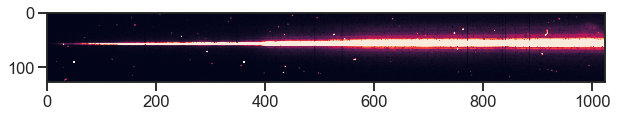

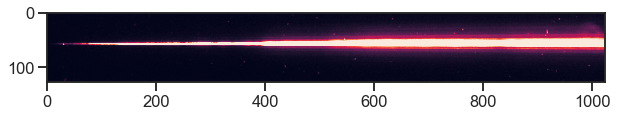

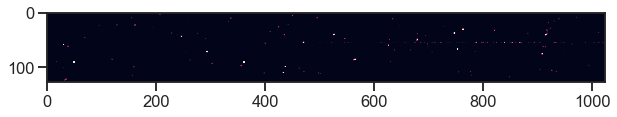

Frame 85


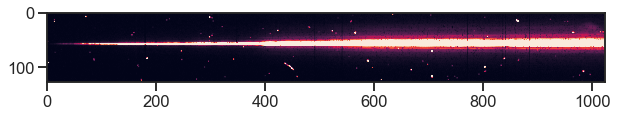

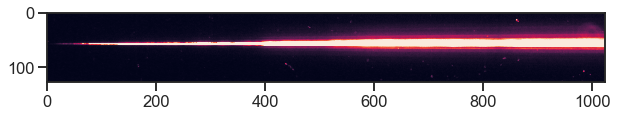

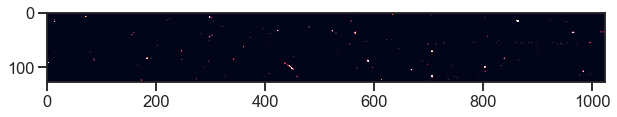

Frame 86


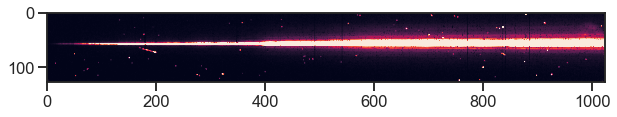

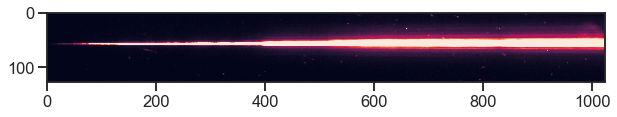

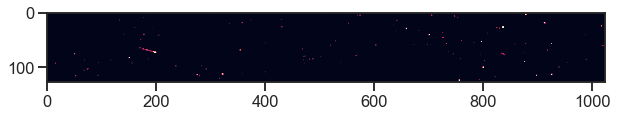

Frame 87


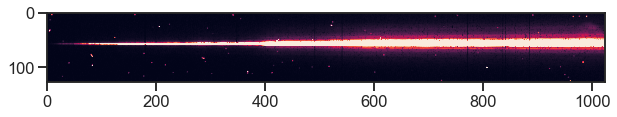

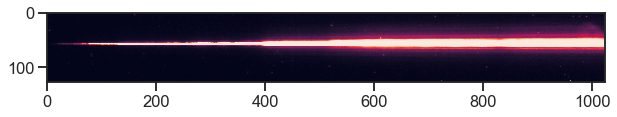

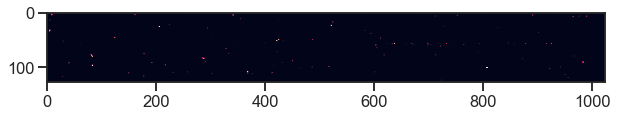

Frame 88


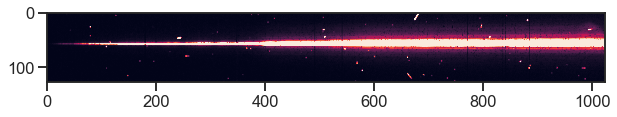

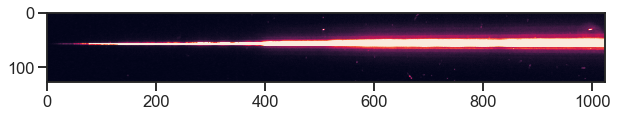

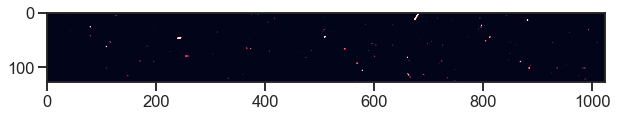

Frame 89


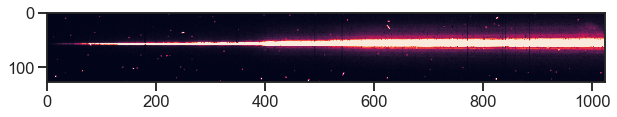

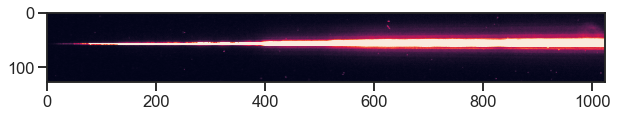

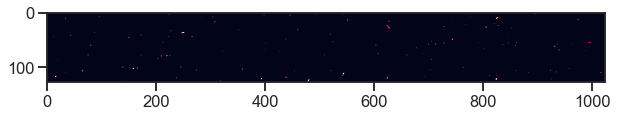

Frame 90


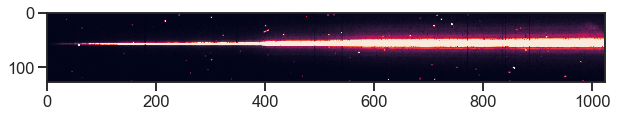

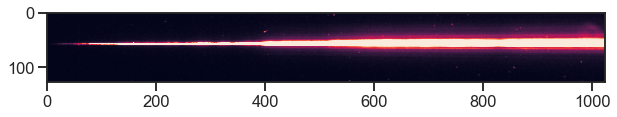

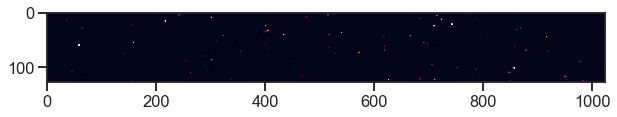

Frame 91


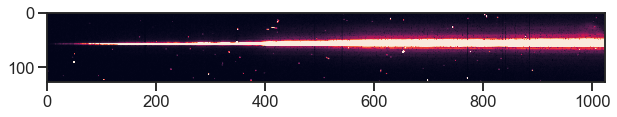

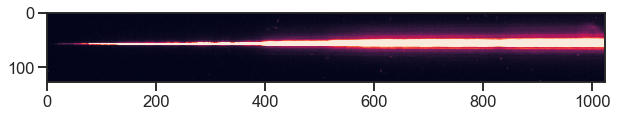

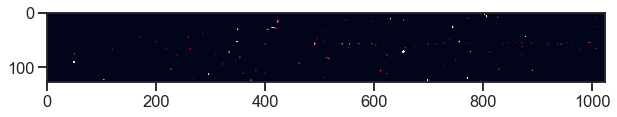

Frame 92


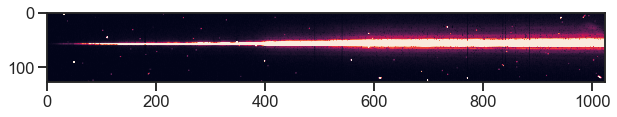

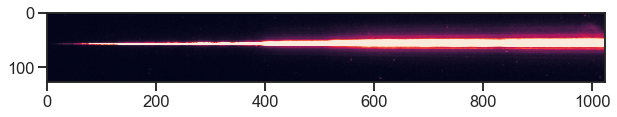

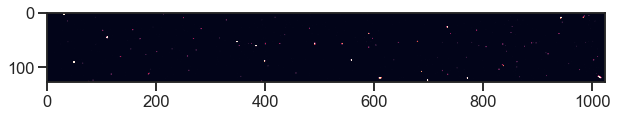

Frame 93


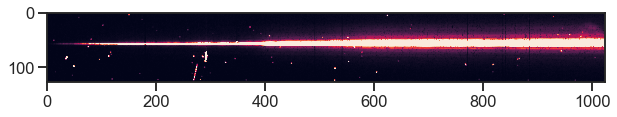

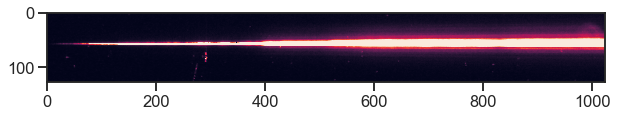

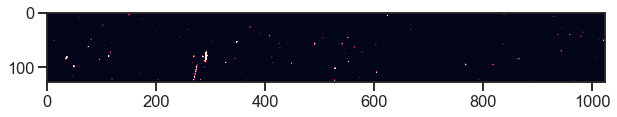

Frame 94


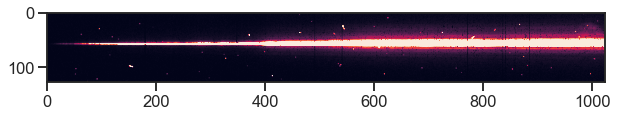

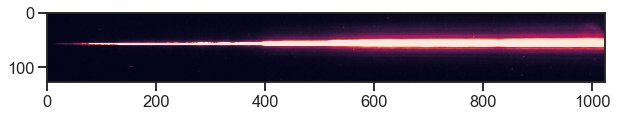

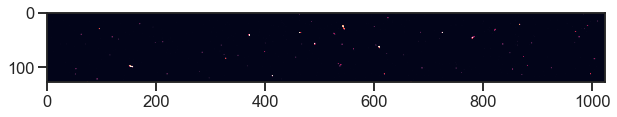

Frame 95


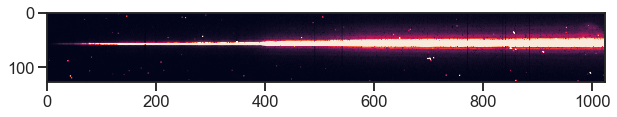

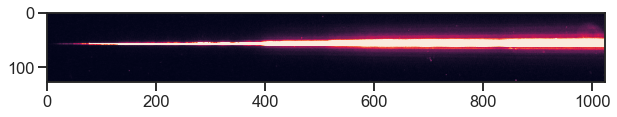

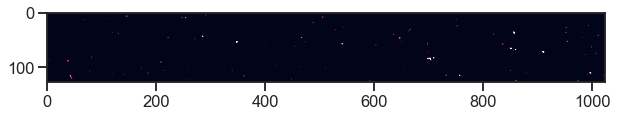

Frame 96


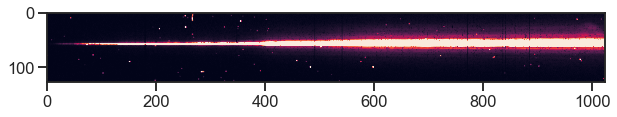

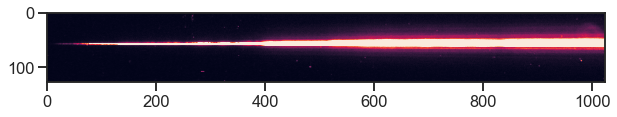

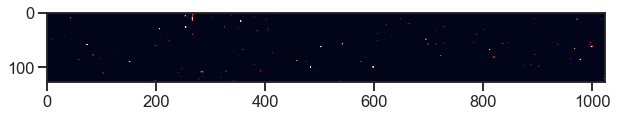

Frame 97


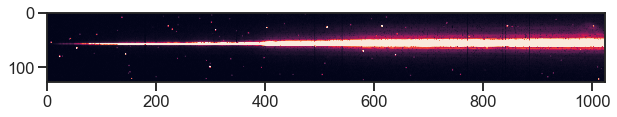

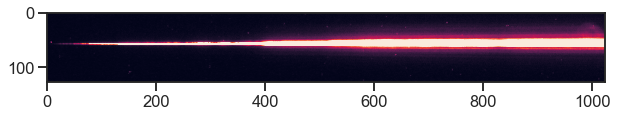

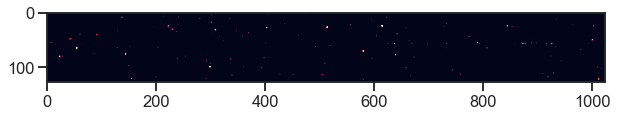

Frame 98


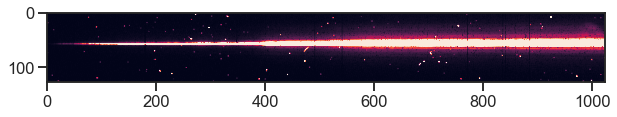

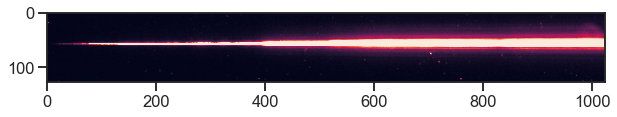

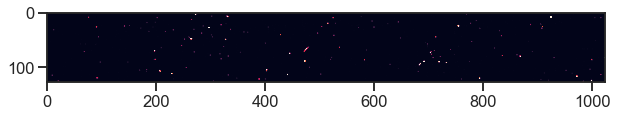

Frame 99


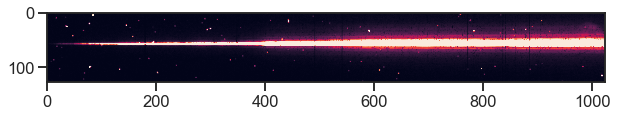

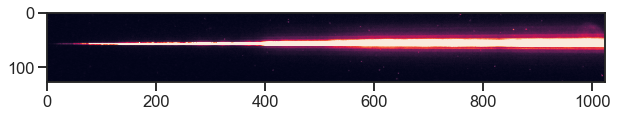

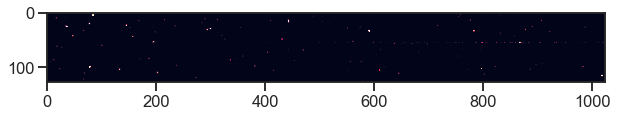

Frame 100


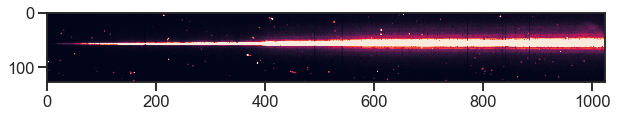

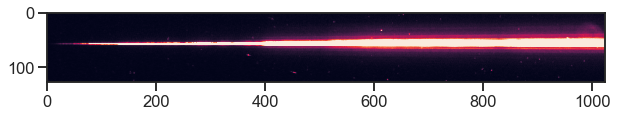

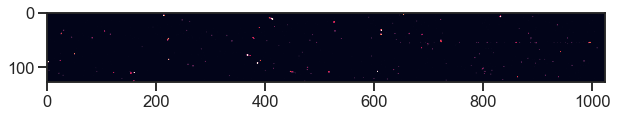

Frame 101


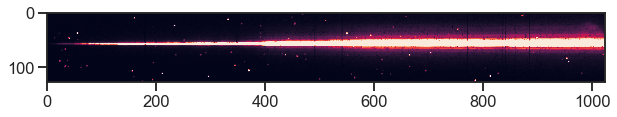

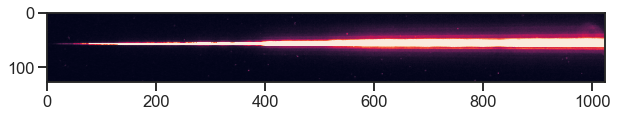

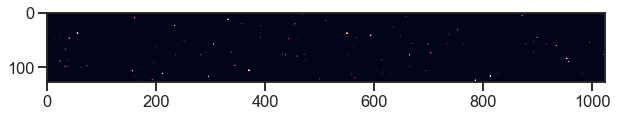

Frame 102


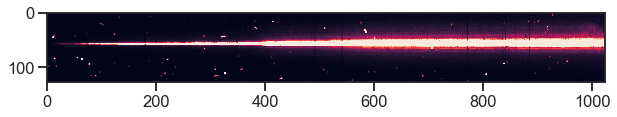

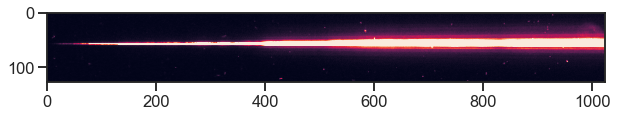

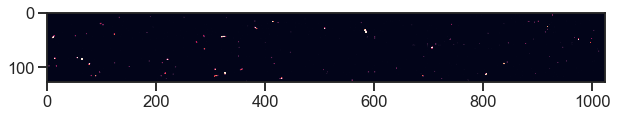

Frame 103


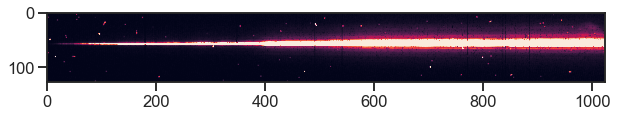

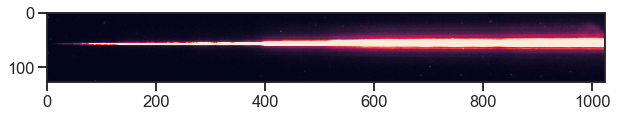

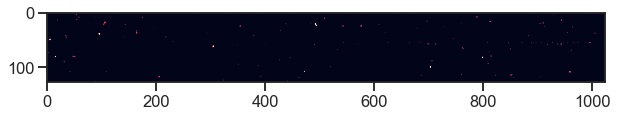

Frame 104


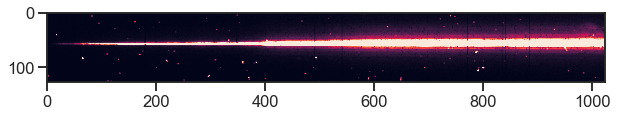

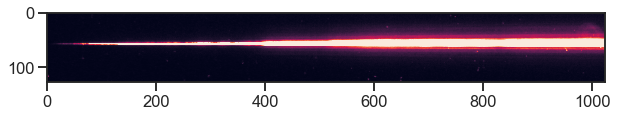

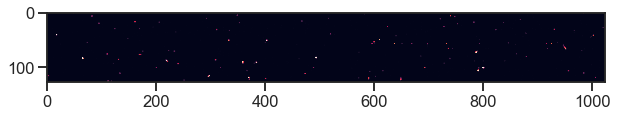

Frame 105


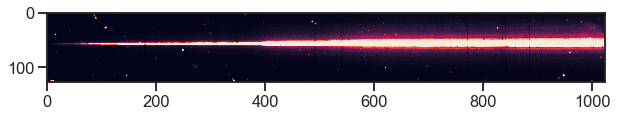

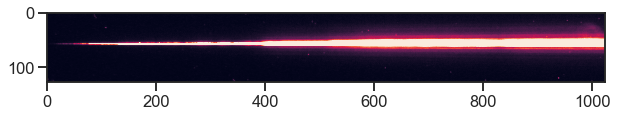

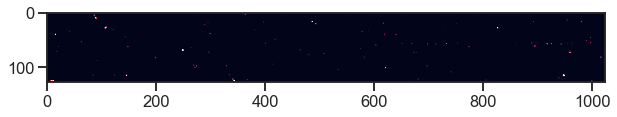

Frame 106


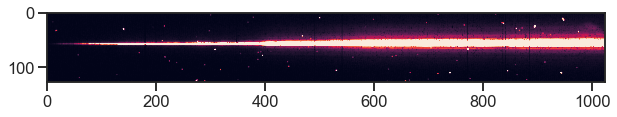

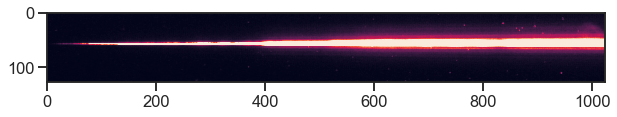

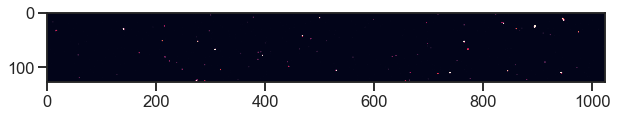

Frame 107


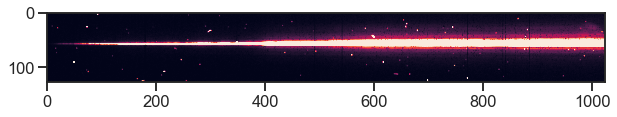

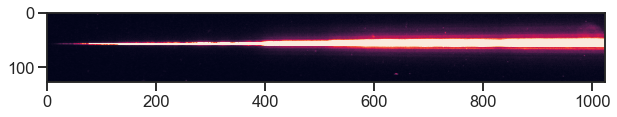

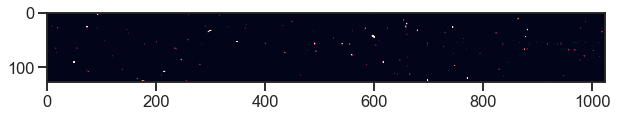

Frame 108


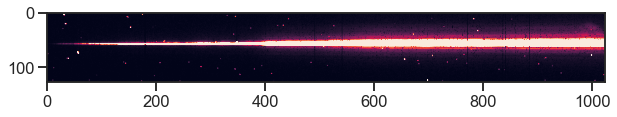

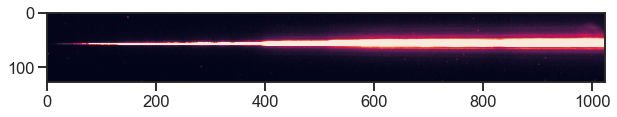

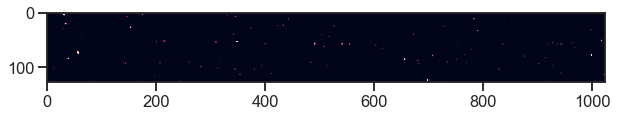

Frame 109


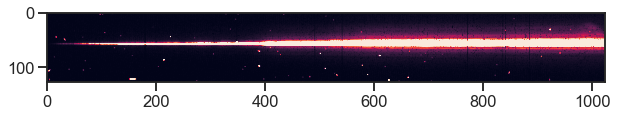

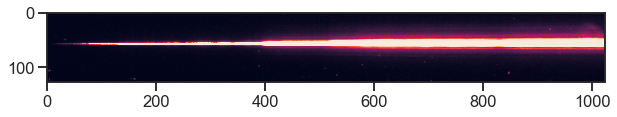

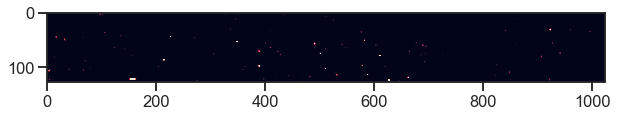

Frame 110


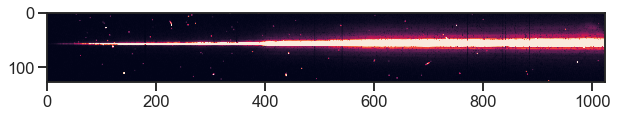

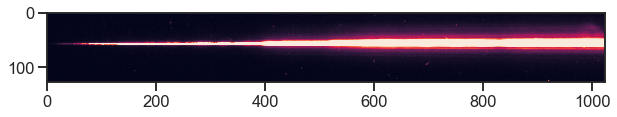

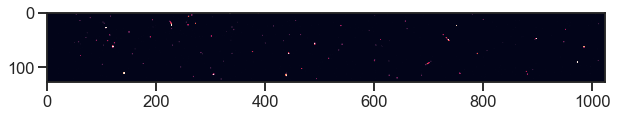

Frame 111


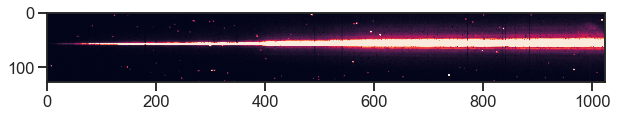

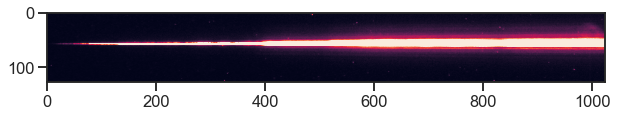

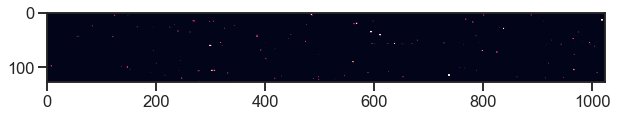

Frame 112


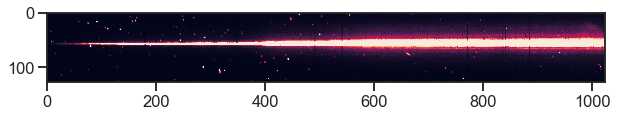

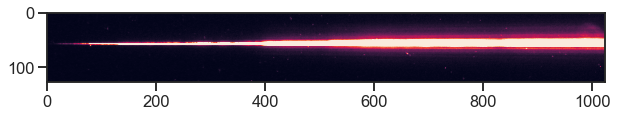

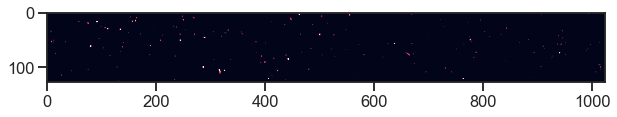

Frame 113


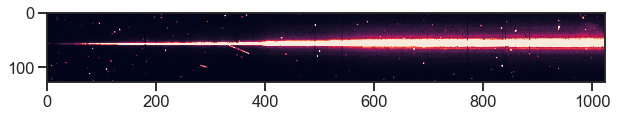

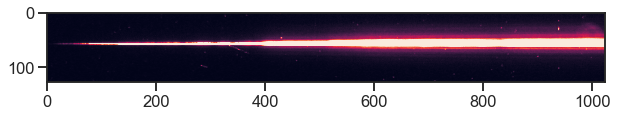

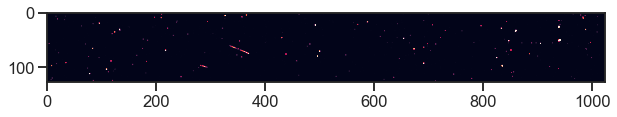

In [16]:
# and the 430 data
transit_430_cleaned_t = transit_430_cleaned + transit_430_2_cleaned

for i in range(len(transit_430_cleaned_t)):
    print("Frame", i)
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_430[0][i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(transit_430_cleaned_t[i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_430[0][i]-transit_430_cleaned_t[i])
    im.set_clim(0,200)
    plt.show()
        

In [19]:
# save all of the cleaned images - doing this manually now, but will implement into the function later
# probably want to save the file names for the used data files to use
name = "cleaned_data_wasp69_nov17"

if os.path.exists(name) != True:
    os.makedirs(name)
for i in range(len(transit_750_cleaned)):
    filename = "cleaned_750_1_" + str(i).zfill(3) + ".fits"
    fits.writeto(name + "/"+filename, transit_750_cleaned[i], data_750[1][i], overwrite=True)
    fits.append(name + "/"+filename, data_750[4][i])
    
for i in range(len(transit_430_cleaned)):
    filename = "cleaned_430_1_" + str(i).zfill(3) + ".fits"
    fits.writeto(name + "/"+filename, transit_430_cleaned[i], data_430[1][i], overwrite=True)
    fits.append(name + "/"+filename, data_430[4][i])
    
for i in range(len(transit_430_2_cleaned)):
    filename = "cleaned_430_2_" + str(i).zfill(3) + ".fits"
    fits.writeto(name + "/"+filename, transit_430_2_cleaned[i], data_430[1][57+i], overwrite=True)
    fits.append(name + "/"+filename, data_430[4][57+i])


In [20]:
# and then just write the jitter dictionary to a pickle file for later use
with open('jitter_750.pkl', 'wb') as handle:
    pickle.dump(data_750[2], handle, protocol=pickle.HIGHEST_PROTOCOL)

with open('jitter_430.pkl', 'wb') as handle:
    pickle.dump(data_430[2], handle, protocol=pickle.HIGHEST_PROTOCOL)

In [2]:
# now that we have the cleaned files, we don't need to run any of the above code a second time
# read those files in to have this as a new starting point
name = "cleaned_data_wasp69_nov17"

cleaned_data_430_1 = sorted(glob.glob(name + "/cleaned_430_1*"))
transit_430_cleaned = []
headers_430 = []
errs_430 = []
for i in cleaned_data_430_1:
    c_data, hdr = fits.getdata(i, ext = 0, header = True)
    transit_430_cleaned.append(c_data)
    headers_430.append(hdr)
    e_data = fits.getdata(i, ext = 1)
    errs_430.append(e_data)
    
cleaned_data_430_2 = sorted(glob.glob(name + "/cleaned_430_2*"))
transit_430_2_cleaned = []
headers_430_2 = []
errs_430_2 = []
for i in cleaned_data_430_2:
    c_data, hdr = fits.getdata(i, ext = 0, header = True)
    transit_430_2_cleaned.append(c_data)
    headers_430_2.append(hdr)
    e_data = fits.getdata(i, ext = 1)
    errs_430_2.append(e_data)

with open('jitter_430.pkl', 'rb') as handle:
    jit_430 = pickle.load(handle)

In [3]:
cleaned_data_750 = sorted(glob.glob(name + "/cleaned_750*"))
transit_750_cleaned = []
headers_750 = []
errs_750 = []
for i in cleaned_data_750:
    c_data, hdr = fits.getdata(i, ext = 0, header = True)
    transit_750_cleaned.append(c_data)
    headers_750.append(hdr)
    e_data = fits.getdata(i, ext = 1)
    errs_750.append(e_data)

with open('jitter_750.pkl', 'rb') as handle:
    jit_750 = pickle.load(handle)

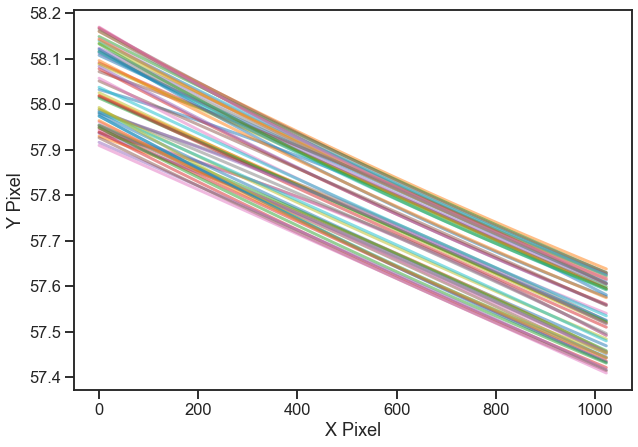

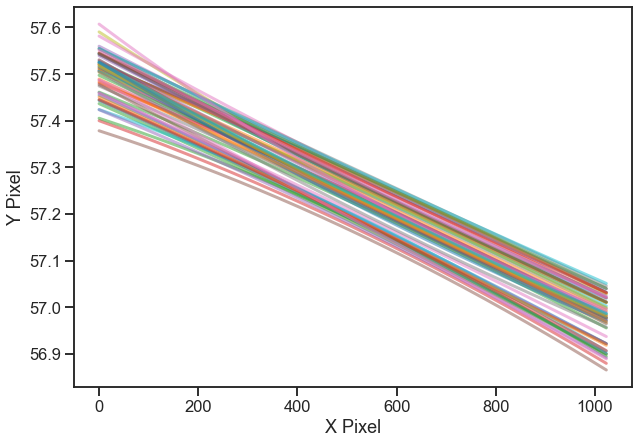

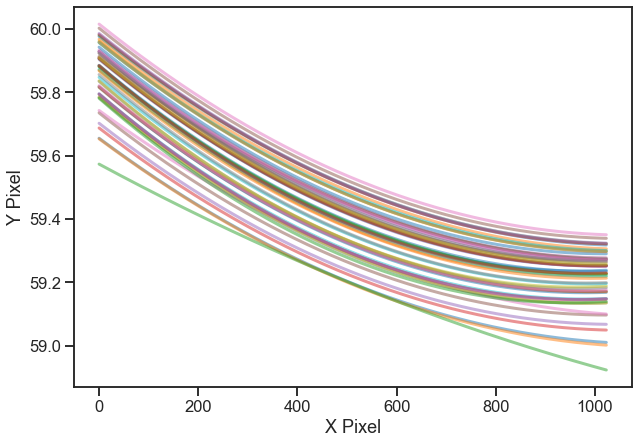

In [4]:
# now to retrace the cleaned data
trace_430_list = []
plt.figure(figsize = (10,7))
for i in transit_430_cleaned:
    trace = trace_spectrum(i, 200,1000,60)
    trace_430_list.append(trace)

trace_430_coeffs = []
trace_430_fit = []
for j in trace_430_list:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    plt.plot(np.arange(len(transit_430_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_cleaned[0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(transit_430_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_cleaned[0][0])),coeffs1)]
    trace_430_fit.append(trace)
    trace_430_coeffs.append(coeffs1)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

trace_430_2_list = []
plt.figure(figsize = (10,7))
for i in transit_430_2_cleaned:
    trace = trace_spectrum(i, 200,1000,60)
    trace_430_2_list.append(trace)

trace_430_2_coeffs = []
trace_430_2_fit = []
for j in trace_430_2_list:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    plt.plot(np.arange(len(transit_430_2_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_2_cleaned[0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(transit_430_2_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_2_cleaned[0][0])),coeffs1)]
    trace_430_2_fit.append(trace)
    trace_430_2_coeffs.append(coeffs1)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

trace_750_list = []
plt.figure(figsize = (10,7))
for i in transit_750_cleaned:
    trace = trace_spectrum(i, 200,1000,60)
    trace_750_list.append(trace)

trace_750_coeffs = []
trace_750_fit = []
for j in trace_750_list:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    plt.plot(np.arange(len(transit_750_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_750_cleaned[0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(transit_750_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_750_cleaned[0][0])),coeffs1)]
    trace_750_fit.append(trace)
    trace_750_coeffs.append(coeffs1)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()


In [5]:
# now for the spectral extraction - I use optimal since I don't do the spline cleaning, and I feed in the ron and 
# gain values from the header
spectra_430 = []
for i in range(len(transit_430_cleaned)):
    spec = spectral_extraction(transit_430_cleaned[i], trace_430_fit[i], method = "optimal", gain = 4.0159998, ron = 8.2327986, polynomial_order = 3, nsigma = 12)
    spectra_430.append(spec)

In [6]:
spectra_430_2 = []
for i in range(len(transit_430_2_cleaned)):
    spec = spectral_extraction(transit_430_2_cleaned[i], trace_430_2_fit[i], method = "optimal", gain = 4.0159998, ron = 8.2327986, polynomial_order = 3, nsigma = 12)
    spectra_430_2.append(spec)

In [7]:
spectra_750 = []
for i in range(len(transit_750_cleaned)):
    spec = spectral_extraction(transit_750_cleaned[i], trace_750_fit[i], method = "optimal", gain = 4.0159998, ron = 8.2327986, polynomial_order = 3, nsigma = 12)
    spectra_750.append(spec)

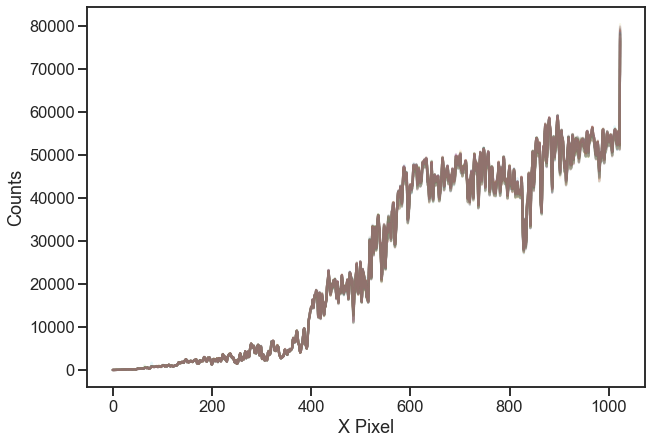

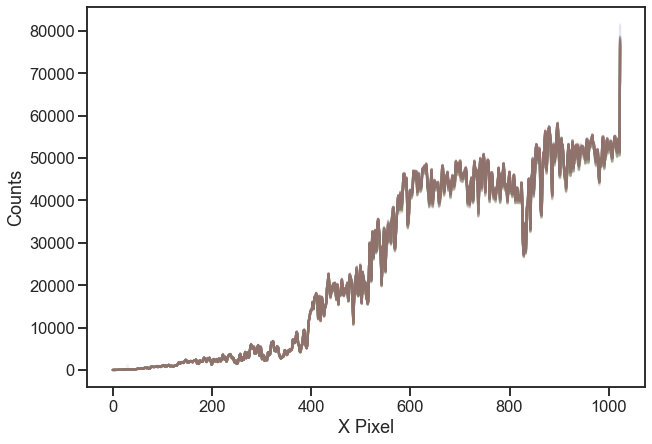

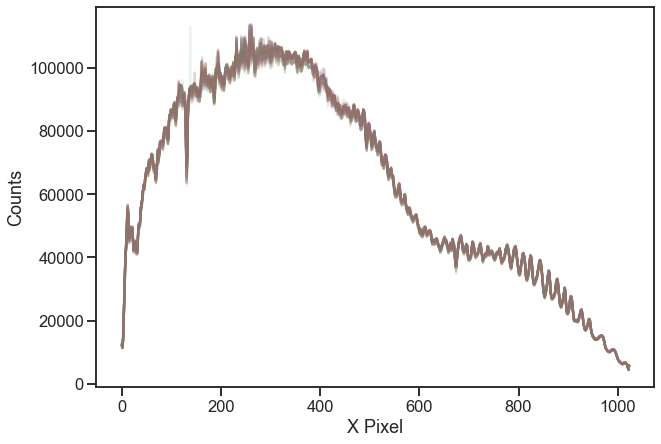

In [8]:
%matplotlib inline
# plot all of the spectra on top of each other
plt.figure(figsize = (10,7))
for i in spectra_430:
    plt.plot(i[1], alpha = 0.1)
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_430_2:
    plt.plot(i[1], alpha = 0.1)
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_750:
    plt.plot(i[1], alpha = 0.1)
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.show()

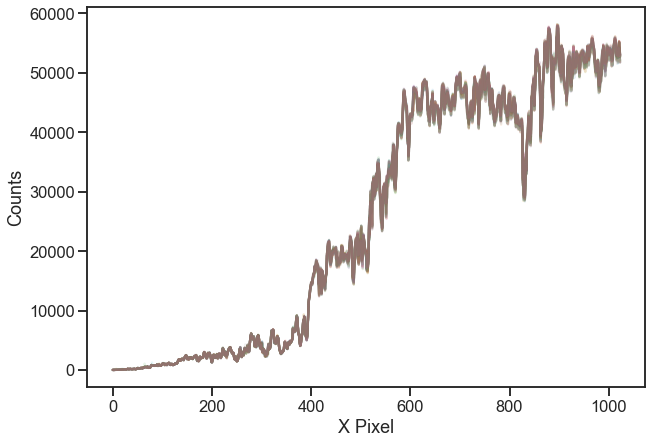

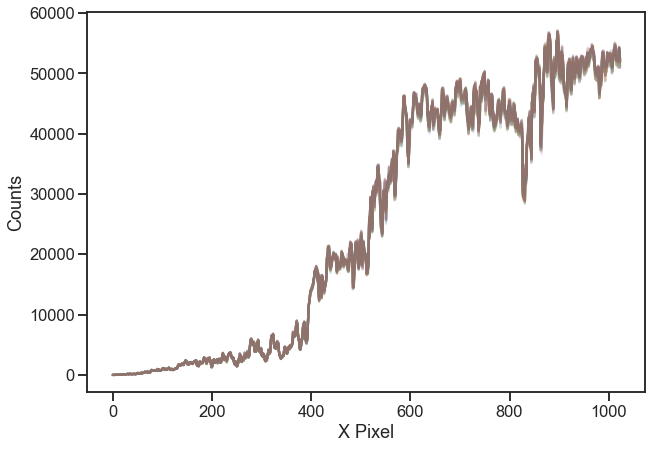

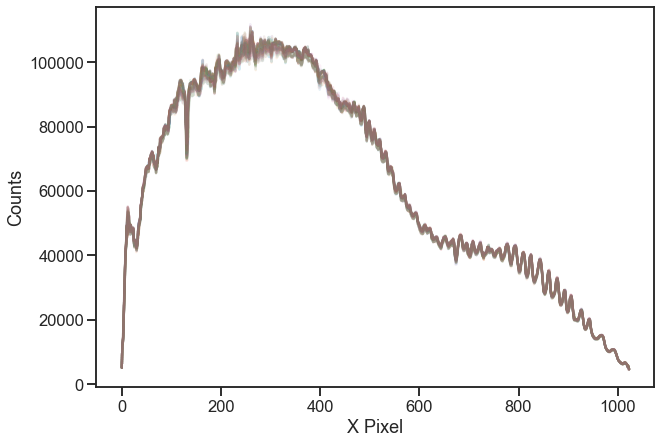

In [9]:
# hm, there's maybe a few outliers, so let's just try to get rid of some of those using a basic median filter function
spectra_430 = spectrum_outliers(spectra_430)
spectra_430_2 = spectrum_outliers(spectra_430_2)
spectra_750 = spectrum_outliers(spectra_750)

plt.figure(figsize = (10,7))
for i in spectra_430:
    plt.plot(i[1], alpha = 0.1)
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_430_2:
    plt.plot(i[1], alpha = 0.1)
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_750:
    plt.plot(i[1], alpha = 0.1)
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.show()

In [10]:
# sum up each of the spectra for the white light curve
lc_430 = []
lc_err_430 = []
for i in spectra_430:
    point = np.nansum(i[1])
    # i assume error prop is just like sqrt(sum of squares of errors)
    # optimal extraction outputs inverse variance, so assume np.sqrt(np.nansum((1/np.sqrt(i[2]))**2)) 
    # is the error on each point
    err = np.sqrt(np.nansum((1/np.sqrt(i[2]))**2))
    lc_430.append(point)
    lc_err_430.append(err)
    
lc_430_2 = []
lc_err_430_2 = []
for i in spectra_430_2:
    point = np.nansum(i[1])
    err = np.sqrt(np.nansum((1/np.sqrt(i[2]))**2))
    lc_430_2.append(point)
    lc_err_430_2.append(err)
    
lc_750 = []
lc_err_750 = []
for i in spectra_750:
    point = np.nansum(i[1])
    err = np.sqrt(np.nansum((1/np.sqrt(i[2]))**2))
    lc_750.append(point)
    lc_err_750.append(err)

In [11]:
# now to deal with the timestamps. HST header times come in JDUTC, we want BJD-TBD 
times_430 = times_to_bjd(headers_430, starname = "WASP-69")
times_start_430 = times_430[0][0]
times_end_430 = times_430[0][1]

times_430_2 = times_to_bjd(headers_430_2, starname = "WASP-69")
times_start_430_2 = times_430_2[0][0]
times_end_430_2 = times_430_2[0][1]

times_750 = times_to_bjd(headers_750, starname = "WASP-69")
times_start_750 = times_750[0][0]
times_end_750 = times_750[0][1]

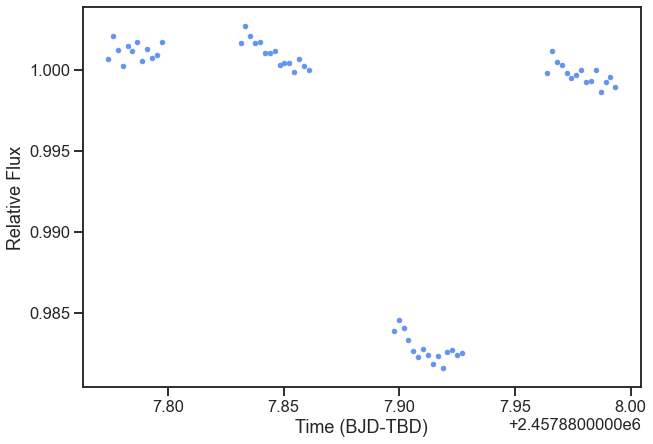

In [12]:
# should now be able to plot our raw white light curve - looks pretty good!
plt.figure(figsize = (10,7))
plt.errorbar(times_start_430, lc_430/np.nanmedian(lc_430), yerr = lc_err_430/np.nanmedian(lc_430), fmt = ".", color = "cornflowerblue", label = "var")
plt.xlabel("Time (BJD-TBD)")
plt.ylabel("Relative Flux")
#plt.ylim(0.95, 1.01)
plt.show()

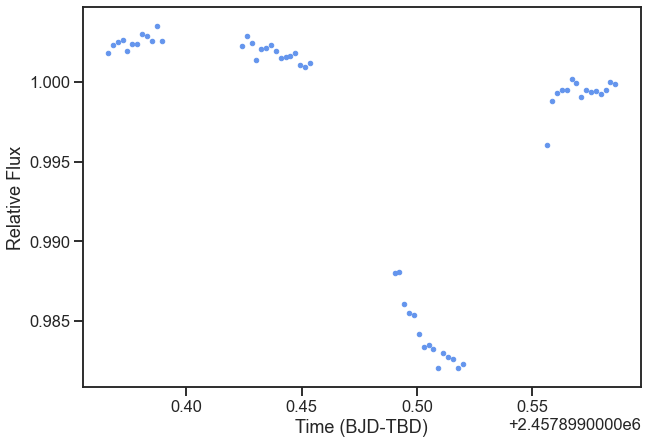

In [13]:
plt.figure(figsize = (10,7))
plt.errorbar(times_start_430_2, lc_430_2/np.nanmedian(lc_430_2), yerr = lc_err_430_2/np.nanmedian(lc_430_2), fmt = ".", color = "cornflowerblue", label = "var")
plt.xlabel("Time (BJD-TBD)")
plt.ylabel("Relative Flux")
#plt.ylim(0.95, 1.01)
plt.show()

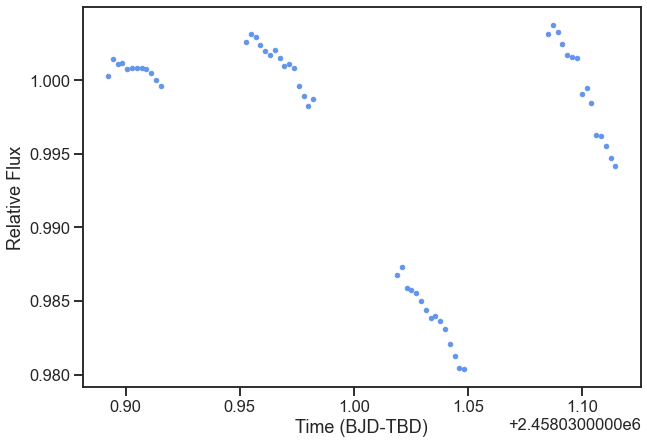

In [14]:
plt.figure(figsize = (10,7))
plt.errorbar(times_start_750, lc_750/np.nanmedian(lc_750), yerr = lc_err_750/np.nanmedian(lc_750), fmt = ".", color = "cornflowerblue", label = "var")
plt.xlabel("Time (BJD-TBD)")
plt.ylabel("Relative Flux")
#plt.ylim(0.95, 1.01)
plt.show()

In [15]:
# calculate trace polynomial movement - another detrending vector
template_430 = np.nanmedian(trace_430_coeffs, axis = 0)
movement_430 = []
movement_coeff1_430 = []
movement_coeff2_430 = []
for i in trace_430_coeffs:
    #plt.plot(template_430-i)
    #movement_430.append(np.nanmedian(template_430-i[1]))
    movement_430.append((template_430-i)[0])
    movement_coeff1_430.append((template_430-i)[1])
    movement_coeff2_430.append((template_430-i)[2])
    
#jit_430["Y"] = movement_430

template_430_2 = np.nanmedian(trace_430_2_coeffs, axis = 0)
movement_430_2 = []
movement_coeff1_430_2 = []
movement_coeff2_430_2 = []
for i in trace_430_2_coeffs:
    #plt.plot(template_430-i)
    #movement_430.append(np.nanmedian(template_430-i[1]))
    movement_430_2.append((template_430-i)[0])
    movement_coeff1_430_2.append((template_430-i)[1])
    movement_coeff2_430_2.append((template_430-i)[2])

#jit_430["Y"] = movement_430 + movement_430_2
jit_430["T_move"] = movement_430 + movement_430_2
jit_430["T_coeff1"] = movement_coeff1_430 + movement_coeff1_430_2
jit_430["T_coeff2"] = movement_coeff2_430 + movement_coeff2_430_2

In [16]:
template_750 = np.nanmedian(trace_750_coeffs, axis = 0)
movement_750 = []
movement_coeff1_750 = []
movement_coeff2_750 = []
for i in trace_750_coeffs:
    #plt.plot(template_430-i)
    #movement_430.append(np.nanmedian(template_430-i[1]))
    movement_750.append((template_750-i)[0])
    movement_coeff1_750.append((template_750-i)[1])
    movement_coeff2_750.append((template_750-i)[2])
#jit_750["Y"] = movement_750
jit_750["T_move"] = movement_750
jit_750["T_coeff1"] = movement_coeff1_750
jit_750["T_coeff2"] = movement_coeff2_750

In [17]:
# before fitting, we just need to normalize our jitter vectors into standard deviation
# these are the detrending vectors to use
jit_use = ["V2_roll", "V3_roll", "Latitude", "Longitude", "RA", "DEC", "T_move", "T_coeff1", "T_coeff2"]

norm_jit_750 = {}
for i in jit_use:
    norm = (jit_750[i]/np.nanmean(jit_750[i]))-1
    norm_jit_750[i] = norm/np.std(norm)

In [18]:
jit_use = ["V2_roll", "V3_roll", "Latitude", "Longitude", "RA", "DEC", "T_move", "T_coeff1", "T_coeff2"]
norm_jit_430 = {}
for i in jit_use:
    norm = (jit_430[i][:57]/np.nanmean(jit_430[i][:57]))-1
    norm_jit_430[i] = norm/np.std(norm)
    
norm_jit_430_2 = {}
for i in jit_use:
    norm = (jit_430[i][57:]/np.nanmean(jit_430[i][57:]))-1
    norm_jit_430_2[i] = norm/np.std(norm)

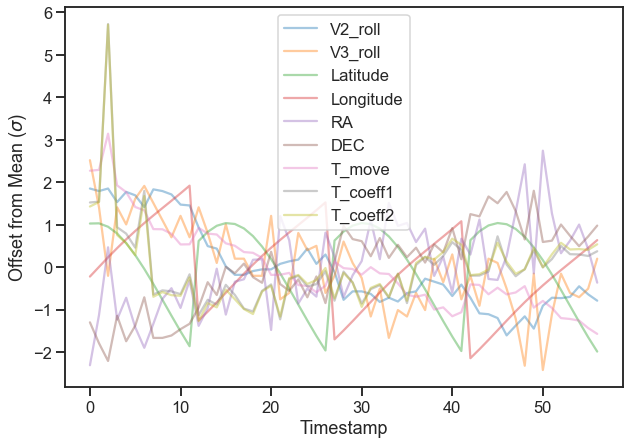

In [19]:
# check them out 
plt.figure(figsize = (10,7))
for i in norm_jit_750:
    plt.plot(norm_jit_750[i], alpha = 0.4, label = str(i))
plt.xlabel("Timestamp")
plt.ylabel(r"Offset from Mean ($\sigma$)")
plt.legend()
plt.show()

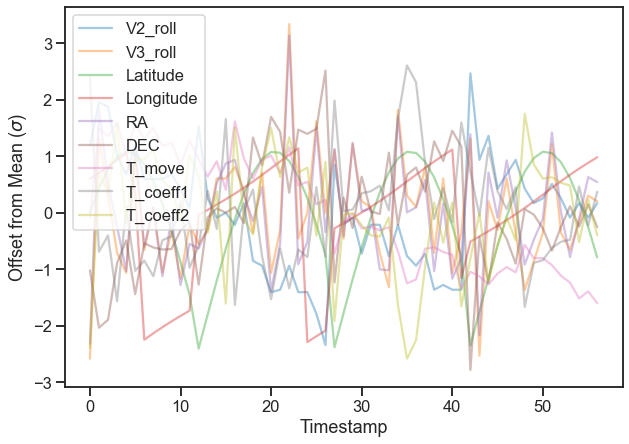

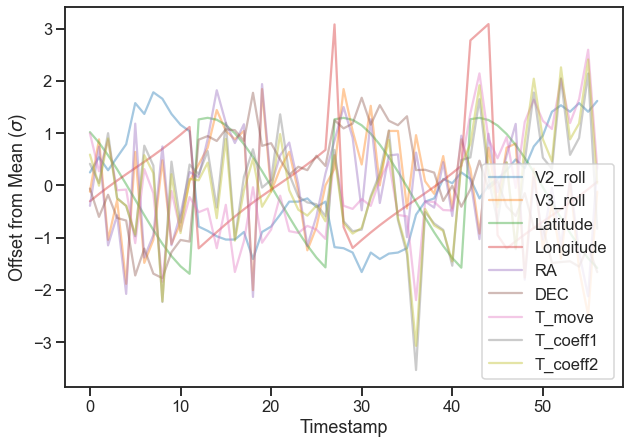

In [20]:
plt.figure(figsize = (10,7))
for i in norm_jit_430:
    plt.plot(norm_jit_430[i], alpha = 0.4, label = str(i))
plt.xlabel("Timestamp")
plt.ylabel(r"Offset from Mean ($\sigma$)")
plt.legend()
plt.show()

plt.figure(figsize = (10,7))
for i in norm_jit_430_2:
    plt.plot(norm_jit_430_2[i], alpha = 0.4, label = str(i))
plt.xlabel("Timestamp")
plt.ylabel(r"Offset from Mean ($\sigma$)")
plt.legend()
plt.show()

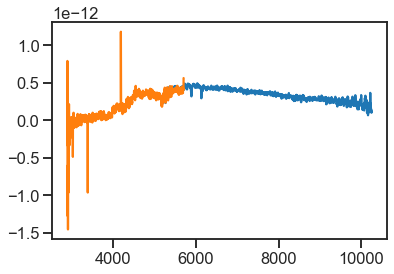

In [21]:
# next, we get the wavelength solution (even though we don't necessarily need it for the white light
# we do need it for the limb darkening coefficients)
wl_sol_750 = fits.getdata("wasp-69/HST/G750L/od9m39030/od9m39030_x1d.fits", ext = 1)
for i, order_750 in enumerate(wl_sol_750):
    plt.plot(order_750["WAVELENGTH"], order_750["FLUX"])
    
wl_sol_430 = fits.getdata("wasp-69/HST/G430L/od9m38010/od9m38010_x1d.fits", ext = 1)
for i, order_430 in enumerate(wl_sol_430):
    plt.plot(order_430["WAVELENGTH"], order_430["FLUX"])

In [22]:
# we're going to fix limb darkening for now
# u1 = 2*sqrt(q1)*q2, u2 = sqrt(q1)*(1-2*q2) or q1 = (u1+u2)^2, q2 = u1/(2*(u1+u2)). 

from exotic_ld import StellarLimbDarkening

sld = StellarLimbDarkening(
            M_H=0.15, Teff=4700, logg=4.5, ld_model='1D',
            ld_data_path="/Users/natalieallen/Documents/Grad/Sing Research/exotic-ld_data")

c1_430, c2_430 = sld.compute_quadratic_ld_coeffs(
            wavelength_range=np.array([order_430["WAVELENGTH"][0], order_430["WAVELENGTH"][-1]]),
            mode='HST_STIS_G430L')

c1_750, c2_750 = sld.compute_quadratic_ld_coeffs(
            wavelength_range=np.array([order_750["WAVELENGTH"][0], order_750["WAVELENGTH"][-1]]),
            mode='HST_STIS_G750L')

In [23]:
# to read into the white_light_fit functions, just need to create a dictionary like this - 
# put just the value if it should be fixed, and the value and range in a list if it should be fit
params_430 = {"P": [3.8681390],"t0": [2457176.17789, 0.1], "p": [0.13, 0.05], "b": [0.686], "a": [12.0], "ecc": [0], "omega": [90], "c1": [c1_430], "c2": [c2_430]}

In [24]:
params_750 = {"P": [3.8681390],"t0": [2457176.17789, 0.1], "p": [0.13, 0.05], "b": [0.686], "a": [12.0], "ecc": [0], "omega": [90], "c1": [c1_750], "c2": [c2_750]}

In [25]:
# now for a bunch of light curve fitting
# to quickly describe, there are three main "options" for different fitting methods
# there is a gp detrending method (using juliet), and two jitter detrending methods - one using juliet,
# and another just using a quick LM fit function (mostly just for test purposes)
# the juliet fits can use any of the available samplers, although right now I only have the default pymultinest and
# dynesty set up

# first, a jitter systematics detrending fit using the quick LM method
jitter_fit_lm = white_light_fit(params_430, times_start_430, lc_430, lc_err_430, norm_jit_430, sys_method = "jitter", sampler = "LM")
# this outputs a data cube [fit_param, fit_uncs, model_final, lc]

In [26]:
# here are the results of that fit
jitter_fit_lm[0]

{'t0': 2457176.1767286905,
 'p': 0.12115433027721162,
 'V2_roll': 0.002889959756275221,
 'V3_roll': 0.0017530248918085475,
 'Latitude': 4.670095125691622e-05,
 'Longitude': -0.0001170251270019523,
 'RA': -0.0013779236922520817,
 'DEC': 0.00247590291653045,
 'T_move': 0.0,
 'T_coeff1': 0.0,
 'T_coeff2': 0.0,
 'f0': 26381974.066619907}

In [46]:
# then, a gp systematics detrending fit
# if you use the gp method, you need to provide a name for an output folder with juliet_name
gp_fit = white_light_fit(params_430, times_start_430, lc_430, lc_err_430, norm_jit_430, sys_method = "gp", juliet_name = "wasp-69_430_1", gp_kernel = "Matern")
# this outputs a juliet "results" type - will show some ways of how to use that below

Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_430_1/posteriors.pkl


In [47]:
# here are the results for that fit
for i in gp_fit.posteriors['posterior_samples'].keys():
    print(i, np.median(gp_fit.posteriors['posterior_samples'][i]))

unnamed 0.9137343028825101
loglike 328.56653783271224
t0_p1 2457176.176342102
p_p1 0.13200327626341382
rho 2446.3931429962795
mflux_STIS -5.402672471286815e-05
sigma_w_STIS 109.34194774897908
GP_sigma_STIS 324.32811485779115
GP_malpha0_STIS 0.578717400550982
GP_malpha1_STIS 0.7318249544120052
GP_malpha2_STIS 0.8676648652220585
GP_malpha3_STIS 0.7730707603064336
GP_malpha4_STIS 0.6846588391068648
GP_malpha5_STIS 0.7475588627571627
GP_malpha6_STIS 0.9520804163547117
GP_malpha7_STIS 0.8481324053071897
GP_malpha8_STIS 0.6574497252900409


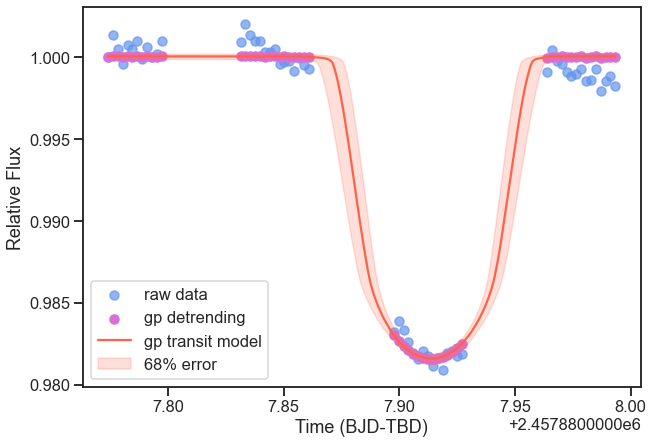

In [92]:
# let's plot the results of this fit 
plt.figure(figsize = (10,7))
t_final = np.linspace(times_start_430[0], times_start_430[-1], 1000)
# then the gp detrending
transit_plus_GP_model = gp_fit.lc.evaluate('STIS')
transit_model = gp_fit.lc.evaluate('STIS', evaluate_transit = True)
transit_model_resamp, error68_up, error68_down = gp_fit.lc.evaluate('STIS', evaluate_transit = True, t = t_final, return_err = True)

#gp_model = transit_plus_GP_model - transit_model

#transit_plus_GP_model = gp_fit.lc.evaluate('STIS', t = t_final, GPregressors = t_gp)
#transit_model = gp_fit.lc.model['STIS']['deterministic']
#gp_model = gp_fit.lc.model['STIS']['GP']
# there may be a small vertical offset between the two models because of the different normalizations - account for that
offset = 0
plt.scatter(times_start_430, (lc_430/lc_430[0]), label = "raw data", color = "cornflowerblue", alpha = 0.7)
plt.scatter(times_start_430, (lc_430/lc_430[0]) - (transit_plus_GP_model - transit_model) + offset,alpha=1, label = "gp detrending", color = "orchid")
#plt.plot(t_final, batman_model(t_final), color='black',zorder=10, label = "gp transit model (batman)")
plt.plot(np.linspace(times_start_430[0], times_start_430[-1], 1000), transit_model_resamp + offset, color='tomato',zorder=10, label = "gp transit model")
plt.fill_between(t_final, error68_up, error68_down, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Time (BJD-TBD)")
plt.show()

In [29]:
gp_fit_2 = white_light_fit(params_430, times_start_430_2, lc_430_2, lc_err_430_2, norm_jit_430_2, sys_method = "gp", juliet_name = "wasp-69_430_2", gp_kernel = "Matern")


  analysing data from juliet_fits/wasp-69_430_2/jomnest_.txt


In [30]:
# here are the results for that fit
for i in gp_fit_2.posteriors['posterior_samples'].keys():
    print(i, np.median(gp_fit_2.posteriors['posterior_samples'][i]))

unnamed 0.5783861719863146
loglike 320.5842006252376
t0_p1 2457176.1754836543
p_p1 0.1342075122046327
rho 1914.8142886299702
mflux_STIS 0.00042142429670205094
sigma_w_STIS 68.53552933948293
GP_sigma_STIS 425.2764466452616
GP_malpha0_STIS 0.552241974099182
GP_malpha1_STIS 0.31053411098811395
GP_malpha2_STIS 0.5095729540728793
GP_malpha3_STIS 1.0797389569916436
GP_malpha4_STIS 0.23937158483048115
GP_malpha5_STIS 0.5108280766428934
GP_malpha6_STIS 0.6202562556536035
GP_malpha7_STIS 0.27920074295468017
GP_malpha8_STIS 0.40184492605076977


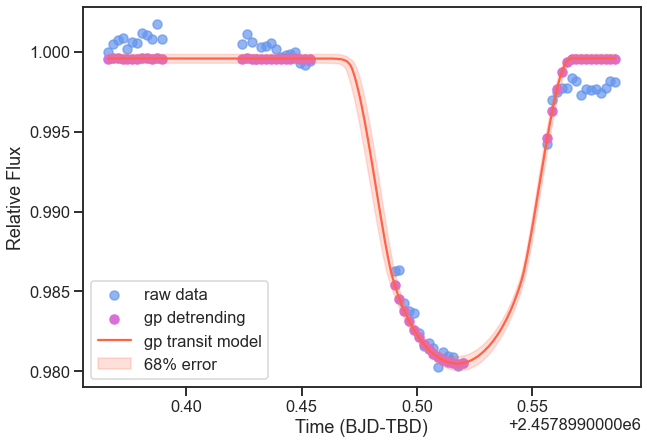

In [90]:
# let's plot the results of this fit 
plt.figure(figsize = (10,7))
t_final = np.linspace(times_start_430_2[0], times_start_430_2[-1], 1000)
# then the gp detrending
transit_plus_GP_model = gp_fit_2.lc.evaluate('STIS')
transit_model = gp_fit_2.lc.evaluate('STIS', evaluate_transit = True)
transit_model_resamp, error68_up, error68_down = gp_fit_2.lc.evaluate('STIS', evaluate_transit = True, t = t_final, return_err = True)

#gp_model = transit_plus_GP_model - transit_model

#transit_plus_GP_model = gp_fit.lc.evaluate('STIS', t = t_final, GPregressors = t_gp)
#transit_model = gp_fit.lc.model['STIS']['deterministic']
#gp_model = gp_fit.lc.model['STIS']['GP']
# there may be a small vertical offset between the two models because of the different normalizations - account for that
offset = 0
plt.scatter(times_start_430_2, (lc_430_2/lc_430_2[0]), color = "cornflowerblue", alpha = 0.7, label = "raw data")
plt.scatter(times_start_430_2, (lc_430_2/lc_430_2[0]) - (transit_plus_GP_model - transit_model) + offset,alpha=1, label = "gp detrending", color = "orchid")
#plt.plot(t_final, batman_model(t_final), color='black',zorder=10, label = "gp transit model (batman)")
plt.plot(t_final, transit_model_resamp + offset, color='tomato',zorder=10, label = "gp transit model")
plt.fill_between(t_final, error68_up, error68_down, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Time (BJD-TBD)")
plt.show()

In [31]:
gp_fit_750 = white_light_fit(params_750, times_start_750, lc_750, lc_err_750, norm_jit_750, sys_method = "gp", juliet_name = "wasp-69_750", gp_kernel = "Matern")


  analysing data from juliet_fits/wasp-69_750/jomnest_.txt


In [32]:
for i in gp_fit_750.posteriors['posterior_samples'].keys():
    print(i, np.median(gp_fit_750.posteriors['posterior_samples'][i]))

unnamed 0.3140422751833088
loglike 320.4058211694504
t0_p1 2457176.1746616573
p_p1 0.12337240372222806
rho 3296.713390322937
mflux_STIS 8.194698820605266e-05
sigma_w_STIS 60.35343868671411
GP_sigma_STIS 681.8081796165835
GP_malpha0_STIS 0.3625857989171241
GP_malpha1_STIS 0.05501130898269953
GP_malpha2_STIS 0.19170788801258656
GP_malpha3_STIS 0.3992704661868312
GP_malpha4_STIS 0.056416447358840424
GP_malpha5_STIS 0.20361262789247422
GP_malpha6_STIS 0.503163838985074
GP_malpha7_STIS 0.2796276664321176
GP_malpha8_STIS 0.28129157957526146


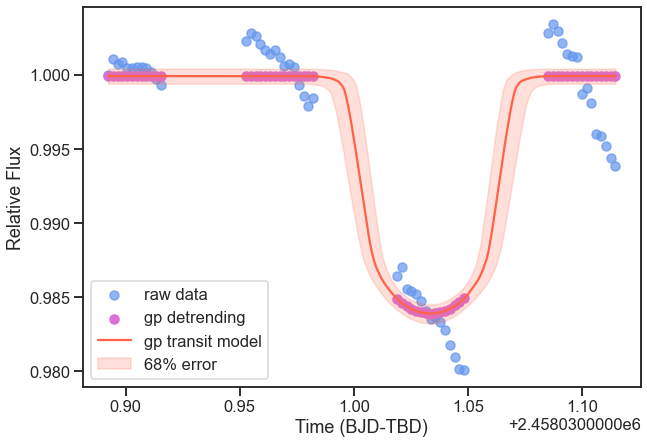

In [94]:
# let's plot the results of this fit 
plt.figure(figsize = (10,7))
t_final = np.linspace(times_start_750[0], times_start_750[-1], 1000)
# then the gp detrending
transit_plus_GP_model = gp_fit_750.lc.evaluate('STIS')
transit_model = gp_fit_750.lc.evaluate('STIS', evaluate_transit = True)
transit_model_resamp, error68_up, error68_down = gp_fit_750.lc.evaluate('STIS', evaluate_transit = True, t = t_final, return_err = True)

#gp_model = transit_plus_GP_model - transit_model

#transit_plus_GP_model = gp_fit.lc.evaluate('STIS', t = t_final, GPregressors = t_gp)
#transit_model = gp_fit.lc.model['STIS']['deterministic']
#gp_model = gp_fit.lc.model['STIS']['GP']
# there may be a small vertical offset between the two models because of the different normalizations - account for that
offset = 0
plt.scatter(times_start_750, (lc_750/lc_750[0]), color = "cornflowerblue", alpha = 0.7, label = "raw data")
plt.scatter(times_start_750, (lc_750/lc_750[0]) - (transit_plus_GP_model - transit_model) + offset,alpha=1, label = "gp detrending", color = "orchid")
#plt.plot(t_final, batman_model(t_final), color='black',zorder=10, label = "gp transit model (batman)")
plt.plot(t_final, transit_model_resamp + offset, color='tomato',zorder=10, label = "gp transit model")
plt.fill_between(t_final, error68_up, error68_down, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Time (BJD-TBD)")
plt.show()

In [33]:
# so now, instead, we fit multiple transits at the same time
# first, with a GP method
gp_fit_joint = joint_white_light_fit(params_430, times_start_430, lc_430, lc_err_430, norm_jit_430, times_start_430_2, lc_430_2, lc_err_430_2, norm_jit_430_2, sys_method = "gp", juliet_name = "wasp-69_430_joint", gp_kernel = "Matern", limb_darkening = "fixed")

  analysing data from juliet_fits/wasp-69_430_joint/jomnest_.txt


In [34]:
for i in gp_fit_joint.posteriors['posterior_samples'].keys():
    print(i, np.median(gp_fit_joint.posteriors['posterior_samples'][i]))

unnamed 0.7109493367042905
loglike 621.6890985319344
t0_p1 2457176.175067744
p_p1 0.13213988829007184
rho 2046.4643564966168
mflux_STIS1 0.00014040676104790347
sigma_w_STIS1 112.14110703875187
GP_sigma_STIS1 487.22506455336327
mflux_STIS2 0.0008641193102081541
sigma_w_STIS2 71.94104215025263
GP_sigma_STIS2 615.858182280142
GP_malpha0_STIS1 0.3754810126991791
GP_malpha1_STIS1 0.5013718305510779
GP_malpha2_STIS1 0.3402544951218096
GP_malpha3_STIS1 0.3626900666357452
GP_malpha4_STIS1 0.9432969430838235
GP_malpha5_STIS1 0.4540769640160246
GP_malpha6_STIS1 0.6969181111395022
GP_malpha7_STIS1 0.5856904708843058
GP_malpha8_STIS1 0.2281591478509233
GP_malpha0_STIS2 0.3456956908968066
GP_malpha1_STIS2 1.0378237091047282
GP_malpha2_STIS2 0.7370161346786822
GP_malpha3_STIS2 0.9646383446682505
GP_malpha4_STIS2 0.7918014197152802
GP_malpha5_STIS2 0.5867167839596001
GP_malpha6_STIS2 0.8331040262392653
GP_malpha7_STIS2 0.6360271553497187
GP_malpha8_STIS2 1.018394666334277


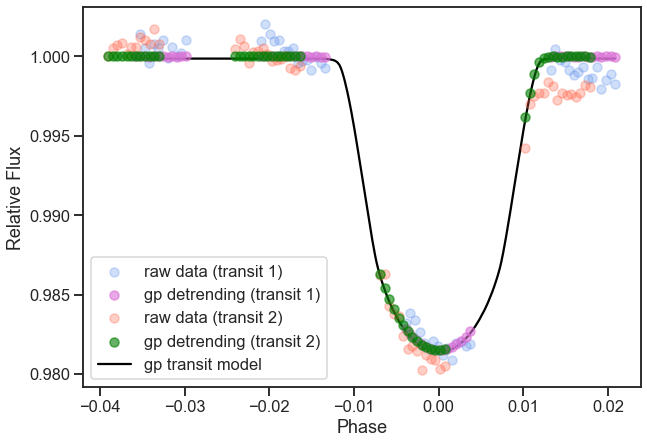

In [96]:
# then phased together

plt.figure(figsize = (10,7))

phases = juliet.utils.get_phases(times_start_430, 3.8681390, np.median(gp_fit_joint.posteriors['posterior_samples']["t0_p1"]))
phases_2 = juliet.utils.get_phases(times_start_430_2, 3.8681390, np.median(gp_fit_joint.posteriors['posterior_samples']["t0_p1"]))

transit_plus_GP_model1 = gp_fit_joint.lc.evaluate('STIS1')
transit_model1 = gp_fit_joint.lc.evaluate('STIS1', evaluate_transit = True)

gp_model1 = transit_plus_GP_model1 - transit_model1

transit_plus_GP_model2 = gp_fit_joint.lc.evaluate('STIS2')
transit_model2 = gp_fit_joint.lc.evaluate('STIS2', evaluate_transit = True)

gp_model2 = transit_plus_GP_model2 - transit_model2

offset1 = jitter_fit_lm[2][1][0] - transit_model1[0]

offset2 = jitter_fit_lm[2][1][0] - transit_model2[0]

t_final = np.linspace(times_start_430[0], times_start_430[-1], 1000)
transit_model2_resamp = gp_fit_joint.lc.evaluate('STIS1', evaluate_transit = True, t = t_final)
model_phases = juliet.utils.get_phases(t_final, 3.8681390, np.median(gp_fit_joint.posteriors['posterior_samples']["t0_p1"]))

#q1 = [v for (k,v) in gp_fit_joint.posteriors['posterior_samples'].items() if 'q1' in k][0]
#q2 = [v for (k,v) in gp_fit_joint.posteriors['posterior_samples'].items() if 'q2' in k][0]
#b_model = batman_model_j_gp(t_final, np.median(gp_fit_joint.posteriors['posterior_samples']["t0_p1"]), np.median(gp_fit_joint.posteriors['posterior_samples']["p_p1"]))
#model_phases = juliet.utils.get_phases(t_final, 1.274925, np.median(gp_fit_joint.posteriors['posterior_samples']["t0_p1"]))

plt.scatter(phases, (lc_430/lc_430[0]),alpha=0.3, label = "raw data (transit 1)", color = "cornflowerblue",)
plt.scatter(phases, (lc_430/lc_430[0]) - (transit_plus_GP_model1 - transit_model1) + offset1,alpha=0.6, label = "gp detrending (transit 1)", color = "orchid")
#plt.plot(t_final, batman_model(t_final), color='black',zorder=10, label = "gp transit model (batman)")
#plt.plot(phases, transit_model1 + offset1, color='cornflowerblue',zorder=10, label = "gp transit model (transit 1)")

plt.scatter(phases_2, (lc_430_2/lc_430_2[0]),alpha=0.3, label = "raw data (transit 2)", color = "tomato",)
plt.scatter(phases_2, (lc_430_2/lc_430_2[0]) - (transit_plus_GP_model2 - transit_model2) + offset2,alpha=0.6, label = "gp detrending (transit 2)", color = "green")

#plt.plot(t_final, batman_model(t_final), color='black',zorder=10, label = "gp transit model (batman)")
#plt.plot(phases_2, transit_model2 + offset2, color='tomato',zorder=10, label = "gp transit model (transit 2)")
plt.plot(model_phases, transit_model2_resamp, color = "black", label = "gp transit model", zorder = 0)

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Phase")
plt.show()


In [42]:
# then, some spectroscopic light curve fits
bins_joint, rp_joint, rp_e_joint = joint_spectroscopic_lightcurve_fit(params_430, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_jit_430,\
                                                                      times_start_430_2, spectra_430_2, norm_jit_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-69_430_spec",\
                                                                      mode = 'HST_STIS_G430L', plot = True)

1.8794504072420246 -0.9269600178103359
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_430_spec/wasp-69_430_spec_bin001/posteriors.pkl
1.1484075334576889 -0.26321665134981637
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_430_spec/wasp-69_430_spec_bin002/posteriors.pkl
0.6152285692116932 0.14791028319409114
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_430_spec/wasp-69_430_spec_bin003/posteriors.pkl
1.127994735173961 -0.2267663700702966
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_430_spec/wasp-69_430_spec_bin004/posteriors.pkl
1.099865220764904 -0.20496986549898705
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_430_spec/wasp-69_430_spec_bin005/posteriors.pkl
1.0986232384667824 -0.22196820392133845
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_430_spec/wasp-69_430_spec_bin006/posteriors.p

0.7306990747826282 0.07522963351863639
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin001/posteriors.pkl


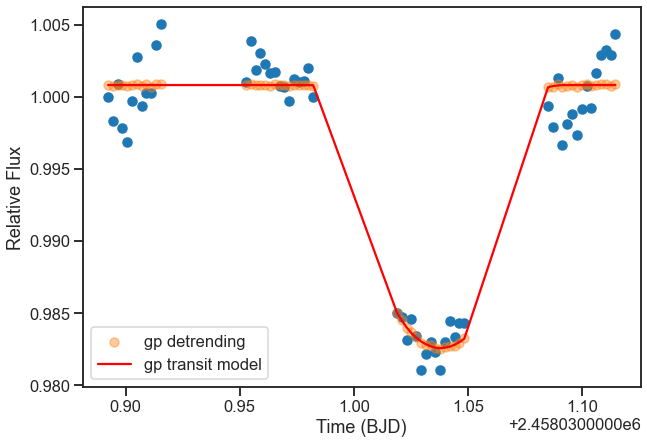

0.708844641013588 0.10008872363490141
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin002/posteriors.pkl


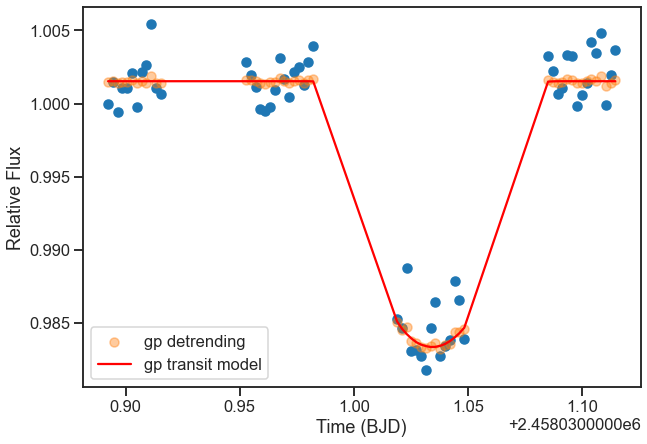

0.6820505468562427 0.11803674485347185
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin003/posteriors.pkl


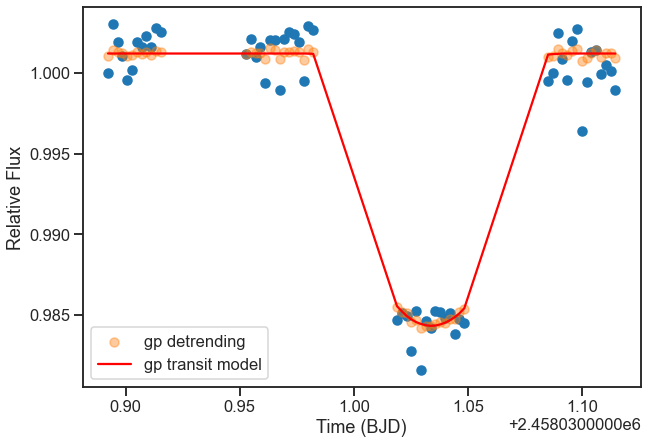

0.6692512054985373 0.12417296590452666
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin004/posteriors.pkl


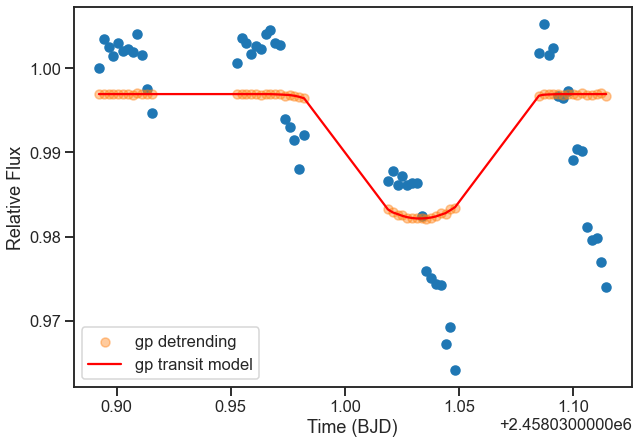

0.6554561898657265 0.12919841866574655
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin005/posteriors.pkl


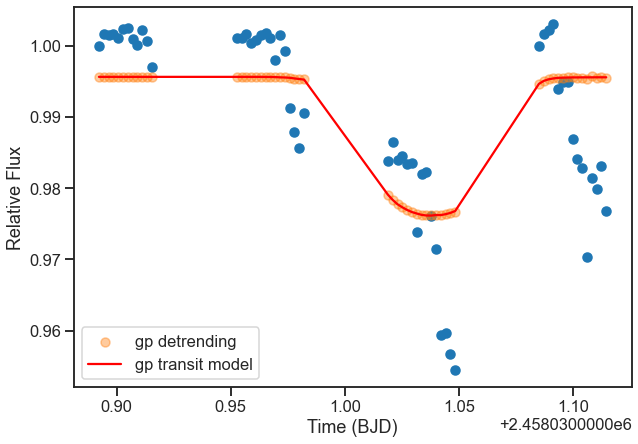

0.6312309978246081 0.14839289966443112
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin006/posteriors.pkl


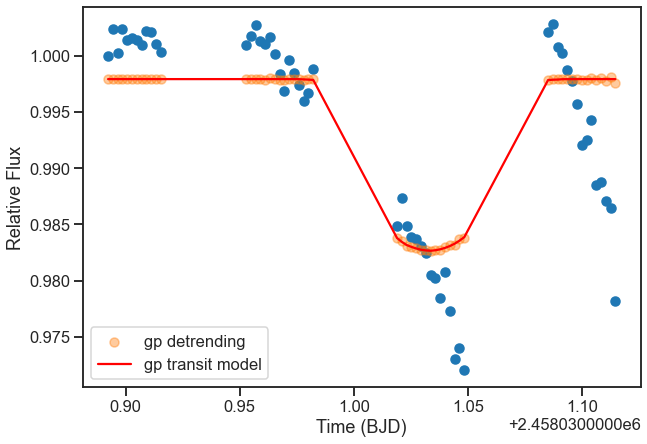

0.5979857349312492 0.15686614055675333
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin007/posteriors.pkl


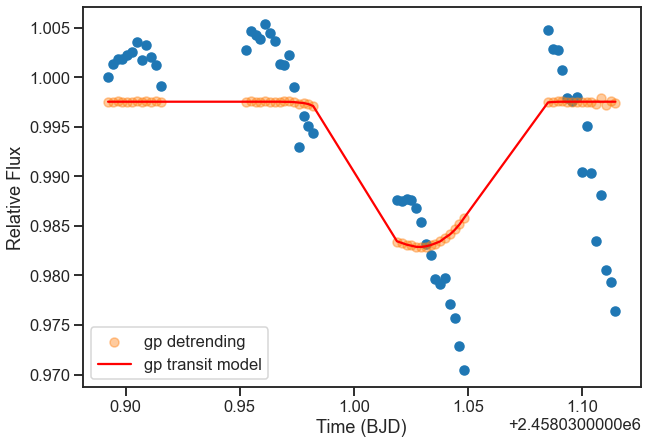

0.5882151982768898 0.16562793613960017
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin008/posteriors.pkl


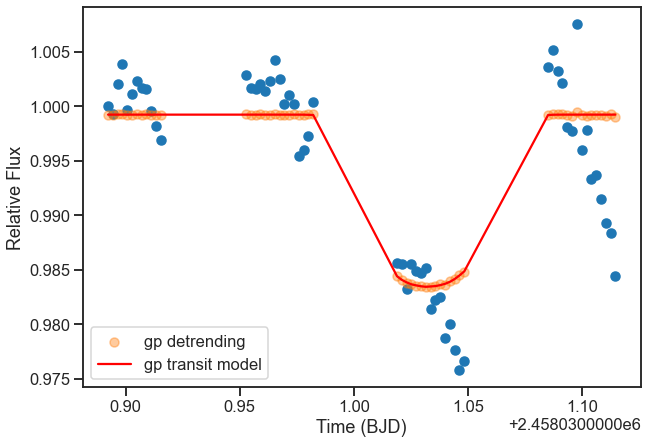

0.579583757330374 0.16940740958867892
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin009/posteriors.pkl


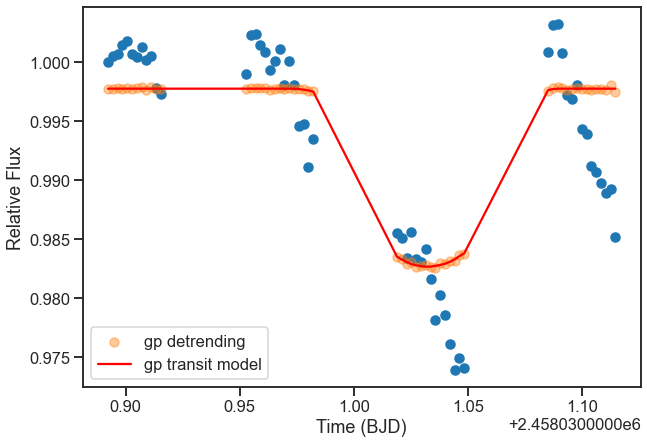

0.5720815156644875 0.17119269184340058
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin010/posteriors.pkl


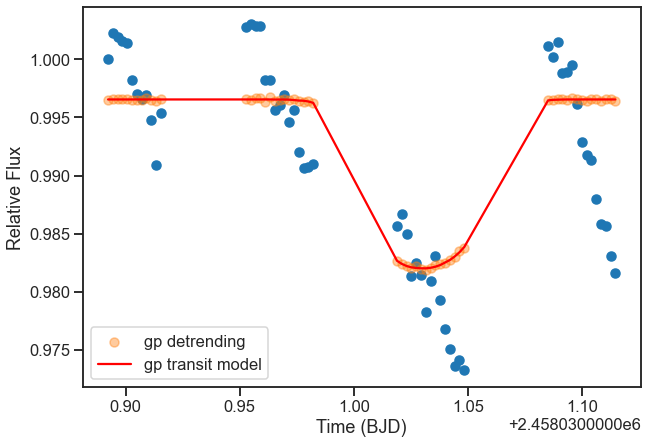

0.5501342409933203 0.18590249881834367
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin011/posteriors.pkl


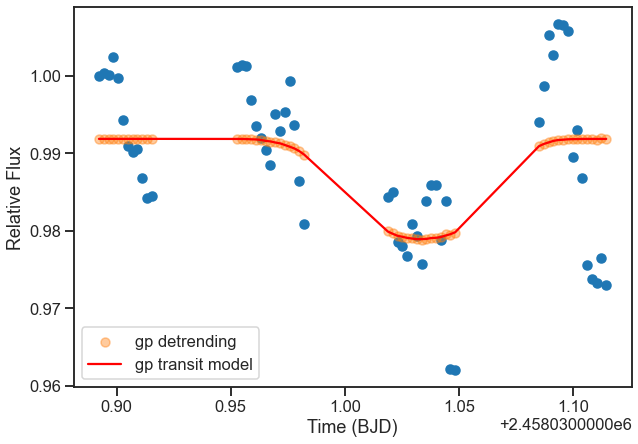

0.5408411582391012 0.19274430157958145
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin012/posteriors.pkl


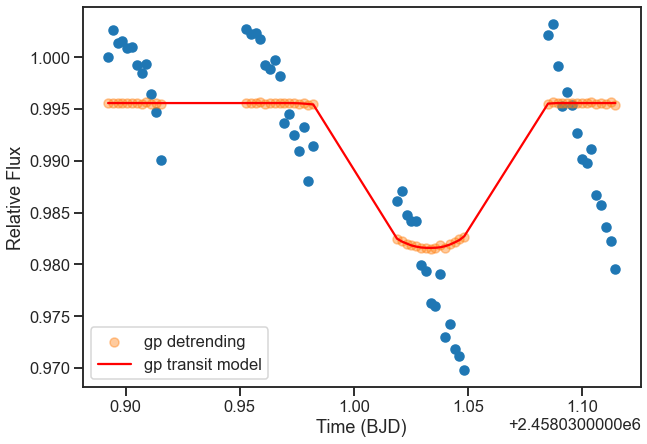

0.5398080960974195 0.1894602219173927
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin013/posteriors.pkl


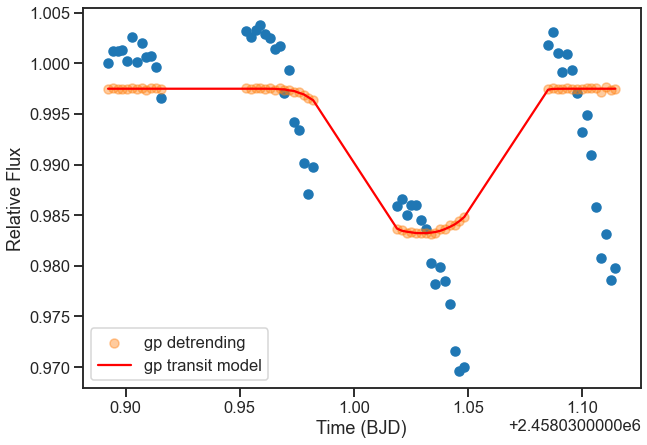

0.5302350092603724 0.19446493948308707
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin014/posteriors.pkl


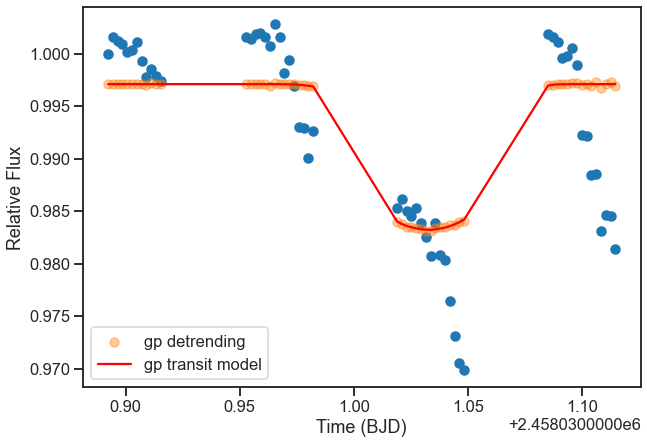

0.5204052854466212 0.19963771576909503
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin015/posteriors.pkl


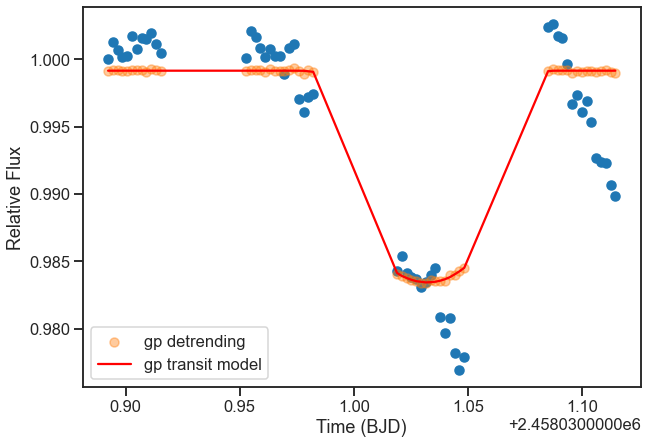

0.510130970320547 0.1993883171212487
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin016/posteriors.pkl


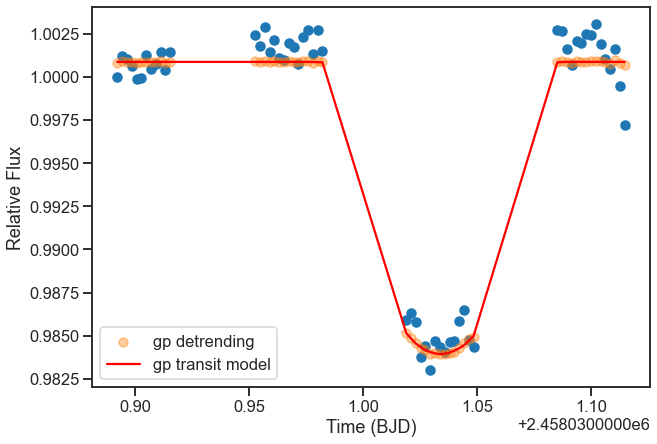

0.49140149997032423 0.20582883879164846
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin017/posteriors.pkl


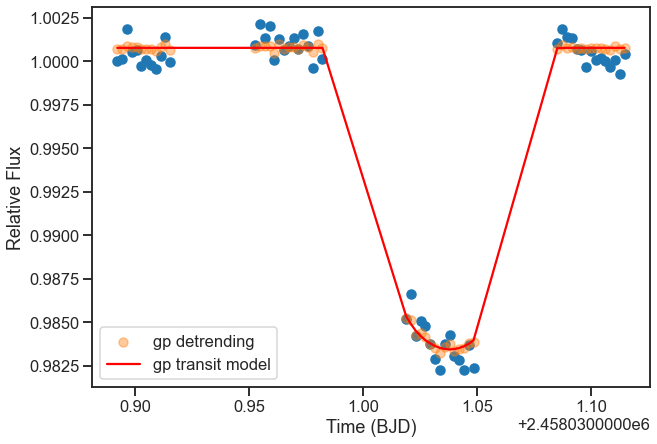

0.4948189515667873 0.2068750603005478
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin018/posteriors.pkl


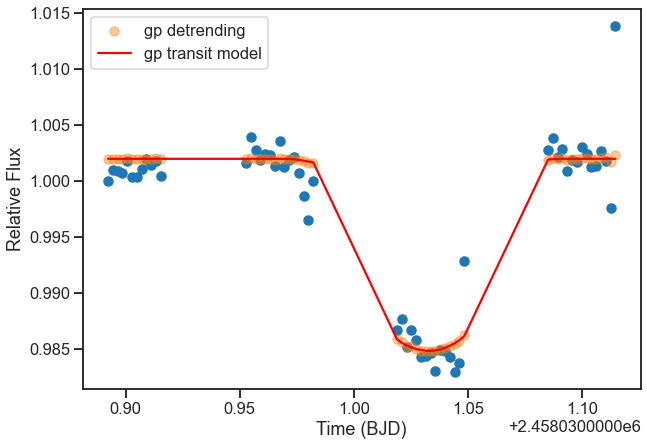

0.47672478261167767 0.2136139973236872
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin019/posteriors.pkl


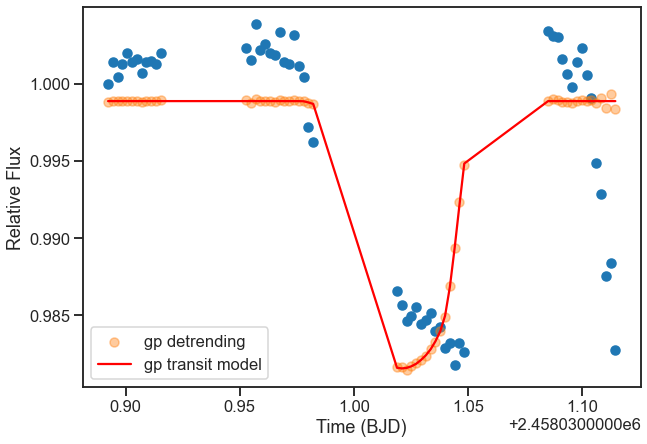

0.4513407972460743 0.21969388524267422
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin020/posteriors.pkl


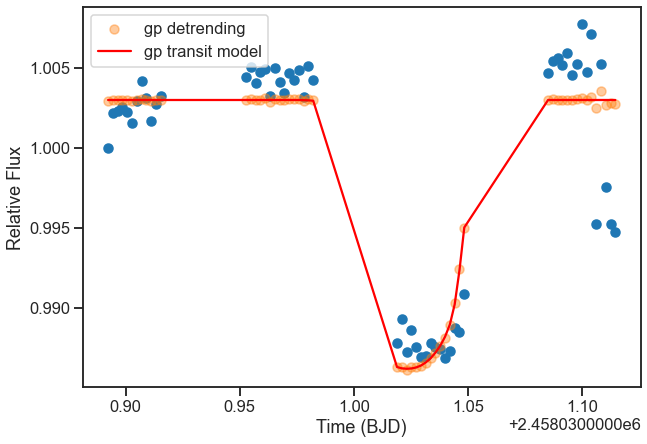

0.4494223856798653 0.2195179053930136
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin021/posteriors.pkl


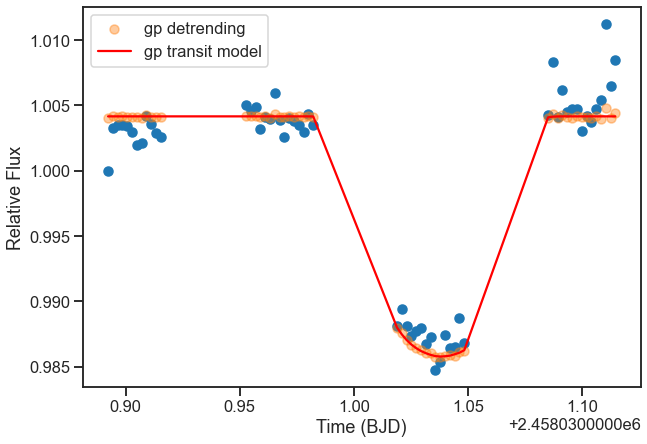

0.44362886872977736 0.22325847410075703
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin022/posteriors.pkl


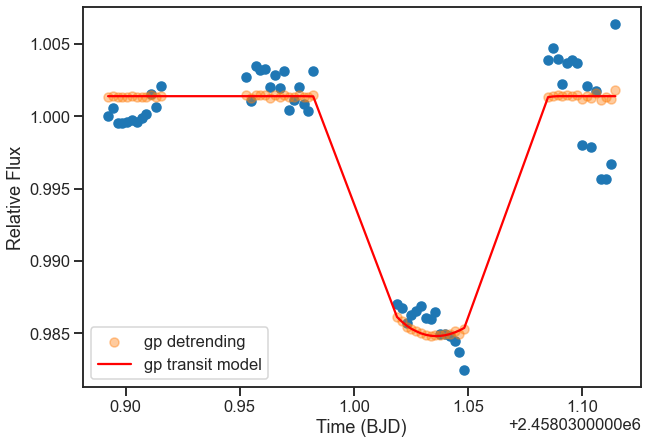

0.43765019699752544 0.22788136981476986
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin023/posteriors.pkl


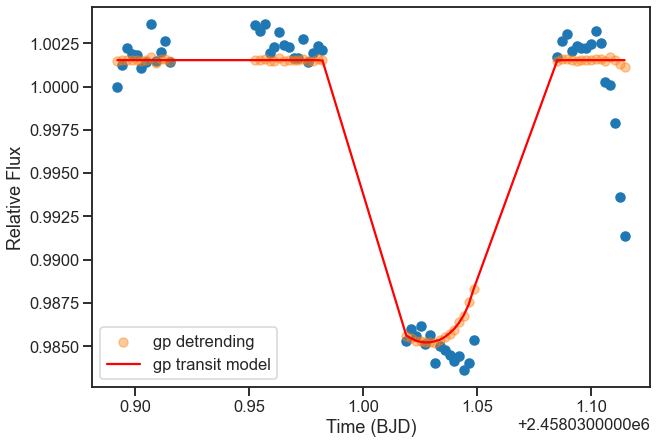

0.43105597223892156 0.22832152980647
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin024/posteriors.pkl


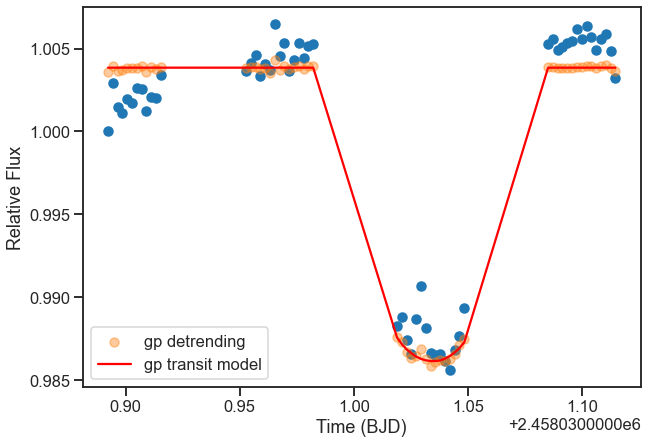

0.4145823098053883 0.23009537418464607
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin025/posteriors.pkl


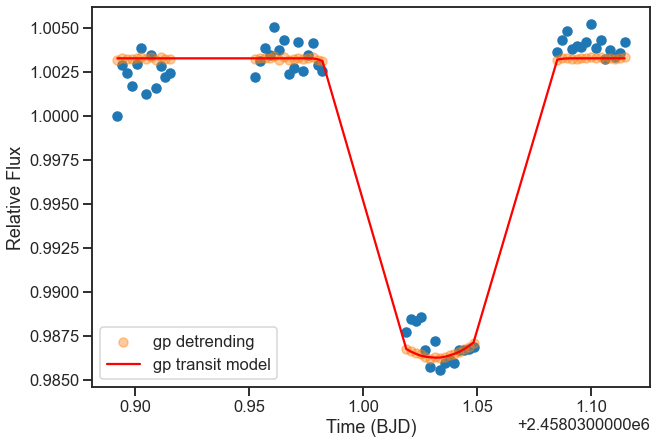

0.42031016766949997 0.2285778618395233
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin026/posteriors.pkl


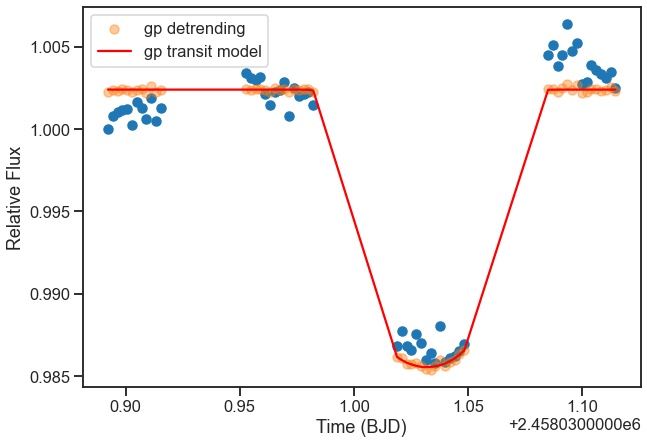

0.3911673441231709 0.22887443411242298
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin027/posteriors.pkl


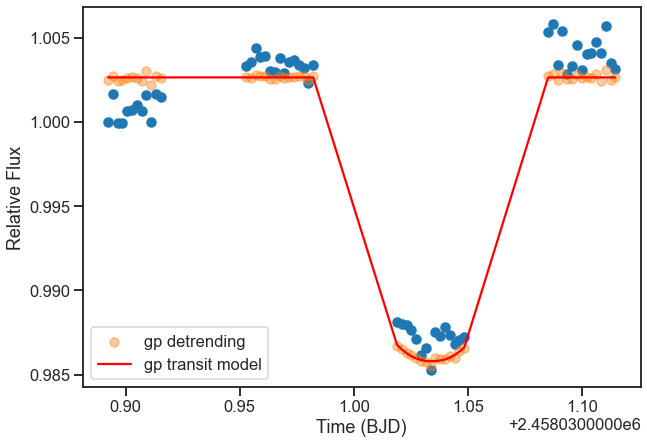

0.3789920478800847 0.239709681824678
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin028/posteriors.pkl


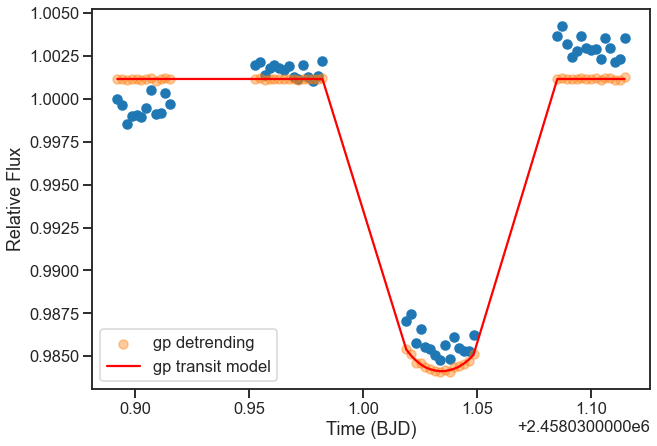

0.34017891221089774 0.2533376215323882
Detected multinest sampler output files --- extracting from juliet_fits/wasp-69_750_spec/wasp-69_750_spec_bin029/posteriors.pkl


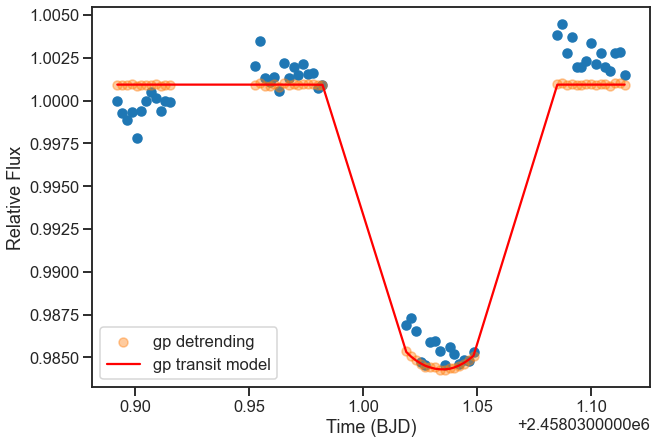

In [43]:
bins_750, rp_750, rp_e_750 = spectroscopic_lightcurve_fit(params_750, order_750["WAVELENGTH"], times_start_750, spectra_750, norm_jit_750,\
                                                       "wasp-69_g750_bins", sld, juliet_name = "wasp-69_750_spec", mode = 'HST_STIS_G750L', plot = True)

<ErrorbarContainer object of 3 artists>

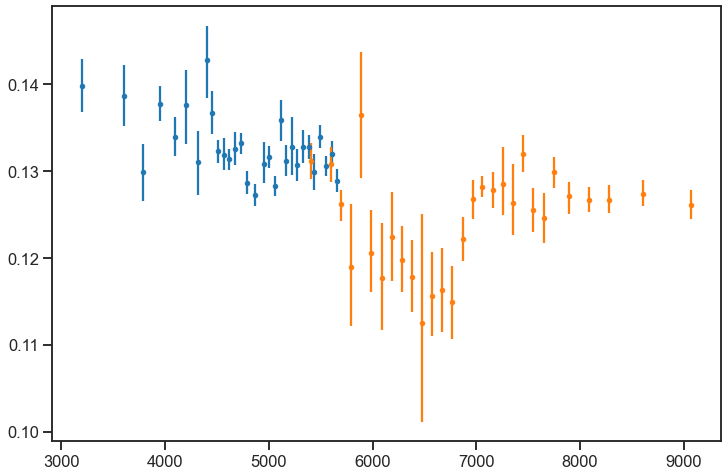

In [44]:
# this dataset doesn't look so great because of the bad 750 transit :[
%matplotlib inline
plt.figure(figsize = (12,8))
#plt.errorbar(bins_2, rp_2, yerr = np.array(rp_e_2).T, fmt = ".")
#plt.errorbar(bins_rg, rp_rg, yerr = np.array(rp_e_rg).T, fmt = ".")
plt.errorbar(bins_joint, rp_joint, yerr = np.array(rp_e_joint).T, fmt = ".")
plt.errorbar(bins_750, rp_750, yerr = np.array(rp_e_750).T, fmt = ".")

#plt.errorbar(bins_7, rp_7, yerr = np.array(rp_e_7).T, fmt = ".")
